# Semantic Segmentation

The goal of this laboratory is to study *Semantic Segmentation* which is an image classification approach based on deep learning techniques. It involves a supervised training that is suitable when large databases with associated groundtruth are available. 

As in the last laboratory, a specific set of images is provided. It corresponds to Seismic data collected using reflection seismology. The method requires a controlled seismic source of energy, such as compressed air or a seismic vibrator, and sensors record the reflection from rock interfaces within the subsurface. Reflection seismology is similar to X-ray, sonar and echolocation. The seismic image shows the boundaries between different rock types. In theory, the strength of reflection is directly proportional to the difference in the physical properties on either side of the interface. 

The oil prospection industry uses seismic images to understand which areas beneath the Earth’s surface may contain large amounts of oil and gas. Interestingly, the surfaces which contain oil and gas, also contain huge deposits of salt. It is important in petroleum geology because salt structures are impermeable and can lead to the formation of a stratigraphic trap or salt dome.
 

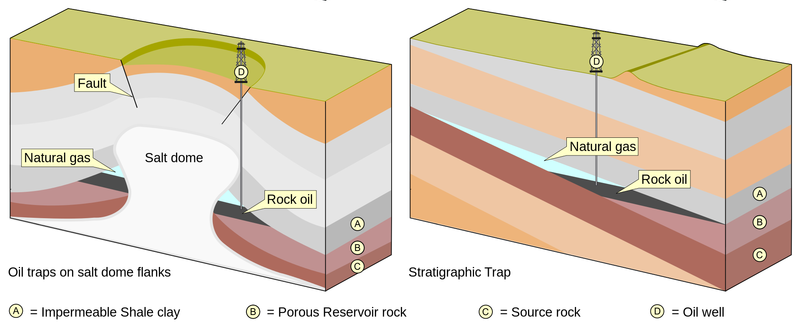

So, with the help of seismic technology, an important goal is to try to predict which areas in the surface of the Earth contain huge amount of salts. Unfortunately, seismic imaging requires expert human vision to exactly identify salt bodies. This leads to highly subjective and variable renderings. Moreover it could cause potentially dangerous situations and huge loss for the oil and gas company drillers if the human prediction is incorrect. So, in this laboratory, we will study whether semantic segmentation is able to build an algorithm that automatically and accurately identifies if a subsurface target is salt or not.

## 1 Lab configuration

Upload the "images.zip" and "masks.zip" files in the session storage (using the "Files" and "Upload" options on the upper left part of the browser). The Archives contains the image and mask material corresponding to this lab.

#### Initialization
Let us import the necessary library. Note that we will work with pytorch to implement the semantic segmentation algorithm. 

In [1]:
import os
#os.environ['CUDA_LAUNCH_BLOCKING'] = "1"
import math
import random
#import pandas as pd
import numpy as np
import matplotlib as mpl
mpl.rcParams['axes.grid'] = False
import matplotlib.pyplot as plt
plt.style.use("ggplot")
%matplotlib inline

from tqdm import tqdm, notebook
from skimage.io import imread, imshow, concatenate_images
from skimage.transform import resize
from skimage.morphology import label
from sklearn.model_selection import train_test_split

import torch
import torch.nn as nn
import torch.nn.functional as F
from torch.nn import init
from torch.utils.data import Dataset, DataLoader, TensorDataset
from torchvision import transforms, utils
from torchsummary import summary

Make sure that you are using the colaboratory GPU (and not the CPU)

In [2]:
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
print(device)

cuda:0


#### Load the dataset
Let us unzip the dataset of images. 

In [3]:
# Uncompress the database
!unzip -q masks.zip
!unzip -q images.zip

# Set some parameters
im_width = 128
im_height = 128
border = 5

Check that you indeed have access to the images. The number of images in the database should be 4.000. 

In [4]:
ids = next(os.walk("images"))[2] # list of names all images in the given path
print("No. of images in the dataset = ", len(ids))

No. of images in the dataset =  4000


Load the images in python variables.  

In [5]:
X = np.zeros((len(ids), im_height, im_width, 1), dtype=np.float32)
y = np.zeros((len(ids), im_height, im_width, 1), dtype=np.float32)

# tqdm is used to display the progress bar
for n, id_ in notebook.tqdm(enumerate(ids), total=len(ids)):
    # Load images
    x_img = imread("images/"+id_, as_gray=True)
    x_img = resize(x_img, (128, 128, 1), mode = 'constant', preserve_range = True)
    # Load masks
    mask = imread("masks/"+id_, as_gray=True)
    mask = resize(mask, (128, 128, 1), mode = 'constant', preserve_range = True)
    # Save images
    X[n] = x_img/255.0
    y[n] = mask/255.0

  0%|          | 0/4000 [00:00<?, ?it/s]

Let us split the database in training set (90%) and validation set (10%). 

In [6]:

# Split train and valid
X_train, X_valid, y_train, y_valid = train_test_split(X, y, test_size=0.1, random_state=42)

# Pytorch tensors
X_train_T = torch.Tensor(X_train).permute(0,3,1,2)
y_train_T = torch.squeeze(torch.Tensor(y_train).permute(0,3,1,2),1)
y_train_T = np.clip(y_train_T.long(),0,1)

X_valid_T = torch.Tensor(X_valid).permute(0,3,1,2)
y_valid_T = torch.squeeze(torch.Tensor(y_valid).permute(0,3,1,2),1)
y_valid_T = np.clip(y_valid_T.long(),0,1)

valid     = X_valid_T.numpy()
gt_valid  = y_valid_T.numpy()

Finally, let us visualize random images for the database as well as their associated groundtruth mask defining salt deposit. 

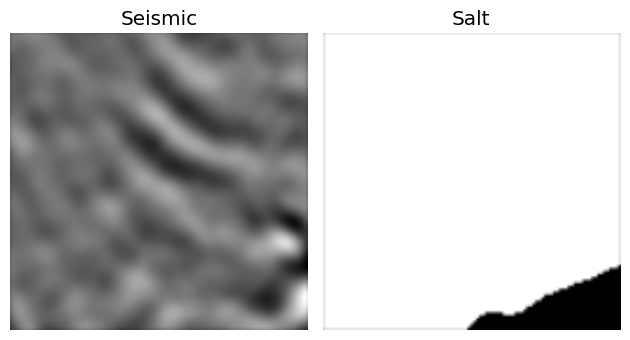

In [9]:
# Visualize random images along with their mask
ix = random.randint(0, len(X_train))
fig, (ax1, ax2) = plt.subplots(1, 2)

ax1.imshow(X_train[ix, ..., 0], cmap = 'gray', interpolation = 'bilinear')
ax1.set_title('Seismic')
ax1.axis('off')

ax2.imshow(y_train[ix].squeeze(), cmap = 'gray', interpolation = 'bilinear')
ax2.set_title('Salt')
ax2.axis('off')
fig.tight_layout()

As you can see, the identification of salt deposit is not a trivial task!

## 2 Analysis of upsampling
During the course, we have seen that one of the distinctive features of the semantic segmentation is the upsampling process. We have discussed several approaches that can be used in the context of CNN. Here we will experiment with two of them: *Upsampling* and *Transposed convolution*. 

<font color='purple'> Analyze the following code. An arbitrary tensor is created and then downsampled by a MaxPooling step. Then two upsampling strategies are proposed. In each case, some of the parameters are not defined. They are marked by ??? and your task is to specify the parameters so that the final tensors out1 and out2 have the same size as the original input tensor.  
</font>



In [10]:
# Create a random tensor 
input = torch.randn(1, 4, 128, 128)

# Downsampling
downsample = nn.MaxPool2d(kernel_size=2,stride=2)
h = downsample(input)

# Upsampling 1: Upsampling and convolution
upsample1 = nn.Upsample(scale_factor=2)
conv1 = nn.Conv2d(in_channels=4,out_channels=4,kernel_size=3,stride=1,padding=1,bias=True)
up1  = upsample1(h)
out1 = conv1(up1)

# Upsampling 2: Transposed convolution
upsample2 = nn.ConvTranspose2d(in_channels=4,out_channels=4,kernel_size=4,stride=2,padding=1,bias=True)
out2 = upsample2(h)

print('Original Tensor: ', input.shape, 'Downsampled tensor: ', h.shape)
print('Upsampling: ', up1.shape, 'Convolution: ',  out1.shape)
print('Transposed Convolution: ', out2.shape)

Original Tensor:  torch.Size([1, 4, 128, 128]) Downsampled tensor:  torch.Size([1, 4, 64, 64])
Upsampling:  torch.Size([1, 4, 128, 128]) Convolution:  torch.Size([1, 4, 128, 128])
Transposed Convolution:  torch.Size([1, 4, 128, 128])


### Upsampling and Convolution
In order to get some intuition on the first upsampling strategy, the one involving simple upsampling followed by a convolution, we are going to define a toy neural network example. 

The encoding part of the network, that is the part that decreases the resolution, involves a convolution (`Conv1`), a batch normalization (`BatchNorm1`), a ReLu (`ReLu`) and a max pooling (`Maxpool`).

The decoding part increases the resolution and is composed of an upsampling (`Upsample`), a convolution (`Conv2`), a batch normalization (`BatchNorm1`), a ReLu (`ReLu`) and a final convolution (`Conv_1x1`).

<font color='purple'> The `Conv2` layer is not fully specified. Finalize its specification by using the result of the previous section.   
</font>

In [11]:
class Simple_Net_UpSample(nn.Module):
    def __init__(self,input_ch=1,output_ch=1):
        super(Simple_Net_UpSample,self).__init__()
        self.ReLu       = nn.ReLU()
        self.Maxpool    = nn.MaxPool2d(kernel_size=2,stride=2)
        
        self.Conv1      = nn.Conv2d(in_channels=1,out_channels=4,kernel_size=3,stride=1,padding=1,bias=True)
        self.BatchNorm1 = nn.BatchNorm2d(num_features=4,track_running_stats=False)
        self.Upsample   = nn.Upsample(scale_factor=2)
        self.Conv2      = nn.Conv2d(in_channels=4,out_channels=4,kernel_size=3,stride=1,padding=1,bias=True)
        self.BatchNorm2 = nn.BatchNorm2d(num_features=4,track_running_stats=False)
        
        self.Conv_1x1   = nn.Conv2d(in_channels=4,out_channels=output_ch,kernel_size=1,stride=1,padding=0)

    def forward(self,x):
        # Encoding path
        x1 = self.Conv1(x)
        x1 = self.BatchNorm1(x1)
        x1 = self.ReLu(x1)
        x1 = self.Maxpool(x1)
        
        # Decoding path
        x2 = self.Upsample(x1)
        x2 = self.Conv2(x2)
        
        x3 = self.BatchNorm1(x2)
        x3 = self.ReLu(x3)
        x4 = self.Conv_1x1(x3)

        return x4

Let us create the pytorch model and load it in the GPU.

In [12]:
model = Simple_Net_UpSample(output_ch=2)
model.to(device)

Simple_Net_UpSample(
  (ReLu): ReLU()
  (Maxpool): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (Conv1): Conv2d(1, 4, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (BatchNorm1): BatchNorm2d(4, eps=1e-05, momentum=0.1, affine=True, track_running_stats=False)
  (Upsample): Upsample(scale_factor=2.0, mode='nearest')
  (Conv2): Conv2d(4, 4, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (BatchNorm2): BatchNorm2d(4, eps=1e-05, momentum=0.1, affine=True, track_running_stats=False)
  (Conv_1x1): Conv2d(4, 2, kernel_size=(1, 1), stride=(1, 1))
)

Let us check the composition of the model. 

In [13]:
summary(model, (1, 128, 128))

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1          [-1, 4, 128, 128]              40
       BatchNorm2d-2          [-1, 4, 128, 128]               8
              ReLU-3          [-1, 4, 128, 128]               0
         MaxPool2d-4            [-1, 4, 64, 64]               0
          Upsample-5          [-1, 4, 128, 128]               0
            Conv2d-6          [-1, 4, 128, 128]             148
       BatchNorm2d-7          [-1, 4, 128, 128]               8
              ReLU-8          [-1, 4, 128, 128]               0
            Conv2d-9          [-1, 2, 128, 128]              10
Total params: 214
Trainable params: 214
Non-trainable params: 0
----------------------------------------------------------------
Input size (MB): 0.06
Forward/backward pass size (MB): 3.88
Params size (MB): 0.00
Estimated Total Size (MB): 3.94
---------------------------------------------------

Finally, let us specify the training loss and optimizer.

In [14]:
loss_fn = nn.CrossEntropyLoss()
learning_rate = 1e-3 
optimizer = torch.optim.Adam(model.parameters(), lr=learning_rate)
best_valid_F1 = 0

As this model is extremely simple, it will not provide interesting results in terms of classification. We will any way run some training steps to check that everything is correct and the training actually allows to decrease the loss. It is also an opportunity to build a training loop that will be used later on more complex models. 

<font color='purple'> First analyze the code to understand the various steps. Then, run the training for 4 Epochs.   
</font>

In [15]:
NEpoch = 4;    # Number of Epoch
MBsize = 32;   # Minibatch size
model.train()

it = 0
# Loop on Epoch
for t in notebook.tqdm(range(NEpoch), desc='Epoch: '):
  model.train()
  idx = torch.randperm(y_train_T.size()[0])
  X_train_T = X_train_T[idx]
  y_train_T = y_train_T[idx]
  
  running_loss = 0
  running_accu = 0
  running_TP, running_P, running_T   = 0.0, 0.0, 0.0

  # Loop on minibatch
  for n in notebook.tqdm(range(math.floor(y_train_T.shape[0]/MBsize)), desc='MiniBatch: '):
    X_train_TMB = X_train_T[n*MBsize:(n+1)*MBsize,:,:,:]
    y_train_TMB = y_train_T[n*MBsize:(n+1)*MBsize,:,:]
    X_train_TMB, y_train_TMB = X_train_TMB.to(device), y_train_TMB.to(device)
    
    # Forward pass: compute predicted y by passing x to the model.
    y_pred_TMB = model(X_train_TMB)

    # Compute the loss.
    loss = loss_fn(y_pred_TMB, y_train_TMB)
    running_loss += loss
    
    # Compute accuracy, Precision and recall
    pred    = y_pred_TMB.cpu().detach().numpy()
    pred_th = (pred[:,1,:,:]>0.5).astype(float)
    gt      = y_train_TMB.cpu().numpy()
    running_accu += (pred_th == gt).sum()/gt.size
    running_TP += ((pred_th+gt)==2).sum()
    running_P  += pred_th.sum()
    running_T  += gt.sum()
    
    # Display the loss and F1
    if n % math.floor(y_train_T.shape[0]/MBsize/5) == 0: 
      precision = running_TP/(running_P+1e-6)
      recall    = running_TP/(running_T+1e-6)
      F1        = 2*precision*recall/(precision+recall+1e-6)
      print("Epoch{0:3d}/MiniBatch{1:4d}, MB.Loss {2:1.3f}, Av.Loss {3:1.3f}, Av.F1 {4:1.3f}"\
            .format(t+1, n+1, loss.item(), running_loss/(n+1), F1))

    # Clear the past gradients and compute new gradient
    optimizer.zero_grad()
    loss.backward()

    # Update of parameters
    optimizer.step()

Epoch:   0%|          | 0/4 [00:00<?, ?it/s]

MiniBatch:   0%|          | 0/112 [00:00<?, ?it/s]

Epoch  1/MiniBatch   1, MB.Loss 0.540, Av.Loss 0.540, Av.F1 0.000
Epoch  1/MiniBatch  23, MB.Loss 0.493, Av.Loss 0.566, Av.F1 0.000
Epoch  1/MiniBatch  45, MB.Loss 0.506, Av.Loss 0.562, Av.F1 0.000
Epoch  1/MiniBatch  67, MB.Loss 0.529, Av.Loss 0.558, Av.F1 0.000
Epoch  1/MiniBatch  89, MB.Loss 0.546, Av.Loss 0.557, Av.F1 0.000
Epoch  1/MiniBatch 111, MB.Loss 0.576, Av.Loss 0.555, Av.F1 0.000


MiniBatch:   0%|          | 0/112 [00:00<?, ?it/s]

Epoch  2/MiniBatch   1, MB.Loss 0.590, Av.Loss 0.590, Av.F1 0.000
Epoch  2/MiniBatch  23, MB.Loss 0.645, Av.Loss 0.551, Av.F1 0.000
Epoch  2/MiniBatch  45, MB.Loss 0.492, Av.Loss 0.541, Av.F1 0.000
Epoch  2/MiniBatch  67, MB.Loss 0.550, Av.Loss 0.538, Av.F1 0.000
Epoch  2/MiniBatch  89, MB.Loss 0.561, Av.Loss 0.537, Av.F1 0.000
Epoch  2/MiniBatch 111, MB.Loss 0.492, Av.Loss 0.531, Av.F1 0.000


MiniBatch:   0%|          | 0/112 [00:00<?, ?it/s]

Epoch  3/MiniBatch   1, MB.Loss 0.463, Av.Loss 0.463, Av.F1 0.000
Epoch  3/MiniBatch  23, MB.Loss 0.421, Av.Loss 0.513, Av.F1 0.000
Epoch  3/MiniBatch  45, MB.Loss 0.611, Av.Loss 0.526, Av.F1 0.000
Epoch  3/MiniBatch  67, MB.Loss 0.428, Av.Loss 0.526, Av.F1 0.000
Epoch  3/MiniBatch  89, MB.Loss 0.483, Av.Loss 0.517, Av.F1 0.000
Epoch  3/MiniBatch 111, MB.Loss 0.474, Av.Loss 0.514, Av.F1 0.000


MiniBatch:   0%|          | 0/112 [00:00<?, ?it/s]

Epoch  4/MiniBatch   1, MB.Loss 0.473, Av.Loss 0.473, Av.F1 0.000
Epoch  4/MiniBatch  23, MB.Loss 0.493, Av.Loss 0.496, Av.F1 0.000
Epoch  4/MiniBatch  45, MB.Loss 0.617, Av.Loss 0.515, Av.F1 0.000
Epoch  4/MiniBatch  67, MB.Loss 0.541, Av.Loss 0.509, Av.F1 0.000
Epoch  4/MiniBatch  89, MB.Loss 0.509, Av.Loss 0.507, Av.F1 0.000
Epoch  4/MiniBatch 111, MB.Loss 0.518, Av.Loss 0.502, Av.F1 0.000


You should see that the average loss (Av.Loss) is decreasing. The F1 value may be very low (even equal to 0) as the model is not really appropriate for the task.

Now we are going to have a look at the activations along the model. For that we need to define `hook` functions (In pytorch, `hooks` are functions that are executed when a call is executed) as well as a specific visualization function to handle activations with multiple channels. 

In [16]:
activation = {}
def get_activation(name):
    def hook(model, input, output):
        activation[name] = output.detach()
    return hook

def get_pre_activation(name):
    def hook(model, input):
        activation[name] = input
    return hook
  
def custom_viz(kernels, path=None, columns=8):  
  N = kernels.shape[0]
  C = kernels.shape[1]
  P = kernels.shape[2]
  Tot = N*C

  rows = Tot // columns 
  rows += Tot % columns
  pos  = range(1,Tot + 1)

  fig = plt.figure(1)
  #fig.tight_layout()
  k=0
  for i in range(kernels.shape[0]):
    for j in range(kernels.shape[1]):
      img = kernels[i][j]
      ax = fig.add_subplot(rows,columns,pos[k])
      ax.imshow(img, cmap='gray')
      plt.axis('off')
      k = k+1

  ax.figure.set_size_inches(4*columns*P/100, 4*rows*P/100)
  
  if path:
    plt.savefig(path)
    
  plt.show()

Then, we register the hooks on specific layers of the model. These hooks are executed after the function is called. Therefore, they allow us to see the activations at the output of the layer. The names appearing in the hooks refer to the layers of the summary used above (`summary(model, (1, 128, 128))`)

In [17]:
model.Conv1.register_forward_hook(get_activation('Conv2d-1'))
model.Maxpool.register_forward_hook(get_activation('MaxPool2d-4'))
model.Upsample.register_forward_hook(get_activation('Upsample-5'))
model.Conv2.register_forward_hook(get_activation('Conv2d-6'))
model.Conv_1x1.register_forward_hook(get_activation('Conv2d-8'))

Let us choose a specific input image of the training set and display it together with its corresponding mask. 

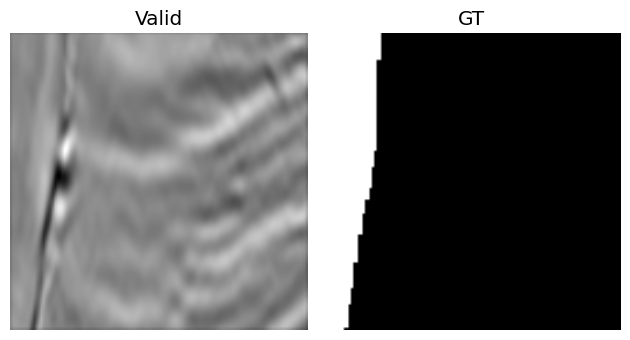

In [18]:
# Number of the training set image 
ima = 13
fig, (ax1, ax2) = plt.subplots(1, 2)
ax1.imshow(valid[ima,0,:,:], cmap = 'gray', interpolation = 'bilinear')
ax1.set_title('Valid')
ax1.axis('off')
ax2.imshow(gt_valid[ima,:,:], cmap = 'gray', interpolation = 'bilinear')
ax2.set_title('GT')
ax2.axis('off')
fig.tight_layout()

Finally, we run the image through the model and display the activations on all layers having a hook. 

Layer: Conv2d-1 torch.Size([1, 4, 128, 128])


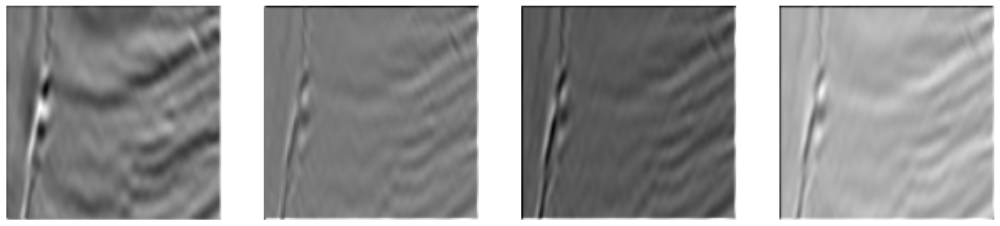

Layer: MaxPool2d-4 torch.Size([1, 4, 64, 64])


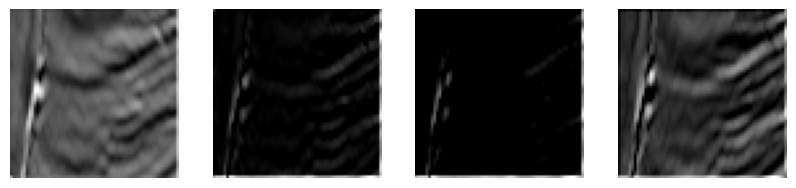

Layer: Upsample-5 torch.Size([1, 4, 128, 128])


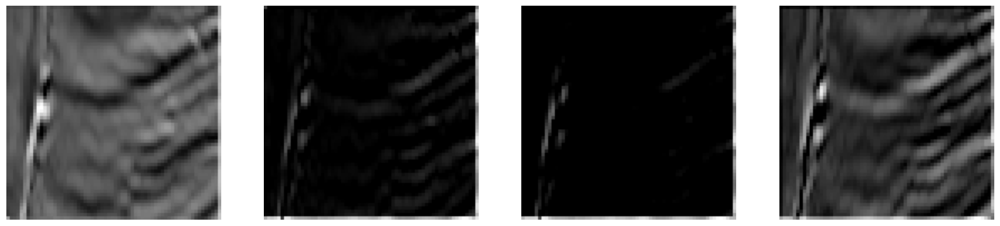

Layer: Conv2d-6 torch.Size([1, 4, 128, 128])


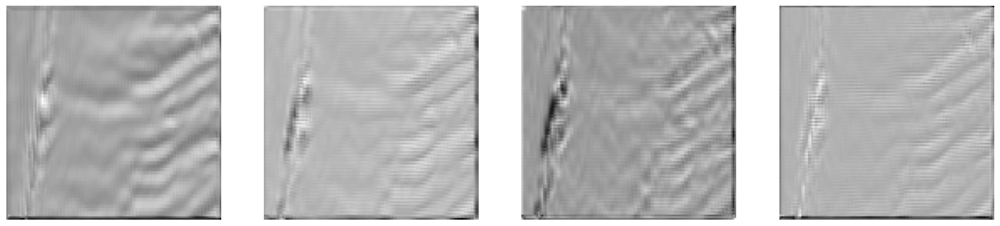

Layer: Conv2d-8 torch.Size([1, 2, 128, 128])


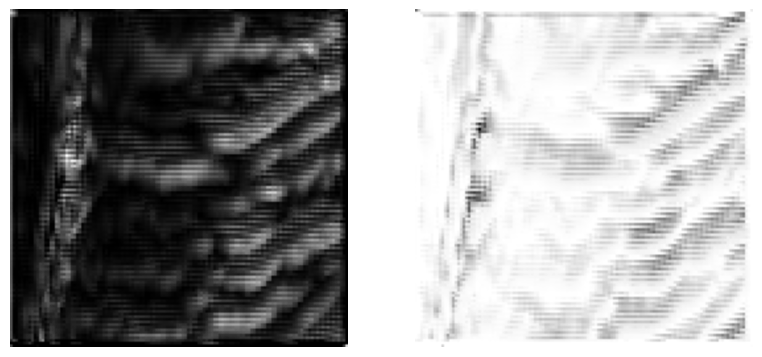

In [19]:
prediction = model(X_valid_T[ima:ima+1,:,:,:].to(device))

hook_name = 'Conv2d-1'
print('Layer: ' + hook_name, activation[hook_name].shape)
custom_viz(activation[hook_name].cpu().detach().clone(), hook_name + '.png',8)

hook_name = 'MaxPool2d-4'
print('Layer: ' + hook_name, activation[hook_name].shape)
custom_viz(activation[hook_name].cpu().detach().clone(), hook_name + '.png',8)

hook_name = 'Upsample-5'
print('Layer: ' + hook_name, activation[hook_name].shape)
custom_viz(activation[hook_name].cpu().detach().clone(), hook_name + '.png',8)

hook_name = 'Conv2d-6'
print('Layer: ' + hook_name, activation[hook_name].shape)
custom_viz(activation[hook_name].cpu().detach().clone(), hook_name + '.png',8)

hook_name = 'Conv2d-8'
print('Layer: ' + hook_name, activation[hook_name].shape)
custom_viz(activation[hook_name].cpu().detach().clone(), hook_name + '.png',8)

### Transposed Convolution
Now, we are going to make a similar experiment with a transposed convolution instead of Upsampling & Convolution. Let us define the model.

<font color='purple'> The `ConvTr1` layer is not fully specified. Finalize its specification by using the result of the work previously done.   
</font>

In [20]:
class Simple_Net_TrConv(nn.Module):
    def __init__(self,input_ch=1,output_ch=1):
        super(Simple_Net_TrConv,self).__init__()
        self.ReLu       = nn.ReLU()
        self.Maxpool    = nn.MaxPool2d(kernel_size=2,stride=2)
        
        self.Conv1      = nn.Conv2d(in_channels=1,out_channels=4,kernel_size=3,stride=1,padding=1,bias=True)
        self.BatchNorm1 = nn.BatchNorm2d(num_features=4,track_running_stats=False)
        self.ConvTr1    = nn.ConvTranspose2d(in_channels=4,out_channels=4,kernel_size=4,stride=2,padding=1,bias=True)
        self.BatchNorm2 = nn.BatchNorm2d(num_features=4,track_running_stats=False)
        
        self.Conv_1x1   = nn.Conv2d(in_channels=4,out_channels=output_ch,kernel_size=1,stride=1,padding=0)

    def forward(self,x):
        # Encoding path
        x1 = self.Conv1(x)
        x1 = self.BatchNorm1(x1)
        x1 = self.ReLu(x1)
        x1 = self.Maxpool(x1)
        
        # Decoding path
        x2 = self.ConvTr1(x1)
        
        x3 = self.BatchNorm1(x2)
        x3 = self.ReLu(x3)
        x4 = self.Conv_1x1(x3)

        return x4

Model definition

In [21]:
model = Simple_Net_TrConv(output_ch=2)
model.to(device)

Simple_Net_TrConv(
  (ReLu): ReLU()
  (Maxpool): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (Conv1): Conv2d(1, 4, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (BatchNorm1): BatchNorm2d(4, eps=1e-05, momentum=0.1, affine=True, track_running_stats=False)
  (ConvTr1): ConvTranspose2d(4, 4, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
  (BatchNorm2): BatchNorm2d(4, eps=1e-05, momentum=0.1, affine=True, track_running_stats=False)
  (Conv_1x1): Conv2d(4, 2, kernel_size=(1, 1), stride=(1, 1))
)

In [22]:
summary(model, (1, 128, 128))

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1          [-1, 4, 128, 128]              40
       BatchNorm2d-2          [-1, 4, 128, 128]               8
              ReLU-3          [-1, 4, 128, 128]               0
         MaxPool2d-4            [-1, 4, 64, 64]               0
   ConvTranspose2d-5          [-1, 4, 128, 128]             260
       BatchNorm2d-6          [-1, 4, 128, 128]               8
              ReLU-7          [-1, 4, 128, 128]               0
            Conv2d-8          [-1, 2, 128, 128]              10
Total params: 326
Trainable params: 326
Non-trainable params: 0
----------------------------------------------------------------
Input size (MB): 0.06
Forward/backward pass size (MB): 3.38
Params size (MB): 0.00
Estimated Total Size (MB): 3.44
----------------------------------------------------------------


In [23]:
loss_fn = nn.CrossEntropyLoss()
learning_rate = 1e-3 
optimizer = torch.optim.Adam(model.parameters(), lr=learning_rate)
best_valid_F1 = 0

In [24]:
NEpoch = 4;   # Number of Epoch
MBsize = 32;   # Minibatch size
model.train()

it = 0
# Loop on Epoch
for t in notebook.tqdm(range(NEpoch), desc='Epoch: '):
  model.train()
  idx = torch.randperm(y_train_T.size()[0])
  X_train_T = X_train_T[idx]
  y_train_T = y_train_T[idx]
  
  running_loss = 0
  running_accu = 0
  running_TP, running_P, running_T   = 0.0, 0.0, 0.0

  # Loop on Minibach
  for n in notebook.tqdm(range(math.floor(y_train_T.shape[0]/MBsize)), desc='MiniBatch: '):
    X_train_TMB = X_train_T[n*MBsize:(n+1)*MBsize,:,:,:]
    y_train_TMB = y_train_T[n*MBsize:(n+1)*MBsize,:,:]
    X_train_TMB, y_train_TMB = X_train_TMB.to(device), y_train_TMB.to(device)
    
    # Forward pass: compute predicted y by passing x to the model.
    y_pred_TMB = model(X_train_TMB)

    # Compute the loss.
    loss = loss_fn(y_pred_TMB, y_train_TMB)
    running_loss += loss
    
    # Compute accuracy, Precision and recall
    pred    = y_pred_TMB.cpu().detach().numpy()
    pred_th = (pred[:,1,:,:]>0.5).astype(float)
    gt      = y_train_TMB.cpu().numpy()
    running_accu += (pred_th == gt).sum()/gt.size
    running_TP += ((pred_th+gt)==2).sum()
    running_P  += pred_th.sum()
    running_T  += gt.sum()
    
    # Display the loss and F1
    if n % math.floor(y_train_T.shape[0]/MBsize/5) == 0: 
      precision = running_TP/(running_P+1e-6)
      recall    = running_TP/(running_T+1e-6)
      F1        = 2*precision*recall/(precision+recall+1e-6)
      print("Epoch{0:3d}/MiniBatch{1:4d}, MB.Loss {2:1.3f}, Av.Loss {3:1.3f}, Av.F1 {4:1.3f}"\
            .format(t+1, n+1, loss.item(), running_loss/(n+1), F1))

    # Clear the past gradients and compute new gradient
    optimizer.zero_grad()
    loss.backward()

    # Update of parameters
    optimizer.step()

Epoch:   0%|          | 0/4 [00:00<?, ?it/s]

MiniBatch:   0%|          | 0/112 [00:00<?, ?it/s]

Epoch  1/MiniBatch   1, MB.Loss 0.793, Av.Loss 0.793, Av.F1 0.035
Epoch  1/MiniBatch  23, MB.Loss 0.699, Av.Loss 0.735, Av.F1 0.011
Epoch  1/MiniBatch  45, MB.Loss 0.676, Av.Loss 0.707, Av.F1 0.006
Epoch  1/MiniBatch  67, MB.Loss 0.628, Av.Loss 0.685, Av.F1 0.004
Epoch  1/MiniBatch  89, MB.Loss 0.652, Av.Loss 0.672, Av.F1 0.003
Epoch  1/MiniBatch 111, MB.Loss 0.577, Av.Loss 0.659, Av.F1 0.003


MiniBatch:   0%|          | 0/112 [00:00<?, ?it/s]

Epoch  2/MiniBatch   1, MB.Loss 0.669, Av.Loss 0.669, Av.F1 0.000
Epoch  2/MiniBatch  23, MB.Loss 0.598, Av.Loss 0.590, Av.F1 0.000
Epoch  2/MiniBatch  45, MB.Loss 0.627, Av.Loss 0.586, Av.F1 0.000
Epoch  2/MiniBatch  67, MB.Loss 0.522, Av.Loss 0.581, Av.F1 0.000
Epoch  2/MiniBatch  89, MB.Loss 0.539, Av.Loss 0.575, Av.F1 0.000
Epoch  2/MiniBatch 111, MB.Loss 0.543, Av.Loss 0.573, Av.F1 0.000


MiniBatch:   0%|          | 0/112 [00:00<?, ?it/s]

Epoch  3/MiniBatch   1, MB.Loss 0.497, Av.Loss 0.497, Av.F1 0.000
Epoch  3/MiniBatch  23, MB.Loss 0.506, Av.Loss 0.551, Av.F1 0.000
Epoch  3/MiniBatch  45, MB.Loss 0.508, Av.Loss 0.547, Av.F1 0.000
Epoch  3/MiniBatch  67, MB.Loss 0.540, Av.Loss 0.543, Av.F1 0.000
Epoch  3/MiniBatch  89, MB.Loss 0.519, Av.Loss 0.545, Av.F1 0.000
Epoch  3/MiniBatch 111, MB.Loss 0.571, Av.Loss 0.543, Av.F1 0.000


MiniBatch:   0%|          | 0/112 [00:00<?, ?it/s]

Epoch  4/MiniBatch   1, MB.Loss 0.583, Av.Loss 0.583, Av.F1 0.000
Epoch  4/MiniBatch  23, MB.Loss 0.467, Av.Loss 0.552, Av.F1 0.000
Epoch  4/MiniBatch  45, MB.Loss 0.552, Av.Loss 0.542, Av.F1 0.000
Epoch  4/MiniBatch  67, MB.Loss 0.559, Av.Loss 0.532, Av.F1 0.000
Epoch  4/MiniBatch  89, MB.Loss 0.533, Av.Loss 0.529, Av.F1 0.000
Epoch  4/MiniBatch 111, MB.Loss 0.559, Av.Loss 0.529, Av.F1 0.000


Let us register the `Hooks` on various layers. 

In [25]:
model.Conv1.register_forward_hook(get_activation('Conv2d-1'))
model.Maxpool.register_forward_hook(get_activation('MaxPool2d-4'))
model.ConvTr1.register_forward_hook(get_activation('ConvTranspose2d-5'))
model.Conv_1x1.register_forward_hook(get_activation('Conv2d-8'))

Finally, let us visualize the activations. 

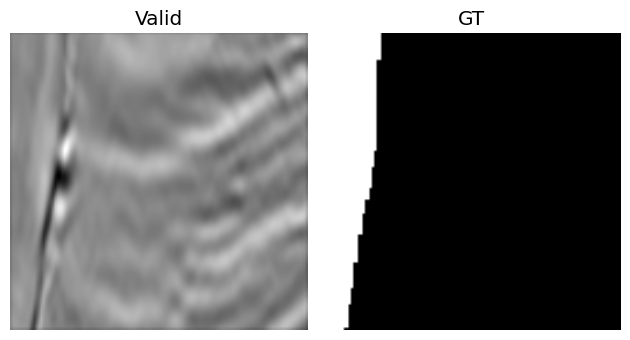

In [26]:
ima = 13
fig, (ax1, ax2) = plt.subplots(1, 2)
ax1.imshow(valid[ima,0,:,:], cmap = 'gray', interpolation = 'bilinear')
ax1.set_title('Valid')
ax1.axis('off')
ax2.imshow(gt_valid[ima,:,:], cmap = 'gray', interpolation = 'bilinear')
ax2.set_title('GT')
ax2.axis('off')
fig.tight_layout()

Conv2d-1 torch.Size([1, 4, 128, 128])


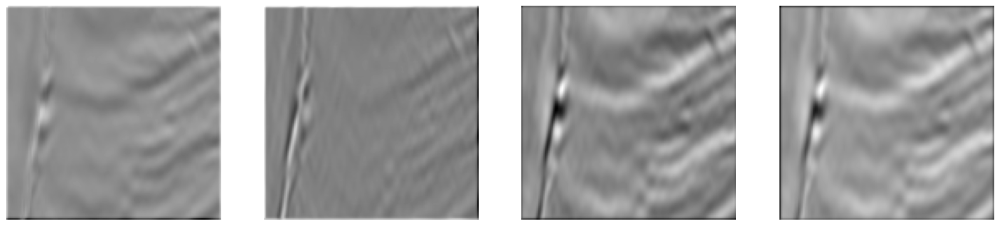

MaxPool2d-4 torch.Size([1, 4, 64, 64])


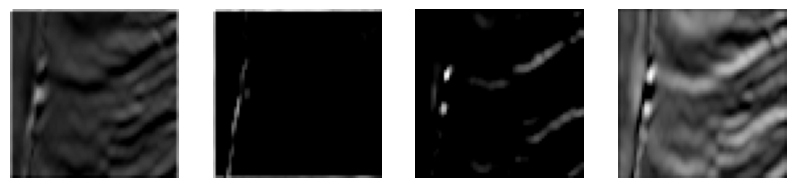

ConvTranspose2d-5 torch.Size([1, 4, 128, 128])


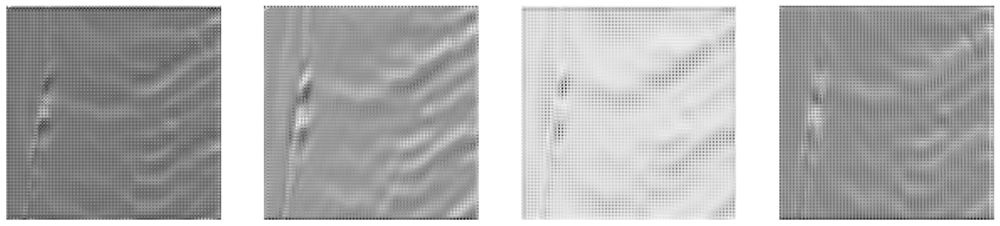

Conv2d-8 torch.Size([1, 2, 128, 128])


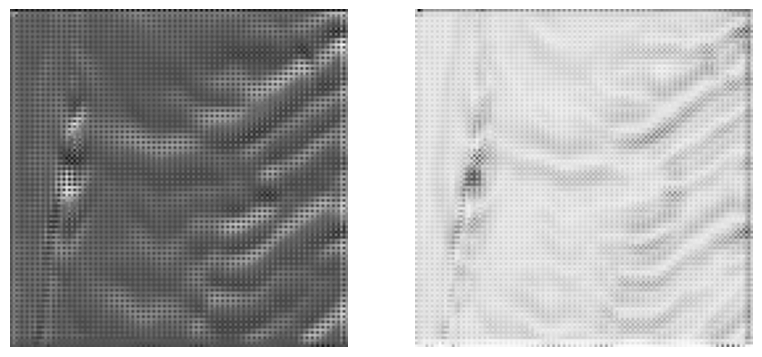

In [28]:
prediction = model(X_valid_T[ima:ima+1,:,:,:].to(device))

hook_name = 'Conv2d-1'
print(hook_name, activation[hook_name].shape)
custom_viz(activation[hook_name].cpu().detach().clone(), hook_name + '.png',8)

hook_name = 'MaxPool2d-4'
print(hook_name, activation[hook_name].shape)
custom_viz(activation[hook_name].cpu().detach().clone(), hook_name + '.png',8)

hook_name = 'ConvTranspose2d-5'
print(hook_name, activation[hook_name].shape)
custom_viz(activation[hook_name].cpu().detach().clone(), hook_name + '.png',8)

hook_name = 'Conv2d-8'
print(hook_name, activation[hook_name].shape)
custom_viz(activation[hook_name].cpu().detach().clone(), hook_name + '.png',8)

<font color='purple'> It is difficult to judge the quality of the resulting upsampling processes as the models are very simple, not appropriate for the task and severely undertrained. Anyway, what can be said about their differences (Hint: Take also into consideration the information provided by the `summary`): </font>

---
<font color='red'>Answer: Podem veure la diferència clara entre els dos mètodes, en el que s'ha fet upsampling i en el que no. En el segon mètode veiem clarament pixels amb un color que no tocaria, degut a que no hem fet upsmpling abans d'aplicar la convolució transposada. La imatge és veu més nítida amb el primer mètode.

</font> 

## 3 Network inspired by the *UNet*
In this section, we are going to create two networks inspired by the UNet model. This model is based on an encoder / decoder architecture. 
 

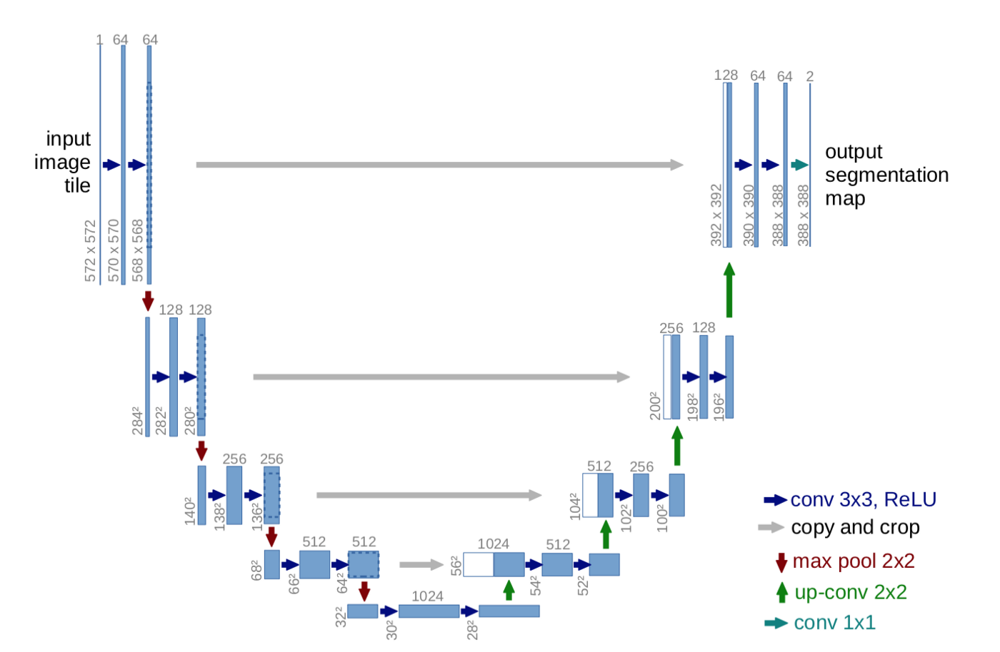

The encoder is composed of blocks involving two Convolution layers with 3x3 filters and two ReLu layers. For our model, we will also add two Batch Normalization Layers after each convolution. This part of the model architecture is represented by the following 'conv_block' class. 

In [30]:
class conv_block(nn.Module):
    def __init__(self,ch_in,ch_out):
        super(conv_block,self).__init__()
        self.conv = nn.Sequential(
            nn.Conv2d(ch_in, ch_out, kernel_size=3,stride=1,padding=1,bias=True),
            nn.BatchNorm2d(ch_out,track_running_stats=False),
            nn.ReLU(inplace=True),
            nn.Conv2d(ch_out, ch_out, kernel_size=3,stride=1,padding=1,bias=True),
            nn.BatchNorm2d(ch_out,track_running_stats=False),
            nn.ReLU(inplace=True)
        )

    def forward(self,x):
        x = self.conv(x)
        return x


For the decoder part, we will create two set of blocks with the same functionality. The first one (`up_conv`) is composed of an upsampling layer and a convolution. We also add a Batch Normalization and a ReLu layer. 

In [31]:
class up_conv(nn.Module):
    def __init__(self,ch_in,ch_out):
        super(up_conv,self).__init__()
        self.up = nn.Sequential(
            nn.Upsample(scale_factor=2),
            nn.Conv2d(ch_in,ch_out,kernel_size=3,stride=1,padding=1,bias=True),
		        nn.BatchNorm2d(ch_out,track_running_stats=False),
			      nn.ReLU(inplace=True)
        )

    def forward(self,x):
        x = self.up(x)
        return x

A similar block is created by substituting the upsampling and convolution by a transposed convolution. This block is called `up_Tr_conv`.

In [32]:
class up_Tr_conv(nn.Module):
    def __init__(self,ch_in,ch_out):
        super(up_Tr_conv,self).__init__()
        self.up = nn.Sequential(
            nn.ConvTranspose2d(ch_in,ch_out,kernel_size=4,stride=2,padding=1,bias=True),
		        nn.BatchNorm2d(ch_out,track_running_stats=False),
			      nn.ReLU(inplace=True)
        )

    def forward(self,x):
        x = self.up(x)
        return x

As a result, two different models are created. The first one is called `U_Net_Up` and involves the Upsampling and Convolution layers. Note that the number of channels is significantly smaller than that of the original UNet model. Also we have introduced the concatenation layers that merge encoder activations with decoder activations (see the `torch.cat((.,.),dim=1)`). 

In [33]:
class U_Net_Up(nn.Module):
    def __init__(self,img_ch=1,output_ch=1):
        super(U_Net_Up,self).__init__()
        
        self.Maxpool = nn.MaxPool2d(kernel_size=2,stride=2)

        self.Conv1 = conv_block(ch_in=img_ch,ch_out=16)
        self.Conv2 = conv_block(ch_in=16,ch_out=32)
        self.Conv3 = conv_block(ch_in=32,ch_out=64)
        self.Conv4 = conv_block(ch_in=64,ch_out=128)
        self.Conv5 = conv_block(ch_in=128,ch_out=256)

        self.Up5 = up_conv(ch_in=256,ch_out=128)
        self.Up_conv5 = conv_block(ch_in=256, ch_out=128)

        self.Up4 = up_conv(ch_in=128,ch_out=64)
        self.Up_conv4 = conv_block(ch_in=128, ch_out=64)
        
        self.Up3 = up_conv(ch_in=64,ch_out=32)
        self.Up_conv3 = conv_block(ch_in=64, ch_out=32)
        
        self.Up2 = up_conv(ch_in=32,ch_out=16)
        self.Up_conv2 = conv_block(ch_in=32, ch_out=16)

        self.Conv_1x1 = nn.Conv2d(16,output_ch,kernel_size=1,stride=1,padding=0)


    def forward(self,x):
        # encoding path
        x1 = self.Conv1(x)

        x2 = self.Maxpool(x1)
        x2 = self.Conv2(x2)
        
        x3 = self.Maxpool(x2)
        x3 = self.Conv3(x3)

        x4 = self.Maxpool(x3)
        x4 = self.Conv4(x4)

        x5 = self.Maxpool(x4)
        x5 = self.Conv5(x5)

        # decoding + concat path
        d5 = self.Up5(x5)
        d5 = torch.cat((x4,d5),dim=1)
        
        d5 = self.Up_conv5(d5)
        
        d4 = self.Up4(d5)
        d4 = torch.cat((x3,d4),dim=1)
        d4 = self.Up_conv4(d4)

        d3 = self.Up3(d4)
        d3 = torch.cat((x2,d3),dim=1)
        d3 = self.Up_conv3(d3)

        d2 = self.Up2(d3)
        d2 = torch.cat((x1,d2),dim=1)
        d2 = self.Up_conv2(d2)

        d1 = self.Conv_1x1(d2)

        return d1


The second model: `U_Net_Tr` is the same as the previous one but it includes the Transposed convolution.  

In [34]:
class U_Net_Tr(nn.Module):
    def __init__(self,img_ch=1,output_ch=1):
        super(U_Net_Tr,self).__init__()
        
        self.Maxpool = nn.MaxPool2d(kernel_size=2,stride=2)

        self.Conv1 = conv_block(ch_in=img_ch,ch_out=16)
        self.Conv2 = conv_block(ch_in=16,ch_out=32)
        self.Conv3 = conv_block(ch_in=32,ch_out=64)
        self.Conv4 = conv_block(ch_in=64,ch_out=128)
        self.Conv5 = conv_block(ch_in=128,ch_out=256)

        self.Up5 = up_Tr_conv(ch_in=256,ch_out=128)
        self.Up_conv5 = conv_block(ch_in=256, ch_out=128)

        self.Up4 = up_Tr_conv(ch_in=128,ch_out=64)
        self.Up_conv4 = conv_block(ch_in=128, ch_out=64)
        
        self.Up3 = up_Tr_conv(ch_in=64,ch_out=32)
        self.Up_conv3 = conv_block(ch_in=64, ch_out=32)
        
        self.Up2 = up_Tr_conv(ch_in=32,ch_out=16)
        self.Up_conv2 = conv_block(ch_in=32, ch_out=16)

        self.Conv_1x1 = nn.Conv2d(16,output_ch,kernel_size=1,stride=1,padding=0)


    def forward(self,x):
        # encoding path
        x1 = self.Conv1(x)

        x2 = self.Maxpool(x1)
        x2 = self.Conv2(x2)
        
        x3 = self.Maxpool(x2)
        x3 = self.Conv3(x3)

        x4 = self.Maxpool(x3)
        x4 = self.Conv4(x4)

        x5 = self.Maxpool(x4)
        x5 = self.Conv5(x5)

        # decoding + concat path
        d5 = self.Up5(x5)
        d5 = torch.cat((x4,d5),dim=1)
        
        d5 = self.Up_conv5(d5)
        
        d4 = self.Up4(d5)
        d4 = torch.cat((x3,d4),dim=1)
        d4 = self.Up_conv4(d4)

        d3 = self.Up3(d4)
        d3 = torch.cat((x2,d3),dim=1)
        d3 = self.Up_conv3(d3)

        d2 = self.Up2(d3)
        d2 = torch.cat((x1,d2),dim=1)
        d2 = self.Up_conv2(d2)

        d1 = self.Conv_1x1(d2)

        return d1


In [70]:
class U_Net_MOD(nn.Module):
    def __init__(self,img_ch=1,output_ch=1):
        super(U_Net_MOD,self).__init__()
        
        self.Maxpool = nn.MaxPool2d(kernel_size=2,stride=2)

        self.Conv1 = conv_block(ch_in=img_ch,ch_out=16)
        self.Conv2 = conv_block(ch_in=16,ch_out=32)
        self.Conv3 = conv_block(ch_in=32,ch_out=64)
        self.Conv4 = conv_block(ch_in=64,ch_out=128)
        self.Conv5 = conv_block(ch_in=128,ch_out=256)
        self.Conv6 = conv_block(ch_in=256,ch_out=512)

        self.Up6 = up_Tr_conv(ch_in=512,ch_out=256)
        self.Up_conv6 = conv_block(ch_in=512, ch_out=256)

        self.Up5 = up_Tr_conv(ch_in=256,ch_out=128)
        self.Up_conv5 = conv_block(ch_in=256, ch_out=128)

        self.Up4 = up_Tr_conv(ch_in=128,ch_out=64)
        self.Up_conv4 = conv_block(ch_in=128, ch_out=64)
        
        self.Up3 = up_Tr_conv(ch_in=64,ch_out=32)
        self.Up_conv3 = conv_block(ch_in=64, ch_out=32)
        
        self.Up2 = up_Tr_conv(ch_in=32,ch_out=16)
        self.Up_conv2 = conv_block(ch_in=32, ch_out=16)

        self.Conv_1x1 = nn.Conv2d(16,output_ch,kernel_size=1,stride=1,padding=0)


    def forward(self,x):
        # encoding path
        x1 = self.Conv1(x)

        x2 = self.Maxpool(x1)
        x2 = self.Conv2(x2)
        
        x3 = self.Maxpool(x2)
        x3 = self.Conv3(x3)

        x4 = self.Maxpool(x3)
        x4 = self.Conv4(x4)

        x5 = self.Maxpool(x4)
        x5 = self.Conv5(x5)

        x6 = self.Maxpool(x5)
        x6 = self.Conv6(x6)

        # decoding + concat path
        d6 = self.Up6(x6)
        d6 = torch.cat((x5,d6),dim=1)        
        d6 = self.Up_conv6(d6)

        d5 = self.Up5(d6)
        d5 = torch.cat((x4,d5),dim=1)        
        d5 = self.Up_conv5(d5)
        
        d4 = self.Up4(d5)
        d4 = torch.cat((x3,d4),dim=1)
        d4 = self.Up_conv4(d4)

        d3 = self.Up3(d4)
        d3 = torch.cat((x2,d3),dim=1)
        d3 = self.Up_conv3(d3)

        d2 = self.Up2(d3)
        d2 = torch.cat((x1,d2),dim=1)
        d2 = self.Up_conv2(d2)

        d1 = self.Conv_1x1(d2)

        return d1

Let us instantiate first this last model. 

In [35]:
model = U_Net_Tr(output_ch=2)
model.to(device)

summary(model, (1, 128, 128))

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1         [-1, 16, 128, 128]             160
       BatchNorm2d-2         [-1, 16, 128, 128]              32
              ReLU-3         [-1, 16, 128, 128]               0
            Conv2d-4         [-1, 16, 128, 128]           2,320
       BatchNorm2d-5         [-1, 16, 128, 128]              32
              ReLU-6         [-1, 16, 128, 128]               0
        conv_block-7         [-1, 16, 128, 128]               0
         MaxPool2d-8           [-1, 16, 64, 64]               0
            Conv2d-9           [-1, 32, 64, 64]           4,640
      BatchNorm2d-10           [-1, 32, 64, 64]              64
             ReLU-11           [-1, 32, 64, 64]               0
           Conv2d-12           [-1, 32, 64, 64]           9,248
      BatchNorm2d-13           [-1, 32, 64, 64]              64
             ReLU-14           [-1, 32,

## 4 Training the network
As you are going to run several experiments with different models and/or different hyperparameters, a good way to analyze and compare the results is to use TensorBoard. It is in particular a very good tool to track and visualize metrics such as loss and accuracy 

In [36]:
# Run Tensorboard
%load_ext tensorboard
%tensorboard --logdir 'logs'

<IPython.core.display.Javascript object>

Define the loss and the optimization strategy. 

In [37]:
loss_fn = nn.CrossEntropyLoss()
learning_rate = 1e-3 
optimizer = torch.optim.Adam(model.parameters(), lr=learning_rate)
scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(optimizer, 'min')
best_valid_F1 = 0

In order to keep track of the individual experiments that are going to be visualized by TensorBoard, you have to assign a different name for each experiment you run. This is name will be used to create `log` files stored in the `./logs/train/` and `./logs/val/`directories. These `log` files are the input to TensorBoard. 

In [38]:
experiment_name = "U_Net_Tr1"

#from tensorflow import summary
from torch.utils.tensorboard import SummaryWriter

train_log_dir = 'logs/train/' + experiment_name
val_log_dir   = 'logs/val/' + experiment_name
train_summary_writer = SummaryWriter(train_log_dir)
val_summary_writer   = SummaryWriter(val_log_dir)

if not os.path.exists('models'):
    os.makedirs('models')

Let us run the first experiment. 

In [39]:
NEpoch = 40;   # Number of Epoch
MBsize = 32;   # Minibatch size
NI     = 20;   # Batch size for validation
softmax = torch.nn.Softmax(dim=1)
torch.manual_seed(1234)
model.train()

it = 0
# Loop on Epoch
for t in notebook.tqdm(range(NEpoch), desc='Epoch: '):
  model.train()
  idx = torch.randperm(y_train_T.size()[0])
  X_train_T = X_train_T[idx]
  y_train_T = y_train_T[idx]
  
  running_loss = 0
  running_accu = 0
  running_TP, running_P, running_T   = 0.0, 0.0, 0.0

  # Loop on MiniBatch
  for n in notebook.tqdm(range(math.floor(y_train_T.shape[0]/MBsize)), desc='MiniBatch: '):
    X_train_TMB = X_train_T[n*MBsize:(n+1)*MBsize,:,:,:]
    y_train_TMB = y_train_T[n*MBsize:(n+1)*MBsize,:,:]
    X_train_TMB, y_train_TMB = X_train_TMB.to(device), y_train_TMB.to(device)
    
    # Forward pass: compute predicted y by passing x to the model.
    y_pred_TMB = model(X_train_TMB)

    # Compute the loss.
    loss = loss_fn(y_pred_TMB, y_train_TMB)
    running_loss += loss
    
    # Compute accuracy, Precision and recall
    pred    = y_pred_TMB.cpu().detach().numpy()
    pred_th = (pred[:,1,:,:]>0.5).astype(float)
    gt      = y_train_TMB.cpu().numpy()
    running_accu += (pred_th == gt).sum()/gt.size
    running_TP += ((pred_th+gt)==2).sum()
    running_P  += pred_th.sum()
    running_T  += gt.sum()
    
    # Display the training loss and F1
    if n % math.floor(y_train_T.shape[0]/MBsize/5) == 0: 
      precision = running_TP/(running_P+1e-6)
      recall    = running_TP/(running_T+1e-6)
      F1        = 2*precision*recall/(precision+recall+1e-6)
      print("Epoch{0:3d}/MiniBatch{1:4d}, MB.Loss {2:1.3f}, Av.Loss {3:1.3f}, Av.F1 {4:1.3f}"\
            .format(t+1, n+1, loss.item(), running_loss/(n+1), F1))

    # Clear the past gradients and compute new gradient
    optimizer.zero_grad()
    loss.backward()

    # Update of parameters
    optimizer.step()
    
    # Save data to tensorboard                             
    train_summary_writer.add_scalar('loss', loss.item(), global_step=it)
    bTP = ((pred_th+gt)==2).sum()
    bP  = pred_th.sum()
    bT  = gt.sum()
    bprecision = bTP/(bP+1e-6)
    brecall    = bTP/(bT+1e-6)
    bF1        = 2*bprecision*brecall/(bprecision+brecall+1e-6)
    train_summary_writer.add_scalar('F1', bF1, global_step=it)
    it = it + 1
    
  # Evaluate the model on the validation dataset
  model.eval() # This generates poor results if the BatchNorm: "track_running_stats=True"
  running_valid_accu = 0
  valid_running_loss = 0.0
  TP, P, T = 0.0, 0.0, 0.0
  for nv in range(math.floor(y_valid_T.shape[0]/NI)):
    y_pred_T = model(X_valid_T[nv*NI:(nv+1)*NI,:,:,:].to(device))
    #pred     = y_pred_T.cpu().detach().numpy()
    pred     = softmax(y_pred_T).cpu().detach().numpy()  
    pred_th  = (pred[:,1,:,:]>0.5).astype(int)
    gt       = y_valid_T[nv*NI:(nv+1)*NI,:,:].numpy()
    running_valid_accu += np.equal(pred_th, gt).sum()/gt.size
    TP += ((pred_th+gt)==2).sum()
    P  += pred_th.sum()
    T  += gt.sum()

    valid_loss = loss_fn(y_pred_T.cpu(), y_valid_T[nv*NI:(nv+1)*NI,:,:])
    valid_running_loss += valid_loss.item()
  
  # Compute the Validation F1 score and save the model if it is the best one.
  valid_accuracy = running_valid_accu/(nv+1)
  valid_loss     = valid_running_loss/(nv+1)
  precision = TP/(P+1e-6)
  recall    = TP/(T+1e-6)
  F1        = 2*precision*recall/(precision+recall+1e-6)
  if F1 > best_valid_F1:
    best_valid_F1 = F1
    checkpoint = {'model_state_dict': model.state_dict(),'optimizer_state_dict': optimizer.state_dict()}
    torch.save(checkpoint, 'models/checkpoint_' + experiment_name + '.pth')
    
  print("Validation dataset: Loss {0:1.3f}, Accuracy {1:1.3f}, F1 {2:1.3f}, Best F1 {3:1.3f}".format(valid_loss,valid_accuracy,F1,best_valid_F1))
    
  # Learning rate scheduling 
  scheduler.step(valid_loss)
    
  # Save data to tensorboard                        
  val_summary_writer.add_scalar('loss', valid_running_loss/(math.floor(y_valid_T.shape[0]/NI)), global_step=it)
  val_summary_writer.add_scalar('F1', F1, global_step=it)
  
        

Epoch:   0%|          | 0/40 [00:00<?, ?it/s]

MiniBatch:   0%|          | 0/112 [00:00<?, ?it/s]

Epoch  1/MiniBatch   1, MB.Loss 0.793, Av.Loss 0.793, Av.F1 0.181
Epoch  1/MiniBatch  23, MB.Loss 0.573, Av.Loss 0.612, Av.F1 0.413
Epoch  1/MiniBatch  45, MB.Loss 0.553, Av.Loss 0.552, Av.F1 0.487
Epoch  1/MiniBatch  67, MB.Loss 0.365, Av.Loss 0.503, Av.F1 0.557
Epoch  1/MiniBatch  89, MB.Loss 0.372, Av.Loss 0.475, Av.F1 0.583
Epoch  1/MiniBatch 111, MB.Loss 0.370, Av.Loss 0.456, Av.F1 0.604
Validation dataset: Loss 0.365, Accuracy 0.862, F1 0.704, Best F1 0.704


MiniBatch:   0%|          | 0/112 [00:00<?, ?it/s]

Epoch  2/MiniBatch   1, MB.Loss 0.368, Av.Loss 0.368, Av.F1 0.666
Epoch  2/MiniBatch  23, MB.Loss 0.361, Av.Loss 0.346, Av.F1 0.695
Epoch  2/MiniBatch  45, MB.Loss 0.298, Av.Loss 0.334, Av.F1 0.708
Epoch  2/MiniBatch  67, MB.Loss 0.219, Av.Loss 0.314, Av.F1 0.721
Epoch  2/MiniBatch  89, MB.Loss 0.311, Av.Loss 0.307, Av.F1 0.729
Epoch  2/MiniBatch 111, MB.Loss 0.369, Av.Loss 0.304, Av.F1 0.732
Validation dataset: Loss 0.294, Accuracy 0.890, F1 0.770, Best F1 0.770


MiniBatch:   0%|          | 0/112 [00:00<?, ?it/s]

Epoch  3/MiniBatch   1, MB.Loss 0.427, Av.Loss 0.427, Av.F1 0.497
Epoch  3/MiniBatch  23, MB.Loss 0.265, Av.Loss 0.281, Av.F1 0.774
Epoch  3/MiniBatch  45, MB.Loss 0.266, Av.Loss 0.280, Av.F1 0.765
Epoch  3/MiniBatch  67, MB.Loss 0.283, Av.Loss 0.281, Av.F1 0.758
Epoch  3/MiniBatch  89, MB.Loss 0.244, Av.Loss 0.282, Av.F1 0.752
Epoch  3/MiniBatch 111, MB.Loss 0.222, Av.Loss 0.279, Av.F1 0.755
Validation dataset: Loss 0.276, Accuracy 0.898, F1 0.767, Best F1 0.770


MiniBatch:   0%|          | 0/112 [00:00<?, ?it/s]

Epoch  4/MiniBatch   1, MB.Loss 0.252, Av.Loss 0.252, Av.F1 0.698
Epoch  4/MiniBatch  23, MB.Loss 0.451, Av.Loss 0.256, Av.F1 0.761
Epoch  4/MiniBatch  45, MB.Loss 0.351, Av.Loss 0.259, Av.F1 0.772
Epoch  4/MiniBatch  67, MB.Loss 0.404, Av.Loss 0.256, Av.F1 0.780
Epoch  4/MiniBatch  89, MB.Loss 0.146, Av.Loss 0.253, Av.F1 0.780
Epoch  4/MiniBatch 111, MB.Loss 0.232, Av.Loss 0.254, Av.F1 0.775
Validation dataset: Loss 0.305, Accuracy 0.885, F1 0.718, Best F1 0.770


MiniBatch:   0%|          | 0/112 [00:00<?, ?it/s]

Epoch  5/MiniBatch   1, MB.Loss 0.270, Av.Loss 0.270, Av.F1 0.687
Epoch  5/MiniBatch  23, MB.Loss 0.340, Av.Loss 0.280, Av.F1 0.720
Epoch  5/MiniBatch  45, MB.Loss 0.201, Av.Loss 0.258, Av.F1 0.763
Epoch  5/MiniBatch  67, MB.Loss 0.188, Av.Loss 0.256, Av.F1 0.770
Epoch  5/MiniBatch  89, MB.Loss 0.242, Av.Loss 0.256, Av.F1 0.769
Epoch  5/MiniBatch 111, MB.Loss 0.258, Av.Loss 0.255, Av.F1 0.766
Validation dataset: Loss 0.247, Accuracy 0.910, F1 0.805, Best F1 0.805


MiniBatch:   0%|          | 0/112 [00:00<?, ?it/s]

Epoch  6/MiniBatch   1, MB.Loss 0.298, Av.Loss 0.298, Av.F1 0.705
Epoch  6/MiniBatch  23, MB.Loss 0.331, Av.Loss 0.235, Av.F1 0.777
Epoch  6/MiniBatch  45, MB.Loss 0.177, Av.Loss 0.221, Av.F1 0.801
Epoch  6/MiniBatch  67, MB.Loss 0.260, Av.Loss 0.227, Av.F1 0.796
Epoch  6/MiniBatch  89, MB.Loss 0.310, Av.Loss 0.222, Av.F1 0.807
Epoch  6/MiniBatch 111, MB.Loss 0.370, Av.Loss 0.223, Av.F1 0.809
Validation dataset: Loss 0.252, Accuracy 0.906, F1 0.789, Best F1 0.805


MiniBatch:   0%|          | 0/112 [00:00<?, ?it/s]

Epoch  7/MiniBatch   1, MB.Loss 0.214, Av.Loss 0.214, Av.F1 0.751
Epoch  7/MiniBatch  23, MB.Loss 0.166, Av.Loss 0.208, Av.F1 0.817
Epoch  7/MiniBatch  45, MB.Loss 0.163, Av.Loss 0.214, Av.F1 0.808
Epoch  7/MiniBatch  67, MB.Loss 0.204, Av.Loss 0.212, Av.F1 0.818
Epoch  7/MiniBatch  89, MB.Loss 0.241, Av.Loss 0.220, Av.F1 0.808
Epoch  7/MiniBatch 111, MB.Loss 0.254, Av.Loss 0.218, Av.F1 0.809
Validation dataset: Loss 0.244, Accuracy 0.907, F1 0.786, Best F1 0.805


MiniBatch:   0%|          | 0/112 [00:00<?, ?it/s]

Epoch  8/MiniBatch   1, MB.Loss 0.166, Av.Loss 0.166, Av.F1 0.817
Epoch  8/MiniBatch  23, MB.Loss 0.400, Av.Loss 0.202, Av.F1 0.835
Epoch  8/MiniBatch  45, MB.Loss 0.240, Av.Loss 0.211, Av.F1 0.824
Epoch  8/MiniBatch  67, MB.Loss 0.165, Av.Loss 0.213, Av.F1 0.818
Epoch  8/MiniBatch  89, MB.Loss 0.358, Av.Loss 0.213, Av.F1 0.819
Epoch  8/MiniBatch 111, MB.Loss 0.251, Av.Loss 0.210, Av.F1 0.817
Validation dataset: Loss 0.229, Accuracy 0.913, F1 0.808, Best F1 0.808


MiniBatch:   0%|          | 0/112 [00:00<?, ?it/s]

Epoch  9/MiniBatch   1, MB.Loss 0.159, Av.Loss 0.159, Av.F1 0.817
Epoch  9/MiniBatch  23, MB.Loss 0.118, Av.Loss 0.189, Av.F1 0.825
Epoch  9/MiniBatch  45, MB.Loss 0.299, Av.Loss 0.197, Av.F1 0.830
Epoch  9/MiniBatch  67, MB.Loss 0.239, Av.Loss 0.204, Av.F1 0.821
Epoch  9/MiniBatch  89, MB.Loss 0.135, Av.Loss 0.203, Av.F1 0.824
Epoch  9/MiniBatch 111, MB.Loss 0.238, Av.Loss 0.200, Av.F1 0.827
Validation dataset: Loss 0.212, Accuracy 0.920, F1 0.835, Best F1 0.835


MiniBatch:   0%|          | 0/112 [00:00<?, ?it/s]

Epoch 10/MiniBatch   1, MB.Loss 0.155, Av.Loss 0.155, Av.F1 0.880
Epoch 10/MiniBatch  23, MB.Loss 0.158, Av.Loss 0.177, Av.F1 0.844
Epoch 10/MiniBatch  45, MB.Loss 0.179, Av.Loss 0.182, Av.F1 0.834
Epoch 10/MiniBatch  67, MB.Loss 0.107, Av.Loss 0.185, Av.F1 0.840
Epoch 10/MiniBatch  89, MB.Loss 0.154, Av.Loss 0.187, Av.F1 0.837
Epoch 10/MiniBatch 111, MB.Loss 0.244, Av.Loss 0.189, Av.F1 0.836
Validation dataset: Loss 0.212, Accuracy 0.922, F1 0.839, Best F1 0.839


MiniBatch:   0%|          | 0/112 [00:00<?, ?it/s]

Epoch 11/MiniBatch   1, MB.Loss 0.204, Av.Loss 0.204, Av.F1 0.820
Epoch 11/MiniBatch  23, MB.Loss 0.197, Av.Loss 0.207, Av.F1 0.828
Epoch 11/MiniBatch  45, MB.Loss 0.146, Av.Loss 0.190, Av.F1 0.838
Epoch 11/MiniBatch  67, MB.Loss 0.251, Av.Loss 0.191, Av.F1 0.837
Epoch 11/MiniBatch  89, MB.Loss 0.179, Av.Loss 0.190, Av.F1 0.836
Epoch 11/MiniBatch 111, MB.Loss 0.212, Av.Loss 0.189, Av.F1 0.836
Validation dataset: Loss 0.189, Accuracy 0.928, F1 0.842, Best F1 0.842


MiniBatch:   0%|          | 0/112 [00:00<?, ?it/s]

Epoch 12/MiniBatch   1, MB.Loss 0.097, Av.Loss 0.097, Av.F1 0.907
Epoch 12/MiniBatch  23, MB.Loss 0.158, Av.Loss 0.174, Av.F1 0.838
Epoch 12/MiniBatch  45, MB.Loss 0.202, Av.Loss 0.176, Av.F1 0.836
Epoch 12/MiniBatch  67, MB.Loss 0.254, Av.Loss 0.183, Av.F1 0.836
Epoch 12/MiniBatch  89, MB.Loss 0.138, Av.Loss 0.185, Av.F1 0.838
Epoch 12/MiniBatch 111, MB.Loss 0.128, Av.Loss 0.182, Av.F1 0.844
Validation dataset: Loss 0.209, Accuracy 0.924, F1 0.833, Best F1 0.842


MiniBatch:   0%|          | 0/112 [00:00<?, ?it/s]

Epoch 13/MiniBatch   1, MB.Loss 0.109, Av.Loss 0.109, Av.F1 0.864
Epoch 13/MiniBatch  23, MB.Loss 0.178, Av.Loss 0.183, Av.F1 0.844
Epoch 13/MiniBatch  45, MB.Loss 0.144, Av.Loss 0.176, Av.F1 0.854
Epoch 13/MiniBatch  67, MB.Loss 0.129, Av.Loss 0.178, Av.F1 0.857
Epoch 13/MiniBatch  89, MB.Loss 0.119, Av.Loss 0.174, Av.F1 0.856
Epoch 13/MiniBatch 111, MB.Loss 0.133, Av.Loss 0.171, Av.F1 0.859
Validation dataset: Loss 0.184, Accuracy 0.933, F1 0.860, Best F1 0.860


MiniBatch:   0%|          | 0/112 [00:00<?, ?it/s]

Epoch 14/MiniBatch   1, MB.Loss 0.093, Av.Loss 0.093, Av.F1 0.934
Epoch 14/MiniBatch  23, MB.Loss 0.106, Av.Loss 0.155, Av.F1 0.865
Epoch 14/MiniBatch  45, MB.Loss 0.165, Av.Loss 0.164, Av.F1 0.861
Epoch 14/MiniBatch  67, MB.Loss 0.168, Av.Loss 0.172, Av.F1 0.848
Epoch 14/MiniBatch  89, MB.Loss 0.185, Av.Loss 0.172, Av.F1 0.851
Epoch 14/MiniBatch 111, MB.Loss 0.225, Av.Loss 0.170, Av.F1 0.856
Validation dataset: Loss 0.192, Accuracy 0.929, F1 0.850, Best F1 0.860


MiniBatch:   0%|          | 0/112 [00:00<?, ?it/s]

Epoch 15/MiniBatch   1, MB.Loss 0.125, Av.Loss 0.125, Av.F1 0.907
Epoch 15/MiniBatch  23, MB.Loss 0.128, Av.Loss 0.157, Av.F1 0.882
Epoch 15/MiniBatch  45, MB.Loss 0.138, Av.Loss 0.158, Av.F1 0.876
Epoch 15/MiniBatch  67, MB.Loss 0.239, Av.Loss 0.159, Av.F1 0.871
Epoch 15/MiniBatch  89, MB.Loss 0.193, Av.Loss 0.161, Av.F1 0.863
Epoch 15/MiniBatch 111, MB.Loss 0.285, Av.Loss 0.164, Av.F1 0.859
Validation dataset: Loss 0.220, Accuracy 0.928, F1 0.848, Best F1 0.860


MiniBatch:   0%|          | 0/112 [00:00<?, ?it/s]

Epoch 16/MiniBatch   1, MB.Loss 0.141, Av.Loss 0.141, Av.F1 0.895
Epoch 16/MiniBatch  23, MB.Loss 0.207, Av.Loss 0.164, Av.F1 0.867
Epoch 16/MiniBatch  45, MB.Loss 0.342, Av.Loss 0.164, Av.F1 0.871
Epoch 16/MiniBatch  67, MB.Loss 0.100, Av.Loss 0.159, Av.F1 0.873
Epoch 16/MiniBatch  89, MB.Loss 0.191, Av.Loss 0.159, Av.F1 0.871
Epoch 16/MiniBatch 111, MB.Loss 0.122, Av.Loss 0.162, Av.F1 0.867
Validation dataset: Loss 0.184, Accuracy 0.927, F1 0.858, Best F1 0.860


MiniBatch:   0%|          | 0/112 [00:00<?, ?it/s]

Epoch 17/MiniBatch   1, MB.Loss 0.253, Av.Loss 0.253, Av.F1 0.835
Epoch 17/MiniBatch  23, MB.Loss 0.125, Av.Loss 0.145, Av.F1 0.886
Epoch 17/MiniBatch  45, MB.Loss 0.107, Av.Loss 0.147, Av.F1 0.877
Epoch 17/MiniBatch  67, MB.Loss 0.096, Av.Loss 0.154, Av.F1 0.870
Epoch 17/MiniBatch  89, MB.Loss 0.172, Av.Loss 0.155, Av.F1 0.868
Epoch 17/MiniBatch 111, MB.Loss 0.171, Av.Loss 0.155, Av.F1 0.867
Validation dataset: Loss 0.205, Accuracy 0.929, F1 0.850, Best F1 0.860


MiniBatch:   0%|          | 0/112 [00:00<?, ?it/s]

Epoch 18/MiniBatch   1, MB.Loss 0.143, Av.Loss 0.143, Av.F1 0.887
Epoch 18/MiniBatch  23, MB.Loss 0.156, Av.Loss 0.143, Av.F1 0.867
Epoch 18/MiniBatch  45, MB.Loss 0.120, Av.Loss 0.144, Av.F1 0.878
Epoch 18/MiniBatch  67, MB.Loss 0.270, Av.Loss 0.147, Av.F1 0.873
Epoch 18/MiniBatch  89, MB.Loss 0.175, Av.Loss 0.151, Av.F1 0.868
Epoch 18/MiniBatch 111, MB.Loss 0.153, Av.Loss 0.149, Av.F1 0.872
Validation dataset: Loss 0.215, Accuracy 0.920, F1 0.839, Best F1 0.860


MiniBatch:   0%|          | 0/112 [00:00<?, ?it/s]

Epoch 19/MiniBatch   1, MB.Loss 0.142, Av.Loss 0.142, Av.F1 0.892
Epoch 19/MiniBatch  23, MB.Loss 0.066, Av.Loss 0.144, Av.F1 0.872
Epoch 19/MiniBatch  45, MB.Loss 0.100, Av.Loss 0.147, Av.F1 0.876
Epoch 19/MiniBatch  67, MB.Loss 0.119, Av.Loss 0.143, Av.F1 0.881
Epoch 19/MiniBatch  89, MB.Loss 0.132, Av.Loss 0.143, Av.F1 0.880
Epoch 19/MiniBatch 111, MB.Loss 0.123, Av.Loss 0.147, Av.F1 0.878
Validation dataset: Loss 0.186, Accuracy 0.931, F1 0.857, Best F1 0.860


MiniBatch:   0%|          | 0/112 [00:00<?, ?it/s]

Epoch 20/MiniBatch   1, MB.Loss 0.181, Av.Loss 0.181, Av.F1 0.837
Epoch 20/MiniBatch  23, MB.Loss 0.123, Av.Loss 0.147, Av.F1 0.878
Epoch 20/MiniBatch  45, MB.Loss 0.084, Av.Loss 0.141, Av.F1 0.881
Epoch 20/MiniBatch  67, MB.Loss 0.245, Av.Loss 0.141, Av.F1 0.881
Epoch 20/MiniBatch  89, MB.Loss 0.132, Av.Loss 0.141, Av.F1 0.882
Epoch 20/MiniBatch 111, MB.Loss 0.150, Av.Loss 0.142, Av.F1 0.882
Validation dataset: Loss 0.187, Accuracy 0.932, F1 0.852, Best F1 0.860


MiniBatch:   0%|          | 0/112 [00:00<?, ?it/s]

Epoch 21/MiniBatch   1, MB.Loss 0.086, Av.Loss 0.086, Av.F1 0.939
Epoch 21/MiniBatch  23, MB.Loss 0.219, Av.Loss 0.143, Av.F1 0.879
Epoch 21/MiniBatch  45, MB.Loss 0.218, Av.Loss 0.152, Av.F1 0.865
Epoch 21/MiniBatch  67, MB.Loss 0.240, Av.Loss 0.152, Av.F1 0.867
Epoch 21/MiniBatch  89, MB.Loss 0.231, Av.Loss 0.147, Av.F1 0.872
Epoch 21/MiniBatch 111, MB.Loss 0.170, Av.Loss 0.144, Av.F1 0.877
Validation dataset: Loss 0.182, Accuracy 0.933, F1 0.856, Best F1 0.860


MiniBatch:   0%|          | 0/112 [00:00<?, ?it/s]

Epoch 22/MiniBatch   1, MB.Loss 0.424, Av.Loss 0.424, Av.F1 0.733
Epoch 22/MiniBatch  23, MB.Loss 0.172, Av.Loss 0.153, Av.F1 0.871
Epoch 22/MiniBatch  45, MB.Loss 0.087, Av.Loss 0.138, Av.F1 0.878
Epoch 22/MiniBatch  67, MB.Loss 0.188, Av.Loss 0.134, Av.F1 0.883
Epoch 22/MiniBatch  89, MB.Loss 0.155, Av.Loss 0.135, Av.F1 0.886
Epoch 22/MiniBatch 111, MB.Loss 0.125, Av.Loss 0.132, Av.F1 0.889
Validation dataset: Loss 0.170, Accuracy 0.935, F1 0.870, Best F1 0.870


MiniBatch:   0%|          | 0/112 [00:00<?, ?it/s]

Epoch 23/MiniBatch   1, MB.Loss 0.102, Av.Loss 0.102, Av.F1 0.944
Epoch 23/MiniBatch  23, MB.Loss 0.147, Av.Loss 0.130, Av.F1 0.894
Epoch 23/MiniBatch  45, MB.Loss 0.115, Av.Loss 0.121, Av.F1 0.899
Epoch 23/MiniBatch  67, MB.Loss 0.237, Av.Loss 0.122, Av.F1 0.900
Epoch 23/MiniBatch  89, MB.Loss 0.211, Av.Loss 0.122, Av.F1 0.899
Epoch 23/MiniBatch 111, MB.Loss 0.088, Av.Loss 0.125, Av.F1 0.897
Validation dataset: Loss 0.185, Accuracy 0.933, F1 0.856, Best F1 0.870


MiniBatch:   0%|          | 0/112 [00:00<?, ?it/s]

Epoch 24/MiniBatch   1, MB.Loss 0.146, Av.Loss 0.146, Av.F1 0.870
Epoch 24/MiniBatch  23, MB.Loss 0.097, Av.Loss 0.134, Av.F1 0.876
Epoch 24/MiniBatch  45, MB.Loss 0.130, Av.Loss 0.124, Av.F1 0.890
Epoch 24/MiniBatch  67, MB.Loss 0.261, Av.Loss 0.123, Av.F1 0.891
Epoch 24/MiniBatch  89, MB.Loss 0.114, Av.Loss 0.121, Av.F1 0.896
Epoch 24/MiniBatch 111, MB.Loss 0.139, Av.Loss 0.127, Av.F1 0.892
Validation dataset: Loss 0.169, Accuracy 0.941, F1 0.876, Best F1 0.876


MiniBatch:   0%|          | 0/112 [00:00<?, ?it/s]

Epoch 25/MiniBatch   1, MB.Loss 0.118, Av.Loss 0.118, Av.F1 0.862
Epoch 25/MiniBatch  23, MB.Loss 0.075, Av.Loss 0.098, Av.F1 0.905
Epoch 25/MiniBatch  45, MB.Loss 0.116, Av.Loss 0.110, Av.F1 0.901
Epoch 25/MiniBatch  67, MB.Loss 0.109, Av.Loss 0.112, Av.F1 0.899
Epoch 25/MiniBatch  89, MB.Loss 0.271, Av.Loss 0.113, Av.F1 0.902
Epoch 25/MiniBatch 111, MB.Loss 0.093, Av.Loss 0.113, Av.F1 0.900
Validation dataset: Loss 0.186, Accuracy 0.932, F1 0.863, Best F1 0.876


MiniBatch:   0%|          | 0/112 [00:00<?, ?it/s]

Epoch 26/MiniBatch   1, MB.Loss 0.091, Av.Loss 0.091, Av.F1 0.930
Epoch 26/MiniBatch  23, MB.Loss 0.150, Av.Loss 0.115, Av.F1 0.901
Epoch 26/MiniBatch  45, MB.Loss 0.129, Av.Loss 0.120, Av.F1 0.898
Epoch 26/MiniBatch  67, MB.Loss 0.074, Av.Loss 0.117, Av.F1 0.900
Epoch 26/MiniBatch  89, MB.Loss 0.126, Av.Loss 0.123, Av.F1 0.898
Epoch 26/MiniBatch 111, MB.Loss 0.219, Av.Loss 0.122, Av.F1 0.900
Validation dataset: Loss 0.172, Accuracy 0.944, F1 0.884, Best F1 0.884


MiniBatch:   0%|          | 0/112 [00:00<?, ?it/s]

Epoch 27/MiniBatch   1, MB.Loss 0.122, Av.Loss 0.122, Av.F1 0.927
Epoch 27/MiniBatch  23, MB.Loss 0.054, Av.Loss 0.105, Av.F1 0.915
Epoch 27/MiniBatch  45, MB.Loss 0.110, Av.Loss 0.112, Av.F1 0.910
Epoch 27/MiniBatch  67, MB.Loss 0.077, Av.Loss 0.113, Av.F1 0.906
Epoch 27/MiniBatch  89, MB.Loss 0.068, Av.Loss 0.110, Av.F1 0.908
Epoch 27/MiniBatch 111, MB.Loss 0.079, Av.Loss 0.109, Av.F1 0.909
Validation dataset: Loss 0.205, Accuracy 0.938, F1 0.866, Best F1 0.884


MiniBatch:   0%|          | 0/112 [00:00<?, ?it/s]

Epoch 28/MiniBatch   1, MB.Loss 0.081, Av.Loss 0.081, Av.F1 0.952
Epoch 28/MiniBatch  23, MB.Loss 0.123, Av.Loss 0.092, Av.F1 0.928
Epoch 28/MiniBatch  45, MB.Loss 0.110, Av.Loss 0.110, Av.F1 0.909
Epoch 28/MiniBatch  67, MB.Loss 0.057, Av.Loss 0.114, Av.F1 0.902
Epoch 28/MiniBatch  89, MB.Loss 0.158, Av.Loss 0.115, Av.F1 0.905
Epoch 28/MiniBatch 111, MB.Loss 0.083, Av.Loss 0.113, Av.F1 0.908
Validation dataset: Loss 0.173, Accuracy 0.939, F1 0.878, Best F1 0.884


MiniBatch:   0%|          | 0/112 [00:00<?, ?it/s]

Epoch 29/MiniBatch   1, MB.Loss 0.148, Av.Loss 0.148, Av.F1 0.891
Epoch 29/MiniBatch  23, MB.Loss 0.147, Av.Loss 0.091, Av.F1 0.926
Epoch 29/MiniBatch  45, MB.Loss 0.050, Av.Loss 0.089, Av.F1 0.930
Epoch 29/MiniBatch  67, MB.Loss 0.064, Av.Loss 0.092, Av.F1 0.928
Epoch 29/MiniBatch  89, MB.Loss 0.132, Av.Loss 0.094, Av.F1 0.926
Epoch 29/MiniBatch 111, MB.Loss 0.074, Av.Loss 0.098, Av.F1 0.921
Validation dataset: Loss 0.186, Accuracy 0.934, F1 0.863, Best F1 0.884


MiniBatch:   0%|          | 0/112 [00:00<?, ?it/s]

Epoch 30/MiniBatch   1, MB.Loss 0.186, Av.Loss 0.186, Av.F1 0.785
Epoch 30/MiniBatch  23, MB.Loss 0.136, Av.Loss 0.094, Av.F1 0.924
Epoch 30/MiniBatch  45, MB.Loss 0.081, Av.Loss 0.084, Av.F1 0.933
Epoch 30/MiniBatch  67, MB.Loss 0.043, Av.Loss 0.084, Av.F1 0.931
Epoch 30/MiniBatch  89, MB.Loss 0.088, Av.Loss 0.086, Av.F1 0.931
Epoch 30/MiniBatch 111, MB.Loss 0.131, Av.Loss 0.093, Av.F1 0.924
Validation dataset: Loss 0.166, Accuracy 0.941, F1 0.878, Best F1 0.884


MiniBatch:   0%|          | 0/112 [00:00<?, ?it/s]

Epoch 31/MiniBatch   1, MB.Loss 0.094, Av.Loss 0.094, Av.F1 0.913
Epoch 31/MiniBatch  23, MB.Loss 0.083, Av.Loss 0.085, Av.F1 0.925
Epoch 31/MiniBatch  45, MB.Loss 0.051, Av.Loss 0.086, Av.F1 0.927
Epoch 31/MiniBatch  67, MB.Loss 0.056, Av.Loss 0.082, Av.F1 0.929
Epoch 31/MiniBatch  89, MB.Loss 0.082, Av.Loss 0.084, Av.F1 0.931
Epoch 31/MiniBatch 111, MB.Loss 0.101, Av.Loss 0.090, Av.F1 0.925
Validation dataset: Loss 0.187, Accuracy 0.932, F1 0.868, Best F1 0.884


MiniBatch:   0%|          | 0/112 [00:00<?, ?it/s]

Epoch 32/MiniBatch   1, MB.Loss 0.100, Av.Loss 0.100, Av.F1 0.936
Epoch 32/MiniBatch  23, MB.Loss 0.056, Av.Loss 0.102, Av.F1 0.916
Epoch 32/MiniBatch  45, MB.Loss 0.053, Av.Loss 0.091, Av.F1 0.924
Epoch 32/MiniBatch  67, MB.Loss 0.137, Av.Loss 0.092, Av.F1 0.923
Epoch 32/MiniBatch  89, MB.Loss 0.076, Av.Loss 0.092, Av.F1 0.923
Epoch 32/MiniBatch 111, MB.Loss 0.082, Av.Loss 0.090, Av.F1 0.926
Validation dataset: Loss 0.188, Accuracy 0.938, F1 0.877, Best F1 0.884


MiniBatch:   0%|          | 0/112 [00:00<?, ?it/s]

Epoch 33/MiniBatch   1, MB.Loss 0.062, Av.Loss 0.062, Av.F1 0.942
Epoch 33/MiniBatch  23, MB.Loss 0.091, Av.Loss 0.070, Av.F1 0.940
Epoch 33/MiniBatch  45, MB.Loss 0.090, Av.Loss 0.073, Av.F1 0.942
Epoch 33/MiniBatch  67, MB.Loss 0.102, Av.Loss 0.074, Av.F1 0.939
Epoch 33/MiniBatch  89, MB.Loss 0.078, Av.Loss 0.077, Av.F1 0.939
Epoch 33/MiniBatch 111, MB.Loss 0.081, Av.Loss 0.081, Av.F1 0.936
Validation dataset: Loss 0.175, Accuracy 0.941, F1 0.882, Best F1 0.884


MiniBatch:   0%|          | 0/112 [00:00<?, ?it/s]

Epoch 34/MiniBatch   1, MB.Loss 0.091, Av.Loss 0.091, Av.F1 0.923
Epoch 34/MiniBatch  23, MB.Loss 0.074, Av.Loss 0.080, Av.F1 0.933
Epoch 34/MiniBatch  45, MB.Loss 0.097, Av.Loss 0.076, Av.F1 0.939
Epoch 34/MiniBatch  67, MB.Loss 0.049, Av.Loss 0.077, Av.F1 0.941
Epoch 34/MiniBatch  89, MB.Loss 0.097, Av.Loss 0.084, Av.F1 0.934
Epoch 34/MiniBatch 111, MB.Loss 0.053, Av.Loss 0.083, Av.F1 0.934
Validation dataset: Loss 0.197, Accuracy 0.933, F1 0.865, Best F1 0.884


MiniBatch:   0%|          | 0/112 [00:00<?, ?it/s]

Epoch 35/MiniBatch   1, MB.Loss 0.055, Av.Loss 0.055, Av.F1 0.945
Epoch 35/MiniBatch  23, MB.Loss 0.092, Av.Loss 0.074, Av.F1 0.942
Epoch 35/MiniBatch  45, MB.Loss 0.089, Av.Loss 0.077, Av.F1 0.940
Epoch 35/MiniBatch  67, MB.Loss 0.043, Av.Loss 0.074, Av.F1 0.941
Epoch 35/MiniBatch  89, MB.Loss 0.051, Av.Loss 0.076, Av.F1 0.939
Epoch 35/MiniBatch 111, MB.Loss 0.083, Av.Loss 0.075, Av.F1 0.940
Validation dataset: Loss 0.218, Accuracy 0.933, F1 0.859, Best F1 0.884


MiniBatch:   0%|          | 0/112 [00:00<?, ?it/s]

Epoch 36/MiniBatch   1, MB.Loss 0.049, Av.Loss 0.049, Av.F1 0.954
Epoch 36/MiniBatch  23, MB.Loss 0.032, Av.Loss 0.067, Av.F1 0.947
Epoch 36/MiniBatch  45, MB.Loss 0.059, Av.Loss 0.066, Av.F1 0.951
Epoch 36/MiniBatch  67, MB.Loss 0.040, Av.Loss 0.064, Av.F1 0.950
Epoch 36/MiniBatch  89, MB.Loss 0.064, Av.Loss 0.067, Av.F1 0.948
Epoch 36/MiniBatch 111, MB.Loss 0.058, Av.Loss 0.066, Av.F1 0.947
Validation dataset: Loss 0.208, Accuracy 0.941, F1 0.877, Best F1 0.884


MiniBatch:   0%|          | 0/112 [00:00<?, ?it/s]

Epoch 37/MiniBatch   1, MB.Loss 0.081, Av.Loss 0.081, Av.F1 0.923
Epoch 37/MiniBatch  23, MB.Loss 0.071, Av.Loss 0.071, Av.F1 0.950
Epoch 37/MiniBatch  45, MB.Loss 0.064, Av.Loss 0.084, Av.F1 0.937
Epoch 37/MiniBatch  67, MB.Loss 0.060, Av.Loss 0.085, Av.F1 0.930
Epoch 37/MiniBatch  89, MB.Loss 0.063, Av.Loss 0.081, Av.F1 0.935
Epoch 37/MiniBatch 111, MB.Loss 0.160, Av.Loss 0.081, Av.F1 0.936
Validation dataset: Loss 0.175, Accuracy 0.948, F1 0.892, Best F1 0.892


MiniBatch:   0%|          | 0/112 [00:00<?, ?it/s]

Epoch 38/MiniBatch   1, MB.Loss 0.074, Av.Loss 0.074, Av.F1 0.959
Epoch 38/MiniBatch  23, MB.Loss 0.055, Av.Loss 0.073, Av.F1 0.934
Epoch 38/MiniBatch  45, MB.Loss 0.061, Av.Loss 0.073, Av.F1 0.938
Epoch 38/MiniBatch  67, MB.Loss 0.045, Av.Loss 0.072, Av.F1 0.942
Epoch 38/MiniBatch  89, MB.Loss 0.065, Av.Loss 0.074, Av.F1 0.940
Epoch 38/MiniBatch 111, MB.Loss 0.052, Av.Loss 0.072, Av.F1 0.941
Validation dataset: Loss 0.200, Accuracy 0.933, F1 0.866, Best F1 0.892


MiniBatch:   0%|          | 0/112 [00:00<?, ?it/s]

Epoch 39/MiniBatch   1, MB.Loss 0.033, Av.Loss 0.033, Av.F1 0.972
Epoch 39/MiniBatch  23, MB.Loss 0.045, Av.Loss 0.061, Av.F1 0.955
Epoch 39/MiniBatch  45, MB.Loss 0.037, Av.Loss 0.058, Av.F1 0.956
Epoch 39/MiniBatch  67, MB.Loss 0.051, Av.Loss 0.058, Av.F1 0.955
Epoch 39/MiniBatch  89, MB.Loss 0.058, Av.Loss 0.062, Av.F1 0.951
Epoch 39/MiniBatch 111, MB.Loss 0.074, Av.Loss 0.063, Av.F1 0.951
Validation dataset: Loss 0.211, Accuracy 0.939, F1 0.874, Best F1 0.892


MiniBatch:   0%|          | 0/112 [00:00<?, ?it/s]

Epoch 40/MiniBatch   1, MB.Loss 0.102, Av.Loss 0.102, Av.F1 0.898
Epoch 40/MiniBatch  23, MB.Loss 0.076, Av.Loss 0.061, Av.F1 0.946
Epoch 40/MiniBatch  45, MB.Loss 0.092, Av.Loss 0.065, Av.F1 0.948
Epoch 40/MiniBatch  67, MB.Loss 0.050, Av.Loss 0.069, Av.F1 0.947
Epoch 40/MiniBatch  89, MB.Loss 0.059, Av.Loss 0.064, Av.F1 0.949
Epoch 40/MiniBatch 111, MB.Loss 0.077, Av.Loss 0.062, Av.F1 0.951
Validation dataset: Loss 0.219, Accuracy 0.937, F1 0.867, Best F1 0.892


## 5 Test on Validation data
The trained network can now be used on the validation data to assess its performance and visualize the results. Let us specify the model to be used.

In [40]:
model = U_Net_Tr(output_ch=2)
model.to(device)

print(model)
summary(model, (1, 128, 128))

U_Net_Tr(
  (Maxpool): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (Conv1): conv_block(
    (conv): Sequential(
      (0): Conv2d(1, 16, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (1): BatchNorm2d(16, eps=1e-05, momentum=0.1, affine=True, track_running_stats=False)
      (2): ReLU(inplace=True)
      (3): Conv2d(16, 16, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (4): BatchNorm2d(16, eps=1e-05, momentum=0.1, affine=True, track_running_stats=False)
      (5): ReLU(inplace=True)
    )
  )
  (Conv2): conv_block(
    (conv): Sequential(
      (0): Conv2d(16, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (1): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=False)
      (2): ReLU(inplace=True)
      (3): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (4): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=False)
      (5): ReLU(inplace=True)
   

Retrieve and load the best stored checkpoint for the model.

In [41]:
experiment_name = "U_Net_Tr1"
checkpoint = torch.load('models/checkpoint_' + experiment_name + '.pth')
model.load_state_dict(checkpoint['model_state_dict'])
model.eval()

U_Net_Tr(
  (Maxpool): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (Conv1): conv_block(
    (conv): Sequential(
      (0): Conv2d(1, 16, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (1): BatchNorm2d(16, eps=1e-05, momentum=0.1, affine=True, track_running_stats=False)
      (2): ReLU(inplace=True)
      (3): Conv2d(16, 16, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (4): BatchNorm2d(16, eps=1e-05, momentum=0.1, affine=True, track_running_stats=False)
      (5): ReLU(inplace=True)
    )
  )
  (Conv2): conv_block(
    (conv): Sequential(
      (0): Conv2d(16, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (1): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=False)
      (2): ReLU(inplace=True)
      (3): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (4): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=False)
      (5): ReLU(inplace=True)
   

Assess the performances of the model on the validation dataset. 

In [42]:
# Calculate all prediction on the validation dataset
NI = 20
TP, P, T = 0.0, 0.0, 0.0
all_pred = np.zeros_like(y_valid_T, dtype=float)
running_valid_accu = 0
for nv in range(math.floor(y_valid_T.shape[0]/NI)):
  y_pred_T = model(X_valid_T[nv*NI:(nv+1)*NI,:,:,:].to(device))
  pred     = softmax(y_pred_T).cpu().detach().numpy()
  pred_th  = (pred[:,1,:,:]>0.5).astype(int)
  gt       = y_valid_T[nv*NI:(nv+1)*NI,:,:].numpy()
  running_valid_accu += np.equal(pred_th, gt).sum()/gt.size
  TP += ((pred_th+gt)==2).sum()
  P  += pred_th.sum()
  T  += gt.sum()
  all_pred[nv*NI:(nv+1)*NI,:,:]=pred[:,1,:,:]

pred_th = (all_pred[:,:,:]>0.5).astype(int)
valid_accuracy = running_valid_accu/(nv+1)
print("Validation Accuracy {0:1.3f}".format(valid_accuracy))
precision = TP/(P+1e-6)
recall    = TP/(T+1e-6)
F1        = 2*precision*recall/(precision+recall+1e-6)
print("Precision: {0:1.3f}, Recall: {1:1.3f}, F1 score: {2:1.3f}".format(precision,recall,F1))

Validation Accuracy 0.948
Precision: 0.936, Recall: 0.852, F1 score: 0.892


Visualize random images from the validation dataset. 

Image 390
Accuracy on this image 0.980
Precision: 0.971, Recall: 0.996, F1 score: 0.983


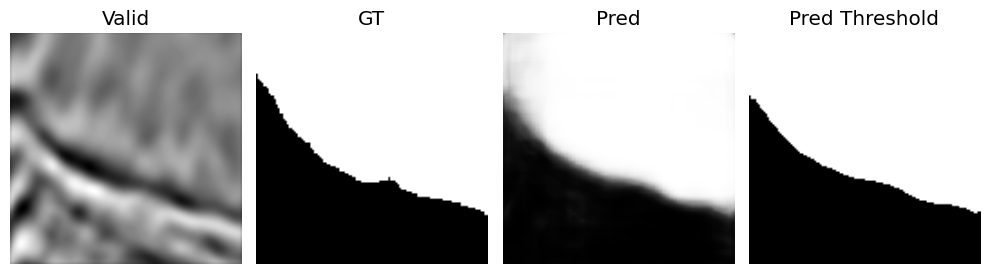

In [43]:
# Sample the validation dataset
ima = random.randint(0, y_valid.shape[0]-1)
print("Image {0}".format(ima))
fig, (ax1, ax2, ax3, ax4) = plt.subplots(1, 4, figsize = (10, 15))
ax1.imshow(valid[ima,0,:,:], cmap = 'gray', interpolation = 'bilinear')
ax1.set_title('Valid'), ax1.axis('off')
ax2.imshow(gt_valid[ima,:,:], cmap = 'gray', interpolation = 'bilinear')
ax2.set_title('GT'), ax2.axis('off')
ax3.imshow(all_pred[ima,:,:], cmap = 'gray', interpolation = 'bilinear')
ax3.set_title('Pred'), ax3.axis('off')
ax4.imshow(pred_th[ima,:,:], cmap = 'gray', interpolation = 'bilinear')
ax4.set_title('Pred Threshold'), ax4.axis('off')
fig.tight_layout()

accuracy = (pred_th[ima,:,:] == gt_valid[ima,:,:]).sum()/gt_valid.shape[1]/gt_valid.shape[2]
print("Accuracy on this image {0:1.3f}".format(accuracy))

TP = ((pred_th[ima,:,:]+gt_valid[ima,:,:])==2).sum()
P  = (pred_th[ima,:,:]).sum()
T  = (gt_valid[ima,:,:]).sum()
precision = TP/(P+1e-6)
recall    = TP/(T+1e-6)
F1        = 2*precision*recall/(precision+recall+1e-6)
if T>0:
  print("Precision: {0:1.3f}, Recall: {1:1.3f}, F1 score: {2:1.3f}".format(precision,recall,F1))

## 6 U_Net_Tr and U_Net_Up Comparison 
<font color='purple'> Once you have performed this first training and evaluation of the `U_Net_Tr` model, go back to the beginning of section 4 and run a similar experiment with the `U_Net_Up` model. Report here your conclusions about the comparison of the two models. 
 </font>

---
<font color='red'>Answer: The details of the response are after all the executed code of the second model.

</font> 

## 4.2 Training the other network

In [55]:
# Run Tensorboard
%load_ext tensorboard
%tensorboard --logdir 'logs'

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


Reusing TensorBoard on port 6006 (pid 9394), started 0:20:52 ago. (Use '!kill 9394' to kill it.)

<IPython.core.display.Javascript object>

In [45]:
model = U_Net_Up(output_ch=2)
model.to(device)

print(model)
summary(model, (1, 128, 128))

U_Net_Up(
  (Maxpool): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (Conv1): conv_block(
    (conv): Sequential(
      (0): Conv2d(1, 16, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (1): BatchNorm2d(16, eps=1e-05, momentum=0.1, affine=True, track_running_stats=False)
      (2): ReLU(inplace=True)
      (3): Conv2d(16, 16, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (4): BatchNorm2d(16, eps=1e-05, momentum=0.1, affine=True, track_running_stats=False)
      (5): ReLU(inplace=True)
    )
  )
  (Conv2): conv_block(
    (conv): Sequential(
      (0): Conv2d(16, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (1): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=False)
      (2): ReLU(inplace=True)
      (3): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (4): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=False)
      (5): ReLU(inplace=True)
   

In [46]:
loss_fn = nn.CrossEntropyLoss()
learning_rate = 1e-3 
optimizer = torch.optim.Adam(model.parameters(), lr=learning_rate)
scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(optimizer, 'min')
best_valid_F1 = 0

In [47]:
experiment_name = "U_Net_Up1"

#from tensorflow import summary
from torch.utils.tensorboard import SummaryWriter

train_log_dir = 'logs/train/' + experiment_name
val_log_dir   = 'logs/val/' + experiment_name
train_summary_writer = SummaryWriter(train_log_dir)
val_summary_writer   = SummaryWriter(val_log_dir)

if not os.path.exists('models'):
    os.makedirs('models')

In [48]:
NEpoch = 40;   # Number of Epoch
MBsize = 32;   # Minibatch size
NI     = 20;   # Batch size for validation
softmax = torch.nn.Softmax(dim=1)
torch.manual_seed(1234)
model.train()

it = 0
# Loop on Epoch
for t in notebook.tqdm(range(NEpoch), desc='Epoch: '):
  model.train()
  idx = torch.randperm(y_train_T.size()[0])
  X_train_T = X_train_T[idx]
  y_train_T = y_train_T[idx]
  
  running_loss = 0
  running_accu = 0
  running_TP, running_P, running_T   = 0.0, 0.0, 0.0

  # Loop on MiniBatch
  for n in notebook.tqdm(range(math.floor(y_train_T.shape[0]/MBsize)), desc='MiniBatch: '):
    X_train_TMB = X_train_T[n*MBsize:(n+1)*MBsize,:,:,:]
    y_train_TMB = y_train_T[n*MBsize:(n+1)*MBsize,:,:]
    X_train_TMB, y_train_TMB = X_train_TMB.to(device), y_train_TMB.to(device)
    
    # Forward pass: compute predicted y by passing x to the model.
    y_pred_TMB = model(X_train_TMB)

    # Compute the loss.
    loss = loss_fn(y_pred_TMB, y_train_TMB)
    running_loss += loss
    
    # Compute accuracy, Precision and recall
    pred    = y_pred_TMB.cpu().detach().numpy()
    pred_th = (pred[:,1,:,:]>0.5).astype(float)
    gt      = y_train_TMB.cpu().numpy()
    running_accu += (pred_th == gt).sum()/gt.size
    running_TP += ((pred_th+gt)==2).sum()
    running_P  += pred_th.sum()
    running_T  += gt.sum()
    
    # Display the training loss and F1
    if n % math.floor(y_train_T.shape[0]/MBsize/5) == 0: 
      precision = running_TP/(running_P+1e-6)
      recall    = running_TP/(running_T+1e-6)
      F1        = 2*precision*recall/(precision+recall+1e-6)
      print("Epoch{0:3d}/MiniBatch{1:4d}, MB.Loss {2:1.3f}, Av.Loss {3:1.3f}, Av.F1 {4:1.3f}"\
            .format(t+1, n+1, loss.item(), running_loss/(n+1), F1))

    # Clear the past gradients and compute new gradient
    optimizer.zero_grad()
    loss.backward()

    # Update of parameters
    optimizer.step()
    
    # Save data to tensorboard                             
    train_summary_writer.add_scalar('loss', loss.item(), global_step=it)
    bTP = ((pred_th+gt)==2).sum()
    bP  = pred_th.sum()
    bT  = gt.sum()
    bprecision = bTP/(bP+1e-6)
    brecall    = bTP/(bT+1e-6)
    bF1        = 2*bprecision*brecall/(bprecision+brecall+1e-6)
    train_summary_writer.add_scalar('F1', bF1, global_step=it)
    it = it + 1
    
  # Evaluate the model on the validation dataset
  model.eval() # This generates poor results if the BatchNorm: "track_running_stats=True"
  running_valid_accu = 0
  valid_running_loss = 0.0
  TP, P, T = 0.0, 0.0, 0.0
  for nv in range(math.floor(y_valid_T.shape[0]/NI)):
    y_pred_T = model(X_valid_T[nv*NI:(nv+1)*NI,:,:,:].to(device))
    #pred     = y_pred_T.cpu().detach().numpy()
    pred     = softmax(y_pred_T).cpu().detach().numpy()  
    pred_th  = (pred[:,1,:,:]>0.5).astype(int)
    gt       = y_valid_T[nv*NI:(nv+1)*NI,:,:].numpy()
    running_valid_accu += np.equal(pred_th, gt).sum()/gt.size
    TP += ((pred_th+gt)==2).sum()
    P  += pred_th.sum()
    T  += gt.sum()

    valid_loss = loss_fn(y_pred_T.cpu(), y_valid_T[nv*NI:(nv+1)*NI,:,:])
    valid_running_loss += valid_loss.item()
  
  # Compute the Validation F1 score and save the model if it is the best one.
  valid_accuracy = running_valid_accu/(nv+1)
  valid_loss     = valid_running_loss/(nv+1)
  precision = TP/(P+1e-6)
  recall    = TP/(T+1e-6)
  F1        = 2*precision*recall/(precision+recall+1e-6)
  if F1 > best_valid_F1:
    best_valid_F1 = F1
    checkpoint = {'model_state_dict': model.state_dict(),'optimizer_state_dict': optimizer.state_dict()}
    torch.save(checkpoint, 'models/checkpoint_' + experiment_name + '.pth')
    
  print("Validation dataset: Loss {0:1.3f}, Accuracy {1:1.3f}, F1 {2:1.3f}, Best F1 {3:1.3f}".format(valid_loss,valid_accuracy,F1,best_valid_F1))
    
  # Learning rate scheduling 
  scheduler.step(valid_loss)
    
  # Save data to tensorboard                        
  val_summary_writer.add_scalar('loss', valid_running_loss/(math.floor(y_valid_T.shape[0]/NI)), global_step=it)
  val_summary_writer.add_scalar('F1', F1, global_step=it)
  
        

Epoch:   0%|          | 0/40 [00:00<?, ?it/s]

MiniBatch:   0%|          | 0/112 [00:00<?, ?it/s]

Epoch  1/MiniBatch   1, MB.Loss 0.658, Av.Loss 0.658, Av.F1 0.009
Epoch  1/MiniBatch  23, MB.Loss 0.393, Av.Loss 0.517, Av.F1 0.164
Epoch  1/MiniBatch  45, MB.Loss 0.375, Av.Loss 0.466, Av.F1 0.303
Epoch  1/MiniBatch  67, MB.Loss 0.407, Av.Loss 0.434, Av.F1 0.374
Epoch  1/MiniBatch  89, MB.Loss 0.359, Av.Loss 0.416, Av.F1 0.427
Epoch  1/MiniBatch 111, MB.Loss 0.372, Av.Loss 0.396, Av.F1 0.479
Validation dataset: Loss 0.375, Accuracy 0.845, F1 0.673, Best F1 0.673


MiniBatch:   0%|          | 0/112 [00:00<?, ?it/s]

Epoch  2/MiniBatch   1, MB.Loss 0.448, Av.Loss 0.448, Av.F1 0.555
Epoch  2/MiniBatch  23, MB.Loss 0.305, Av.Loss 0.340, Av.F1 0.617
Epoch  2/MiniBatch  45, MB.Loss 0.556, Av.Loss 0.338, Av.F1 0.615
Epoch  2/MiniBatch  67, MB.Loss 0.434, Av.Loss 0.342, Av.F1 0.596
Epoch  2/MiniBatch  89, MB.Loss 0.318, Av.Loss 0.330, Av.F1 0.608
Epoch  2/MiniBatch 111, MB.Loss 0.277, Av.Loss 0.323, Av.F1 0.626
Validation dataset: Loss 0.315, Accuracy 0.879, F1 0.719, Best F1 0.719


MiniBatch:   0%|          | 0/112 [00:00<?, ?it/s]

Epoch  3/MiniBatch   1, MB.Loss 0.304, Av.Loss 0.304, Av.F1 0.679
Epoch  3/MiniBatch  23, MB.Loss 0.252, Av.Loss 0.286, Av.F1 0.674
Epoch  3/MiniBatch  45, MB.Loss 0.297, Av.Loss 0.293, Av.F1 0.692
Epoch  3/MiniBatch  67, MB.Loss 0.239, Av.Loss 0.287, Av.F1 0.690
Epoch  3/MiniBatch  89, MB.Loss 0.192, Av.Loss 0.280, Av.F1 0.700
Epoch  3/MiniBatch 111, MB.Loss 0.249, Av.Loss 0.277, Av.F1 0.700
Validation dataset: Loss 0.295, Accuracy 0.886, F1 0.755, Best F1 0.755


MiniBatch:   0%|          | 0/112 [00:00<?, ?it/s]

Epoch  4/MiniBatch   1, MB.Loss 0.214, Av.Loss 0.214, Av.F1 0.770
Epoch  4/MiniBatch  23, MB.Loss 0.297, Av.Loss 0.266, Av.F1 0.710
Epoch  4/MiniBatch  45, MB.Loss 0.287, Av.Loss 0.263, Av.F1 0.711
Epoch  4/MiniBatch  67, MB.Loss 0.173, Av.Loss 0.264, Av.F1 0.721
Epoch  4/MiniBatch  89, MB.Loss 0.166, Av.Loss 0.261, Av.F1 0.729
Epoch  4/MiniBatch 111, MB.Loss 0.236, Av.Loss 0.253, Av.F1 0.740
Validation dataset: Loss 0.276, Accuracy 0.888, F1 0.786, Best F1 0.786


MiniBatch:   0%|          | 0/112 [00:00<?, ?it/s]

Epoch  5/MiniBatch   1, MB.Loss 0.253, Av.Loss 0.253, Av.F1 0.780
Epoch  5/MiniBatch  23, MB.Loss 0.315, Av.Loss 0.251, Av.F1 0.724
Epoch  5/MiniBatch  45, MB.Loss 0.226, Av.Loss 0.244, Av.F1 0.752
Epoch  5/MiniBatch  67, MB.Loss 0.359, Av.Loss 0.238, Av.F1 0.762
Epoch  5/MiniBatch  89, MB.Loss 0.274, Av.Loss 0.234, Av.F1 0.766
Epoch  5/MiniBatch 111, MB.Loss 0.210, Av.Loss 0.233, Av.F1 0.763
Validation dataset: Loss 0.251, Accuracy 0.906, F1 0.793, Best F1 0.793


MiniBatch:   0%|          | 0/112 [00:00<?, ?it/s]

Epoch  6/MiniBatch   1, MB.Loss 0.218, Av.Loss 0.218, Av.F1 0.699
Epoch  6/MiniBatch  23, MB.Loss 0.154, Av.Loss 0.219, Av.F1 0.767
Epoch  6/MiniBatch  45, MB.Loss 0.230, Av.Loss 0.234, Av.F1 0.758
Epoch  6/MiniBatch  67, MB.Loss 0.200, Av.Loss 0.231, Av.F1 0.764
Epoch  6/MiniBatch  89, MB.Loss 0.140, Av.Loss 0.231, Av.F1 0.765
Epoch  6/MiniBatch 111, MB.Loss 0.180, Av.Loss 0.227, Av.F1 0.769
Validation dataset: Loss 0.238, Accuracy 0.905, F1 0.784, Best F1 0.793


MiniBatch:   0%|          | 0/112 [00:00<?, ?it/s]

Epoch  7/MiniBatch   1, MB.Loss 0.307, Av.Loss 0.307, Av.F1 0.707
Epoch  7/MiniBatch  23, MB.Loss 0.152, Av.Loss 0.230, Av.F1 0.794
Epoch  7/MiniBatch  45, MB.Loss 0.181, Av.Loss 0.227, Av.F1 0.775
Epoch  7/MiniBatch  67, MB.Loss 0.211, Av.Loss 0.224, Av.F1 0.773
Epoch  7/MiniBatch  89, MB.Loss 0.309, Av.Loss 0.222, Av.F1 0.775
Epoch  7/MiniBatch 111, MB.Loss 0.093, Av.Loss 0.215, Av.F1 0.776
Validation dataset: Loss 0.223, Accuracy 0.919, F1 0.824, Best F1 0.824


MiniBatch:   0%|          | 0/112 [00:00<?, ?it/s]

Epoch  8/MiniBatch   1, MB.Loss 0.130, Av.Loss 0.130, Av.F1 0.908
Epoch  8/MiniBatch  23, MB.Loss 0.193, Av.Loss 0.204, Av.F1 0.818
Epoch  8/MiniBatch  45, MB.Loss 0.238, Av.Loss 0.194, Av.F1 0.823
Epoch  8/MiniBatch  67, MB.Loss 0.320, Av.Loss 0.206, Av.F1 0.802
Epoch  8/MiniBatch  89, MB.Loss 0.146, Av.Loss 0.211, Av.F1 0.785
Epoch  8/MiniBatch 111, MB.Loss 0.210, Av.Loss 0.206, Av.F1 0.794
Validation dataset: Loss 0.231, Accuracy 0.915, F1 0.816, Best F1 0.824


MiniBatch:   0%|          | 0/112 [00:00<?, ?it/s]

Epoch  9/MiniBatch   1, MB.Loss 0.140, Av.Loss 0.140, Av.F1 0.843
Epoch  9/MiniBatch  23, MB.Loss 0.265, Av.Loss 0.185, Av.F1 0.807
Epoch  9/MiniBatch  45, MB.Loss 0.150, Av.Loss 0.202, Av.F1 0.800
Epoch  9/MiniBatch  67, MB.Loss 0.120, Av.Loss 0.194, Av.F1 0.811
Epoch  9/MiniBatch  89, MB.Loss 0.102, Av.Loss 0.192, Av.F1 0.810
Epoch  9/MiniBatch 111, MB.Loss 0.144, Av.Loss 0.194, Av.F1 0.804
Validation dataset: Loss 0.217, Accuracy 0.923, F1 0.840, Best F1 0.840


MiniBatch:   0%|          | 0/112 [00:00<?, ?it/s]

Epoch 10/MiniBatch   1, MB.Loss 0.205, Av.Loss 0.205, Av.F1 0.753
Epoch 10/MiniBatch  23, MB.Loss 0.196, Av.Loss 0.179, Av.F1 0.800
Epoch 10/MiniBatch  45, MB.Loss 0.200, Av.Loss 0.192, Av.F1 0.790
Epoch 10/MiniBatch  67, MB.Loss 0.277, Av.Loss 0.198, Av.F1 0.797
Epoch 10/MiniBatch  89, MB.Loss 0.168, Av.Loss 0.193, Av.F1 0.802
Epoch 10/MiniBatch 111, MB.Loss 0.240, Av.Loss 0.190, Av.F1 0.809
Validation dataset: Loss 0.211, Accuracy 0.920, F1 0.821, Best F1 0.840


MiniBatch:   0%|          | 0/112 [00:00<?, ?it/s]

Epoch 11/MiniBatch   1, MB.Loss 0.254, Av.Loss 0.254, Av.F1 0.728
Epoch 11/MiniBatch  23, MB.Loss 0.122, Av.Loss 0.159, Av.F1 0.853
Epoch 11/MiniBatch  45, MB.Loss 0.180, Av.Loss 0.183, Av.F1 0.821
Epoch 11/MiniBatch  67, MB.Loss 0.226, Av.Loss 0.180, Av.F1 0.823
Epoch 11/MiniBatch  89, MB.Loss 0.415, Av.Loss 0.191, Av.F1 0.812
Epoch 11/MiniBatch 111, MB.Loss 0.130, Av.Loss 0.187, Av.F1 0.815
Validation dataset: Loss 0.206, Accuracy 0.922, F1 0.846, Best F1 0.846


MiniBatch:   0%|          | 0/112 [00:00<?, ?it/s]

Epoch 12/MiniBatch   1, MB.Loss 0.130, Av.Loss 0.130, Av.F1 0.889
Epoch 12/MiniBatch  23, MB.Loss 0.124, Av.Loss 0.187, Av.F1 0.798
Epoch 12/MiniBatch  45, MB.Loss 0.293, Av.Loss 0.182, Av.F1 0.811
Epoch 12/MiniBatch  67, MB.Loss 0.168, Av.Loss 0.182, Av.F1 0.817
Epoch 12/MiniBatch  89, MB.Loss 0.138, Av.Loss 0.184, Av.F1 0.811
Epoch 12/MiniBatch 111, MB.Loss 0.137, Av.Loss 0.179, Av.F1 0.820
Validation dataset: Loss 0.226, Accuracy 0.916, F1 0.822, Best F1 0.846


MiniBatch:   0%|          | 0/112 [00:00<?, ?it/s]

Epoch 13/MiniBatch   1, MB.Loss 0.155, Av.Loss 0.155, Av.F1 0.821
Epoch 13/MiniBatch  23, MB.Loss 0.088, Av.Loss 0.163, Av.F1 0.824
Epoch 13/MiniBatch  45, MB.Loss 0.185, Av.Loss 0.171, Av.F1 0.844
Epoch 13/MiniBatch  67, MB.Loss 0.088, Av.Loss 0.176, Av.F1 0.822
Epoch 13/MiniBatch  89, MB.Loss 0.132, Av.Loss 0.176, Av.F1 0.823
Epoch 13/MiniBatch 111, MB.Loss 0.147, Av.Loss 0.172, Av.F1 0.829
Validation dataset: Loss 0.206, Accuracy 0.928, F1 0.851, Best F1 0.851


MiniBatch:   0%|          | 0/112 [00:00<?, ?it/s]

Epoch 14/MiniBatch   1, MB.Loss 0.193, Av.Loss 0.193, Av.F1 0.828
Epoch 14/MiniBatch  23, MB.Loss 0.151, Av.Loss 0.172, Av.F1 0.842
Epoch 14/MiniBatch  45, MB.Loss 0.101, Av.Loss 0.161, Av.F1 0.847
Epoch 14/MiniBatch  67, MB.Loss 0.166, Av.Loss 0.161, Av.F1 0.848
Epoch 14/MiniBatch  89, MB.Loss 0.231, Av.Loss 0.171, Av.F1 0.830
Epoch 14/MiniBatch 111, MB.Loss 0.133, Av.Loss 0.169, Av.F1 0.833
Validation dataset: Loss 0.203, Accuracy 0.926, F1 0.841, Best F1 0.851


MiniBatch:   0%|          | 0/112 [00:00<?, ?it/s]

Epoch 15/MiniBatch   1, MB.Loss 0.243, Av.Loss 0.243, Av.F1 0.766
Epoch 15/MiniBatch  23, MB.Loss 0.131, Av.Loss 0.161, Av.F1 0.836
Epoch 15/MiniBatch  45, MB.Loss 0.140, Av.Loss 0.161, Av.F1 0.839
Epoch 15/MiniBatch  67, MB.Loss 0.107, Av.Loss 0.158, Av.F1 0.845
Epoch 15/MiniBatch  89, MB.Loss 0.167, Av.Loss 0.158, Av.F1 0.847
Epoch 15/MiniBatch 111, MB.Loss 0.239, Av.Loss 0.156, Av.F1 0.846
Validation dataset: Loss 0.190, Accuracy 0.929, F1 0.857, Best F1 0.857


MiniBatch:   0%|          | 0/112 [00:00<?, ?it/s]

Epoch 16/MiniBatch   1, MB.Loss 0.117, Av.Loss 0.117, Av.F1 0.911
Epoch 16/MiniBatch  23, MB.Loss 0.141, Av.Loss 0.169, Av.F1 0.825
Epoch 16/MiniBatch  45, MB.Loss 0.104, Av.Loss 0.170, Av.F1 0.831
Epoch 16/MiniBatch  67, MB.Loss 0.137, Av.Loss 0.172, Av.F1 0.828
Epoch 16/MiniBatch  89, MB.Loss 0.426, Av.Loss 0.172, Av.F1 0.828
Epoch 16/MiniBatch 111, MB.Loss 0.204, Av.Loss 0.171, Av.F1 0.828
Validation dataset: Loss 0.181, Accuracy 0.931, F1 0.856, Best F1 0.857


MiniBatch:   0%|          | 0/112 [00:00<?, ?it/s]

Epoch 17/MiniBatch   1, MB.Loss 0.095, Av.Loss 0.095, Av.F1 0.893
Epoch 17/MiniBatch  23, MB.Loss 0.095, Av.Loss 0.157, Av.F1 0.853
Epoch 17/MiniBatch  45, MB.Loss 0.140, Av.Loss 0.157, Av.F1 0.849
Epoch 17/MiniBatch  67, MB.Loss 0.107, Av.Loss 0.153, Av.F1 0.849
Epoch 17/MiniBatch  89, MB.Loss 0.118, Av.Loss 0.149, Av.F1 0.855
Epoch 17/MiniBatch 111, MB.Loss 0.242, Av.Loss 0.148, Av.F1 0.855
Validation dataset: Loss 0.177, Accuracy 0.935, F1 0.866, Best F1 0.866


MiniBatch:   0%|          | 0/112 [00:00<?, ?it/s]

Epoch 18/MiniBatch   1, MB.Loss 0.132, Av.Loss 0.132, Av.F1 0.861
Epoch 18/MiniBatch  23, MB.Loss 0.092, Av.Loss 0.144, Av.F1 0.871
Epoch 18/MiniBatch  45, MB.Loss 0.197, Av.Loss 0.134, Av.F1 0.872
Epoch 18/MiniBatch  67, MB.Loss 0.101, Av.Loss 0.137, Av.F1 0.865
Epoch 18/MiniBatch  89, MB.Loss 0.166, Av.Loss 0.131, Av.F1 0.872
Epoch 18/MiniBatch 111, MB.Loss 0.128, Av.Loss 0.136, Av.F1 0.864
Validation dataset: Loss 0.169, Accuracy 0.939, F1 0.872, Best F1 0.872


MiniBatch:   0%|          | 0/112 [00:00<?, ?it/s]

Epoch 19/MiniBatch   1, MB.Loss 0.180, Av.Loss 0.180, Av.F1 0.745
Epoch 19/MiniBatch  23, MB.Loss 0.083, Av.Loss 0.146, Av.F1 0.859
Epoch 19/MiniBatch  45, MB.Loss 0.134, Av.Loss 0.142, Av.F1 0.857
Epoch 19/MiniBatch  67, MB.Loss 0.120, Av.Loss 0.143, Av.F1 0.860
Epoch 19/MiniBatch  89, MB.Loss 0.232, Av.Loss 0.146, Av.F1 0.860
Epoch 19/MiniBatch 111, MB.Loss 0.156, Av.Loss 0.151, Av.F1 0.856
Validation dataset: Loss 0.185, Accuracy 0.933, F1 0.863, Best F1 0.872


MiniBatch:   0%|          | 0/112 [00:00<?, ?it/s]

Epoch 20/MiniBatch   1, MB.Loss 0.105, Av.Loss 0.105, Av.F1 0.950
Epoch 20/MiniBatch  23, MB.Loss 0.156, Av.Loss 0.141, Av.F1 0.845
Epoch 20/MiniBatch  45, MB.Loss 0.156, Av.Loss 0.149, Av.F1 0.849
Epoch 20/MiniBatch  67, MB.Loss 0.100, Av.Loss 0.155, Av.F1 0.842
Epoch 20/MiniBatch  89, MB.Loss 0.121, Av.Loss 0.152, Av.F1 0.846
Epoch 20/MiniBatch 111, MB.Loss 0.093, Av.Loss 0.149, Av.F1 0.848
Validation dataset: Loss 0.193, Accuracy 0.928, F1 0.855, Best F1 0.872


MiniBatch:   0%|          | 0/112 [00:00<?, ?it/s]

Epoch 21/MiniBatch   1, MB.Loss 0.096, Av.Loss 0.096, Av.F1 0.951
Epoch 21/MiniBatch  23, MB.Loss 0.070, Av.Loss 0.129, Av.F1 0.866
Epoch 21/MiniBatch  45, MB.Loss 0.101, Av.Loss 0.135, Av.F1 0.857
Epoch 21/MiniBatch  67, MB.Loss 0.156, Av.Loss 0.132, Av.F1 0.867
Epoch 21/MiniBatch  89, MB.Loss 0.066, Av.Loss 0.132, Av.F1 0.863
Epoch 21/MiniBatch 111, MB.Loss 0.076, Av.Loss 0.133, Av.F1 0.863
Validation dataset: Loss 0.171, Accuracy 0.933, F1 0.864, Best F1 0.872


MiniBatch:   0%|          | 0/112 [00:00<?, ?it/s]

Epoch 22/MiniBatch   1, MB.Loss 0.194, Av.Loss 0.194, Av.F1 0.827
Epoch 22/MiniBatch  23, MB.Loss 0.097, Av.Loss 0.119, Av.F1 0.882
Epoch 22/MiniBatch  45, MB.Loss 0.149, Av.Loss 0.138, Av.F1 0.864
Epoch 22/MiniBatch  67, MB.Loss 0.119, Av.Loss 0.136, Av.F1 0.866
Epoch 22/MiniBatch  89, MB.Loss 0.075, Av.Loss 0.131, Av.F1 0.871
Epoch 22/MiniBatch 111, MB.Loss 0.151, Av.Loss 0.127, Av.F1 0.877
Validation dataset: Loss 0.209, Accuracy 0.915, F1 0.801, Best F1 0.872


MiniBatch:   0%|          | 0/112 [00:00<?, ?it/s]

Epoch 23/MiniBatch   1, MB.Loss 0.208, Av.Loss 0.208, Av.F1 0.627
Epoch 23/MiniBatch  23, MB.Loss 0.114, Av.Loss 0.167, Av.F1 0.816
Epoch 23/MiniBatch  45, MB.Loss 0.228, Av.Loss 0.142, Av.F1 0.848
Epoch 23/MiniBatch  67, MB.Loss 0.608, Av.Loss 0.139, Av.F1 0.856
Epoch 23/MiniBatch  89, MB.Loss 0.236, Av.Loss 0.137, Av.F1 0.861
Epoch 23/MiniBatch 111, MB.Loss 0.076, Av.Loss 0.132, Av.F1 0.866
Validation dataset: Loss 0.185, Accuracy 0.933, F1 0.857, Best F1 0.872


MiniBatch:   0%|          | 0/112 [00:00<?, ?it/s]

Epoch 24/MiniBatch   1, MB.Loss 0.114, Av.Loss 0.114, Av.F1 0.846
Epoch 24/MiniBatch  23, MB.Loss 0.141, Av.Loss 0.124, Av.F1 0.877
Epoch 24/MiniBatch  45, MB.Loss 0.097, Av.Loss 0.119, Av.F1 0.887
Epoch 24/MiniBatch  67, MB.Loss 0.098, Av.Loss 0.125, Av.F1 0.877
Epoch 24/MiniBatch  89, MB.Loss 0.200, Av.Loss 0.128, Av.F1 0.872
Epoch 24/MiniBatch 111, MB.Loss 0.153, Av.Loss 0.128, Av.F1 0.871
Validation dataset: Loss 0.170, Accuracy 0.938, F1 0.869, Best F1 0.872


MiniBatch:   0%|          | 0/112 [00:00<?, ?it/s]

Epoch 25/MiniBatch   1, MB.Loss 0.103, Av.Loss 0.103, Av.F1 0.868
Epoch 25/MiniBatch  23, MB.Loss 0.089, Av.Loss 0.117, Av.F1 0.879
Epoch 25/MiniBatch  45, MB.Loss 0.088, Av.Loss 0.114, Av.F1 0.879
Epoch 25/MiniBatch  67, MB.Loss 0.089, Av.Loss 0.109, Av.F1 0.890
Epoch 25/MiniBatch  89, MB.Loss 0.124, Av.Loss 0.113, Av.F1 0.889
Epoch 25/MiniBatch 111, MB.Loss 0.229, Av.Loss 0.113, Av.F1 0.886
Validation dataset: Loss 0.170, Accuracy 0.939, F1 0.874, Best F1 0.874


MiniBatch:   0%|          | 0/112 [00:00<?, ?it/s]

Epoch 26/MiniBatch   1, MB.Loss 0.178, Av.Loss 0.178, Av.F1 0.769
Epoch 26/MiniBatch  23, MB.Loss 0.102, Av.Loss 0.107, Av.F1 0.892
Epoch 26/MiniBatch  45, MB.Loss 0.126, Av.Loss 0.115, Av.F1 0.887
Epoch 26/MiniBatch  67, MB.Loss 0.057, Av.Loss 0.112, Av.F1 0.890
Epoch 26/MiniBatch  89, MB.Loss 0.158, Av.Loss 0.115, Av.F1 0.888
Epoch 26/MiniBatch 111, MB.Loss 0.130, Av.Loss 0.113, Av.F1 0.885
Validation dataset: Loss 0.173, Accuracy 0.941, F1 0.876, Best F1 0.876


MiniBatch:   0%|          | 0/112 [00:00<?, ?it/s]

Epoch 27/MiniBatch   1, MB.Loss 0.080, Av.Loss 0.080, Av.F1 0.923
Epoch 27/MiniBatch  23, MB.Loss 0.101, Av.Loss 0.108, Av.F1 0.893
Epoch 27/MiniBatch  45, MB.Loss 0.118, Av.Loss 0.113, Av.F1 0.890
Epoch 27/MiniBatch  67, MB.Loss 0.101, Av.Loss 0.111, Av.F1 0.889
Epoch 27/MiniBatch  89, MB.Loss 0.084, Av.Loss 0.108, Av.F1 0.893
Epoch 27/MiniBatch 111, MB.Loss 0.065, Av.Loss 0.106, Av.F1 0.893
Validation dataset: Loss 0.174, Accuracy 0.939, F1 0.876, Best F1 0.876


MiniBatch:   0%|          | 0/112 [00:00<?, ?it/s]

Epoch 28/MiniBatch   1, MB.Loss 0.085, Av.Loss 0.085, Av.F1 0.927
Epoch 28/MiniBatch  23, MB.Loss 0.051, Av.Loss 0.088, Av.F1 0.893
Epoch 28/MiniBatch  45, MB.Loss 0.073, Av.Loss 0.098, Av.F1 0.902
Epoch 28/MiniBatch  67, MB.Loss 0.074, Av.Loss 0.096, Av.F1 0.900
Epoch 28/MiniBatch  89, MB.Loss 0.073, Av.Loss 0.102, Av.F1 0.900
Epoch 28/MiniBatch 111, MB.Loss 0.089, Av.Loss 0.101, Av.F1 0.902
Validation dataset: Loss 0.198, Accuracy 0.931, F1 0.854, Best F1 0.876


MiniBatch:   0%|          | 0/112 [00:00<?, ?it/s]

Epoch 29/MiniBatch   1, MB.Loss 0.045, Av.Loss 0.045, Av.F1 0.950
Epoch 29/MiniBatch  23, MB.Loss 0.056, Av.Loss 0.107, Av.F1 0.890
Epoch 29/MiniBatch  45, MB.Loss 0.211, Av.Loss 0.114, Av.F1 0.890
Epoch 29/MiniBatch  67, MB.Loss 0.087, Av.Loss 0.114, Av.F1 0.882
Epoch 29/MiniBatch  89, MB.Loss 0.094, Av.Loss 0.106, Av.F1 0.890
Epoch 29/MiniBatch 111, MB.Loss 0.105, Av.Loss 0.106, Av.F1 0.894
Validation dataset: Loss 0.156, Accuracy 0.941, F1 0.878, Best F1 0.878


MiniBatch:   0%|          | 0/112 [00:00<?, ?it/s]

Epoch 30/MiniBatch   1, MB.Loss 0.040, Av.Loss 0.040, Av.F1 0.965
Epoch 30/MiniBatch  23, MB.Loss 0.077, Av.Loss 0.090, Av.F1 0.910
Epoch 30/MiniBatch  45, MB.Loss 0.068, Av.Loss 0.088, Av.F1 0.908
Epoch 30/MiniBatch  67, MB.Loss 0.084, Av.Loss 0.089, Av.F1 0.909
Epoch 30/MiniBatch  89, MB.Loss 0.056, Av.Loss 0.093, Av.F1 0.903
Epoch 30/MiniBatch 111, MB.Loss 0.065, Av.Loss 0.090, Av.F1 0.908
Validation dataset: Loss 0.277, Accuracy 0.896, F1 0.815, Best F1 0.878


MiniBatch:   0%|          | 0/112 [00:00<?, ?it/s]

Epoch 31/MiniBatch   1, MB.Loss 0.151, Av.Loss 0.151, Av.F1 0.906
Epoch 31/MiniBatch  23, MB.Loss 0.066, Av.Loss 0.102, Av.F1 0.903
Epoch 31/MiniBatch  45, MB.Loss 0.124, Av.Loss 0.091, Av.F1 0.917
Epoch 31/MiniBatch  67, MB.Loss 0.063, Av.Loss 0.092, Av.F1 0.917
Epoch 31/MiniBatch  89, MB.Loss 0.091, Av.Loss 0.092, Av.F1 0.915
Epoch 31/MiniBatch 111, MB.Loss 0.077, Av.Loss 0.093, Av.F1 0.910
Validation dataset: Loss 0.171, Accuracy 0.944, F1 0.885, Best F1 0.885


MiniBatch:   0%|          | 0/112 [00:00<?, ?it/s]

Epoch 32/MiniBatch   1, MB.Loss 0.058, Av.Loss 0.058, Av.F1 0.954
Epoch 32/MiniBatch  23, MB.Loss 0.104, Av.Loss 0.075, Av.F1 0.933
Epoch 32/MiniBatch  45, MB.Loss 0.109, Av.Loss 0.082, Av.F1 0.927
Epoch 32/MiniBatch  67, MB.Loss 0.063, Av.Loss 0.078, Av.F1 0.927
Epoch 32/MiniBatch  89, MB.Loss 0.054, Av.Loss 0.078, Av.F1 0.925
Epoch 32/MiniBatch 111, MB.Loss 0.056, Av.Loss 0.077, Av.F1 0.927
Validation dataset: Loss 0.184, Accuracy 0.938, F1 0.876, Best F1 0.885


MiniBatch:   0%|          | 0/112 [00:00<?, ?it/s]

Epoch 33/MiniBatch   1, MB.Loss 0.053, Av.Loss 0.053, Av.F1 0.966
Epoch 33/MiniBatch  23, MB.Loss 0.047, Av.Loss 0.072, Av.F1 0.935
Epoch 33/MiniBatch  45, MB.Loss 0.060, Av.Loss 0.077, Av.F1 0.930
Epoch 33/MiniBatch  67, MB.Loss 0.086, Av.Loss 0.079, Av.F1 0.925
Epoch 33/MiniBatch  89, MB.Loss 0.089, Av.Loss 0.082, Av.F1 0.923
Epoch 33/MiniBatch 111, MB.Loss 0.077, Av.Loss 0.081, Av.F1 0.921
Validation dataset: Loss 0.188, Accuracy 0.937, F1 0.875, Best F1 0.885


MiniBatch:   0%|          | 0/112 [00:00<?, ?it/s]

Epoch 34/MiniBatch   1, MB.Loss 0.112, Av.Loss 0.112, Av.F1 0.929
Epoch 34/MiniBatch  23, MB.Loss 0.155, Av.Loss 0.081, Av.F1 0.915
Epoch 34/MiniBatch  45, MB.Loss 0.075, Av.Loss 0.076, Av.F1 0.918
Epoch 34/MiniBatch  67, MB.Loss 0.052, Av.Loss 0.075, Av.F1 0.921
Epoch 34/MiniBatch  89, MB.Loss 0.040, Av.Loss 0.079, Av.F1 0.921
Epoch 34/MiniBatch 111, MB.Loss 0.120, Av.Loss 0.084, Av.F1 0.917
Validation dataset: Loss 0.172, Accuracy 0.940, F1 0.875, Best F1 0.885


MiniBatch:   0%|          | 0/112 [00:00<?, ?it/s]

Epoch 35/MiniBatch   1, MB.Loss 0.070, Av.Loss 0.070, Av.F1 0.932
Epoch 35/MiniBatch  23, MB.Loss 0.058, Av.Loss 0.069, Av.F1 0.921
Epoch 35/MiniBatch  45, MB.Loss 0.083, Av.Loss 0.069, Av.F1 0.928
Epoch 35/MiniBatch  67, MB.Loss 0.054, Av.Loss 0.071, Av.F1 0.929
Epoch 35/MiniBatch  89, MB.Loss 0.070, Av.Loss 0.072, Av.F1 0.930
Epoch 35/MiniBatch 111, MB.Loss 0.053, Av.Loss 0.072, Av.F1 0.931
Validation dataset: Loss 0.169, Accuracy 0.944, F1 0.886, Best F1 0.886


MiniBatch:   0%|          | 0/112 [00:00<?, ?it/s]

Epoch 36/MiniBatch   1, MB.Loss 0.050, Av.Loss 0.050, Av.F1 0.949
Epoch 36/MiniBatch  23, MB.Loss 0.051, Av.Loss 0.069, Av.F1 0.920
Epoch 36/MiniBatch  45, MB.Loss 0.131, Av.Loss 0.066, Av.F1 0.931
Epoch 36/MiniBatch  67, MB.Loss 0.070, Av.Loss 0.066, Av.F1 0.934
Epoch 36/MiniBatch  89, MB.Loss 0.044, Av.Loss 0.066, Av.F1 0.935
Epoch 36/MiniBatch 111, MB.Loss 0.054, Av.Loss 0.067, Av.F1 0.934
Validation dataset: Loss 0.183, Accuracy 0.946, F1 0.884, Best F1 0.886


MiniBatch:   0%|          | 0/112 [00:00<?, ?it/s]

Epoch 37/MiniBatch   1, MB.Loss 0.141, Av.Loss 0.141, Av.F1 0.858
Epoch 37/MiniBatch  23, MB.Loss 0.047, Av.Loss 0.071, Av.F1 0.935
Epoch 37/MiniBatch  45, MB.Loss 0.059, Av.Loss 0.067, Av.F1 0.936
Epoch 37/MiniBatch  67, MB.Loss 0.046, Av.Loss 0.066, Av.F1 0.936
Epoch 37/MiniBatch  89, MB.Loss 0.070, Av.Loss 0.069, Av.F1 0.934
Epoch 37/MiniBatch 111, MB.Loss 0.084, Av.Loss 0.075, Av.F1 0.930
Validation dataset: Loss 0.173, Accuracy 0.941, F1 0.880, Best F1 0.886


MiniBatch:   0%|          | 0/112 [00:00<?, ?it/s]

Epoch 38/MiniBatch   1, MB.Loss 0.082, Av.Loss 0.082, Av.F1 0.904
Epoch 38/MiniBatch  23, MB.Loss 0.103, Av.Loss 0.095, Av.F1 0.910
Epoch 38/MiniBatch  45, MB.Loss 0.050, Av.Loss 0.088, Av.F1 0.919
Epoch 38/MiniBatch  67, MB.Loss 0.046, Av.Loss 0.081, Av.F1 0.925
Epoch 38/MiniBatch  89, MB.Loss 0.028, Av.Loss 0.075, Av.F1 0.929
Epoch 38/MiniBatch 111, MB.Loss 0.087, Av.Loss 0.072, Av.F1 0.932
Validation dataset: Loss 0.194, Accuracy 0.942, F1 0.881, Best F1 0.886


MiniBatch:   0%|          | 0/112 [00:00<?, ?it/s]

Epoch 39/MiniBatch   1, MB.Loss 0.043, Av.Loss 0.043, Av.F1 0.945
Epoch 39/MiniBatch  23, MB.Loss 0.061, Av.Loss 0.054, Av.F1 0.944
Epoch 39/MiniBatch  45, MB.Loss 0.047, Av.Loss 0.055, Av.F1 0.947
Epoch 39/MiniBatch  67, MB.Loss 0.037, Av.Loss 0.058, Av.F1 0.943
Epoch 39/MiniBatch  89, MB.Loss 0.054, Av.Loss 0.061, Av.F1 0.941
Epoch 39/MiniBatch 111, MB.Loss 0.043, Av.Loss 0.060, Av.F1 0.942
Validation dataset: Loss 0.205, Accuracy 0.939, F1 0.878, Best F1 0.886


MiniBatch:   0%|          | 0/112 [00:00<?, ?it/s]

Epoch 40/MiniBatch   1, MB.Loss 0.138, Av.Loss 0.138, Av.F1 0.879
Epoch 40/MiniBatch  23, MB.Loss 0.052, Av.Loss 0.061, Av.F1 0.940
Epoch 40/MiniBatch  45, MB.Loss 0.043, Av.Loss 0.053, Av.F1 0.949
Epoch 40/MiniBatch  67, MB.Loss 0.049, Av.Loss 0.052, Av.F1 0.951
Epoch 40/MiniBatch  89, MB.Loss 0.054, Av.Loss 0.053, Av.F1 0.951
Epoch 40/MiniBatch 111, MB.Loss 0.043, Av.Loss 0.052, Av.F1 0.951
Validation dataset: Loss 0.191, Accuracy 0.944, F1 0.886, Best F1 0.886


## 5.2 Test on Validation data the other model

In [49]:
model = U_Net_Up(output_ch=2)
model.to(device)

print(model)
summary(model, (1, 128, 128))

U_Net_Up(
  (Maxpool): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (Conv1): conv_block(
    (conv): Sequential(
      (0): Conv2d(1, 16, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (1): BatchNorm2d(16, eps=1e-05, momentum=0.1, affine=True, track_running_stats=False)
      (2): ReLU(inplace=True)
      (3): Conv2d(16, 16, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (4): BatchNorm2d(16, eps=1e-05, momentum=0.1, affine=True, track_running_stats=False)
      (5): ReLU(inplace=True)
    )
  )
  (Conv2): conv_block(
    (conv): Sequential(
      (0): Conv2d(16, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (1): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=False)
      (2): ReLU(inplace=True)
      (3): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (4): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=False)
      (5): ReLU(inplace=True)
   

In [50]:
experiment_name = "U_Net_Up1"
checkpoint = torch.load('models/checkpoint_' + experiment_name + '.pth')
model.load_state_dict(checkpoint['model_state_dict'])
model.eval()

U_Net_Up(
  (Maxpool): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (Conv1): conv_block(
    (conv): Sequential(
      (0): Conv2d(1, 16, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (1): BatchNorm2d(16, eps=1e-05, momentum=0.1, affine=True, track_running_stats=False)
      (2): ReLU(inplace=True)
      (3): Conv2d(16, 16, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (4): BatchNorm2d(16, eps=1e-05, momentum=0.1, affine=True, track_running_stats=False)
      (5): ReLU(inplace=True)
    )
  )
  (Conv2): conv_block(
    (conv): Sequential(
      (0): Conv2d(16, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (1): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=False)
      (2): ReLU(inplace=True)
      (3): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (4): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=False)
      (5): ReLU(inplace=True)
   

In [51]:
# Calculate all prediction on the validation dataset
NI = 20
TP, P, T = 0.0, 0.0, 0.0
all_pred = np.zeros_like(y_valid_T, dtype=float)
running_valid_accu = 0
for nv in range(math.floor(y_valid_T.shape[0]/NI)):
  y_pred_T = model(X_valid_T[nv*NI:(nv+1)*NI,:,:,:].to(device))
  pred     = softmax(y_pred_T).cpu().detach().numpy()
  pred_th  = (pred[:,1,:,:]>0.5).astype(int)
  gt       = y_valid_T[nv*NI:(nv+1)*NI,:,:].numpy()
  running_valid_accu += np.equal(pred_th, gt).sum()/gt.size
  TP += ((pred_th+gt)==2).sum()
  P  += pred_th.sum()
  T  += gt.sum()
  all_pred[nv*NI:(nv+1)*NI,:,:]=pred[:,1,:,:]

pred_th = (all_pred[:,:,:]>0.5).astype(int)
valid_accuracy = running_valid_accu/(nv+1)
print("Validation Accuracy {0:1.3f}".format(valid_accuracy))
precision = TP/(P+1e-6)
recall    = TP/(T+1e-6)
F1        = 2*precision*recall/(precision+recall+1e-6)
print("Precision: {0:1.3f}, Recall: {1:1.3f}, F1 score: {2:1.3f}".format(precision,recall,F1))

Validation Accuracy 0.944
Precision: 0.914, Recall: 0.860, F1 score: 0.886


Image 150
Accuracy on this image 1.000


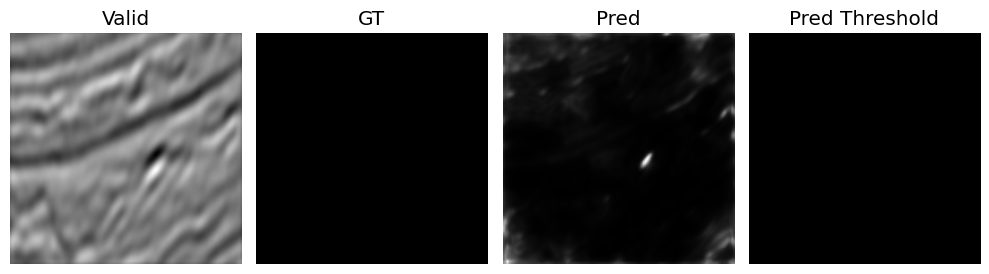

In [52]:
# Sample the validation dataset
ima = random.randint(0, y_valid.shape[0]-1)
print("Image {0}".format(ima))
fig, (ax1, ax2, ax3, ax4) = plt.subplots(1, 4, figsize = (10, 15))
ax1.imshow(valid[ima,0,:,:], cmap = 'gray', interpolation = 'bilinear')
ax1.set_title('Valid'), ax1.axis('off')
ax2.imshow(gt_valid[ima,:,:], cmap = 'gray', interpolation = 'bilinear')
ax2.set_title('GT'), ax2.axis('off')
ax3.imshow(all_pred[ima,:,:], cmap = 'gray', interpolation = 'bilinear')
ax3.set_title('Pred'), ax3.axis('off')
ax4.imshow(pred_th[ima,:,:], cmap = 'gray', interpolation = 'bilinear')
ax4.set_title('Pred Threshold'), ax4.axis('off')
fig.tight_layout()

accuracy = (pred_th[ima,:,:] == gt_valid[ima,:,:]).sum()/gt_valid.shape[1]/gt_valid.shape[2]
print("Accuracy on this image {0:1.3f}".format(accuracy))

TP = ((pred_th[ima,:,:]+gt_valid[ima,:,:])==2).sum()
P  = (pred_th[ima,:,:]).sum()
T  = (gt_valid[ima,:,:]).sum()
precision = TP/(P+1e-6)
recall    = TP/(T+1e-6)
F1        = 2*precision*recall/(precision+recall+1e-6)
if T>0:
  print("Precision: {0:1.3f}, Recall: {1:1.3f}, F1 score: {2:1.3f}".format(precision,recall,F1))

---
<font color='red'>Answer: 

<font color='red'> Metrics for the first model -> Validation Accuracy: 0.950, Precision: 0.909, Recall: 0.889, F1 score: 0.899

<font color='red'> Metrics for the second model -> Validation Accuracy: 0.946, Precision: 0.915, Recall: 0.866, F1 score: 0.890

<font color='red'> Comparing the metrics of the two models, we can see that the first model has better accuracy and recall, while the second model has better precision. Due to this, the F1 score is almost the same for both models. It can be interpreted that the first model gives more false positives, meaning it identifies more non-salt deposits as salt.

<font color='red'> We can see this with the example image we extracted to visualize how the model works. The specific metrics for this image, which is image 157, are: Accuracy on this image: 0.928, Precision: 0.428, Recall: 0.764, F1 score: 0.549. We can see that we have a very high precision because it identifies the salt deposit according to the ground truth, but it also includes more of the image that is not salt.

<font color='red'> We can also observe how the second model performs following the same steps and analyzing a specific image, in this case, image 361. We obtain the following metrics: Accuracy on this image: 0.967, Precision: 0.957, Recall: 0.964, F1 score: 0.960. In this specific image, the second model performs exceptionally well, achieving very high values in all analyzed metrics.

<font color='red'> Since both models have performed similarly overall, we do not believe there is a significant difference to choose one over the other. The second one, having better precision, might be slightly better. One of the use cases for the trained model could be to help a company decide where to open a new extraction, and it's better to believe that the deposit is smaller than it actually is than to believe the opposite and allocate too many resources.


</font> 

## 7 The challenge

<font color='purple'> So, now it is time to challenge you to create a model that may outperform the models studied so far. Report here your main conclusions and specify the model (feel free to use "Code cells" if necessary for your answer). 
 </font>

---
<font color='red'>Answer: The model proposed below is simply an improvement of the U_Net_Tr model, to which an additional layer has been added and the number of iterations has been increased to 50. 

</font> 

In [71]:
model = U_Net_MOD(output_ch=2)
model.to(device)

summary(model, (1, 128, 128))

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1         [-1, 16, 128, 128]             160
       BatchNorm2d-2         [-1, 16, 128, 128]              32
              ReLU-3         [-1, 16, 128, 128]               0
            Conv2d-4         [-1, 16, 128, 128]           2,320
       BatchNorm2d-5         [-1, 16, 128, 128]              32
              ReLU-6         [-1, 16, 128, 128]               0
        conv_block-7         [-1, 16, 128, 128]               0
         MaxPool2d-8           [-1, 16, 64, 64]               0
            Conv2d-9           [-1, 32, 64, 64]           4,640
      BatchNorm2d-10           [-1, 32, 64, 64]              64
             ReLU-11           [-1, 32, 64, 64]               0
           Conv2d-12           [-1, 32, 64, 64]           9,248
      BatchNorm2d-13           [-1, 32, 64, 64]              64
             ReLU-14           [-1, 32,

In [72]:
loss_fn = nn.CrossEntropyLoss()
learning_rate = 1e-3 
optimizer = torch.optim.Adam(model.parameters(), lr=learning_rate)
scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(optimizer, 'min')
best_valid_F1 = 0

In [73]:
experiment_name = "U_Net_MOD"

#from tensorflow import summary
from torch.utils.tensorboard import SummaryWriter

train_log_dir = 'logs/train/' + experiment_name
val_log_dir   = 'logs/val/' + experiment_name
train_summary_writer = SummaryWriter(train_log_dir)
val_summary_writer   = SummaryWriter(val_log_dir)

if not os.path.exists('models'):
    os.makedirs('models')

In [79]:
NEpoch = 50;   # Number of Epoch
MBsize = 32;   # Minibatch size
NI     = 20;   # Batch size for validation
softmax = torch.nn.Softmax(dim=1)
torch.manual_seed(1234)
model.train()

it = 0
# Loop on Epoch
for t in notebook.tqdm(range(NEpoch), desc='Epoch: '):
  model.train()
  idx = torch.randperm(y_train_T.size()[0])
  X_train_T = X_train_T[idx]
  y_train_T = y_train_T[idx]
  
  running_loss = 0
  running_accu = 0
  running_TP, running_P, running_T   = 0.0, 0.0, 0.0

  # Loop on MiniBatch
  for n in notebook.tqdm(range(math.floor(y_train_T.shape[0]/MBsize)), desc='MiniBatch: '):
    X_train_TMB = X_train_T[n*MBsize:(n+1)*MBsize,:,:,:]
    y_train_TMB = y_train_T[n*MBsize:(n+1)*MBsize,:,:]
    X_train_TMB, y_train_TMB = X_train_TMB.to(device), y_train_TMB.to(device)
    
    # Forward pass: compute predicted y by passing x to the model.
    y_pred_TMB = model(X_train_TMB)

    # Compute the loss.
    loss = loss_fn(y_pred_TMB, y_train_TMB)
    running_loss += loss
    
    # Compute accuracy, Precision and recall
    pred    = y_pred_TMB.cpu().detach().numpy()
    pred_th = (pred[:,1,:,:]>0.5).astype(float)
    gt      = y_train_TMB.cpu().numpy()
    running_accu += (pred_th == gt).sum()/gt.size
    running_TP += ((pred_th+gt)==2).sum()
    running_P  += pred_th.sum()
    running_T  += gt.sum()
    
    # Display the training loss and F1
    if n % math.floor(y_train_T.shape[0]/MBsize/5) == 0: 
      precision = running_TP/(running_P+1e-6)
      recall    = running_TP/(running_T+1e-6)
      F1        = 2*precision*recall/(precision+recall+1e-6)
      print("Epoch{0:3d}/MiniBatch{1:4d}, MB.Loss {2:1.3f}, Av.Loss {3:1.3f}, Av.F1 {4:1.3f}"\
            .format(t+1, n+1, loss.item(), running_loss/(n+1), F1))

    # Clear the past gradients and compute new gradient
    optimizer.zero_grad()
    loss.backward()

    # Update of parameters
    optimizer.step()
    
    # Save data to tensorboard                             
    train_summary_writer.add_scalar('loss', loss.item(), global_step=it)
    bTP = ((pred_th+gt)==2).sum()
    bP  = pred_th.sum()
    bT  = gt.sum()
    bprecision = bTP/(bP+1e-6)
    brecall    = bTP/(bT+1e-6)
    bF1        = 2*bprecision*brecall/(bprecision+brecall+1e-6)
    train_summary_writer.add_scalar('F1', bF1, global_step=it)
    it = it + 1
    
  # Evaluate the model on the validation dataset
  model.eval() # This generates poor results if the BatchNorm: "track_running_stats=True"
  running_valid_accu = 0
  valid_running_loss = 0.0
  TP, P, T = 0.0, 0.0, 0.0
  for nv in range(math.floor(y_valid_T.shape[0]/NI)):
    y_pred_T = model(X_valid_T[nv*NI:(nv+1)*NI,:,:,:].to(device))
    #pred     = y_pred_T.cpu().detach().numpy()
    pred     = softmax(y_pred_T).cpu().detach().numpy()  
    pred_th  = (pred[:,1,:,:]>0.5).astype(int)
    gt       = y_valid_T[nv*NI:(nv+1)*NI,:,:].numpy()
    running_valid_accu += np.equal(pred_th, gt).sum()/gt.size
    TP += ((pred_th+gt)==2).sum()
    P  += pred_th.sum()
    T  += gt.sum()

    valid_loss = loss_fn(y_pred_T.cpu(), y_valid_T[nv*NI:(nv+1)*NI,:,:])
    valid_running_loss += valid_loss.item()
  
  # Compute the Validation F1 score and save the model if it is the best one.
  valid_accuracy = running_valid_accu/(nv+1)
  valid_loss     = valid_running_loss/(nv+1)
  precision = TP/(P+1e-6)
  recall    = TP/(T+1e-6)
  F1        = 2*precision*recall/(precision+recall+1e-6)
  if F1 > best_valid_F1:
    best_valid_F1 = F1
    checkpoint = {'model_state_dict': model.state_dict(),'optimizer_state_dict': optimizer.state_dict()}
    torch.save(checkpoint, 'models/checkpoint_' + experiment_name + '.pth')
    
  print("Validation dataset: Loss {0:1.3f}, Accuracy {1:1.3f}, F1 {2:1.3f}, Best F1 {3:1.3f}".format(valid_loss,valid_accuracy,F1,best_valid_F1))
    
  # Learning rate scheduling 
  scheduler.step(valid_loss)
    
  # Save data to tensorboard                        
  val_summary_writer.add_scalar('loss', valid_running_loss/(math.floor(y_valid_T.shape[0]/NI)), global_step=it)
  val_summary_writer.add_scalar('F1', F1, global_step=it)

Epoch:   0%|          | 0/50 [00:00<?, ?it/s]

MiniBatch:   0%|          | 0/112 [00:00<?, ?it/s]

Epoch  1/MiniBatch   1, MB.Loss 0.049, Av.Loss 0.049, Av.F1 0.941
Epoch  1/MiniBatch  23, MB.Loss 0.061, Av.Loss 0.047, Av.F1 0.954
Epoch  1/MiniBatch  45, MB.Loss 0.046, Av.Loss 0.055, Av.F1 0.951
Epoch  1/MiniBatch  67, MB.Loss 0.034, Av.Loss 0.058, Av.F1 0.948
Epoch  1/MiniBatch  89, MB.Loss 0.054, Av.Loss 0.065, Av.F1 0.943
Epoch  1/MiniBatch 111, MB.Loss 0.074, Av.Loss 0.072, Av.F1 0.937
Validation dataset: Loss 0.169, Accuracy 0.940, F1 0.881, Best F1 0.896


MiniBatch:   0%|          | 0/112 [00:00<?, ?it/s]

Epoch  2/MiniBatch   1, MB.Loss 0.104, Av.Loss 0.104, Av.F1 0.911
Epoch  2/MiniBatch  23, MB.Loss 0.077, Av.Loss 0.081, Av.F1 0.924
Epoch  2/MiniBatch  45, MB.Loss 0.077, Av.Loss 0.074, Av.F1 0.928
Epoch  2/MiniBatch  67, MB.Loss 0.047, Av.Loss 0.072, Av.F1 0.933
Epoch  2/MiniBatch  89, MB.Loss 0.079, Av.Loss 0.071, Av.F1 0.933
Epoch  2/MiniBatch 111, MB.Loss 0.049, Av.Loss 0.070, Av.F1 0.934
Validation dataset: Loss 0.179, Accuracy 0.944, F1 0.882, Best F1 0.896


MiniBatch:   0%|          | 0/112 [00:00<?, ?it/s]

Epoch  3/MiniBatch   1, MB.Loss 0.042, Av.Loss 0.042, Av.F1 0.967
Epoch  3/MiniBatch  23, MB.Loss 0.033, Av.Loss 0.051, Av.F1 0.952
Epoch  3/MiniBatch  45, MB.Loss 0.120, Av.Loss 0.062, Av.F1 0.949
Epoch  3/MiniBatch  67, MB.Loss 0.087, Av.Loss 0.062, Av.F1 0.948
Epoch  3/MiniBatch  89, MB.Loss 0.072, Av.Loss 0.060, Av.F1 0.949
Epoch  3/MiniBatch 111, MB.Loss 0.043, Av.Loss 0.061, Av.F1 0.947
Validation dataset: Loss 0.171, Accuracy 0.945, F1 0.889, Best F1 0.896


MiniBatch:   0%|          | 0/112 [00:00<?, ?it/s]

Epoch  4/MiniBatch   1, MB.Loss 0.075, Av.Loss 0.075, Av.F1 0.958
Epoch  4/MiniBatch  23, MB.Loss 0.045, Av.Loss 0.053, Av.F1 0.953
Epoch  4/MiniBatch  45, MB.Loss 0.042, Av.Loss 0.061, Av.F1 0.947
Epoch  4/MiniBatch  67, MB.Loss 0.037, Av.Loss 0.061, Av.F1 0.945
Epoch  4/MiniBatch  89, MB.Loss 0.081, Av.Loss 0.061, Av.F1 0.944
Epoch  4/MiniBatch 111, MB.Loss 0.039, Av.Loss 0.062, Av.F1 0.943
Validation dataset: Loss 0.196, Accuracy 0.939, F1 0.876, Best F1 0.896


MiniBatch:   0%|          | 0/112 [00:00<?, ?it/s]

Epoch  5/MiniBatch   1, MB.Loss 0.041, Av.Loss 0.041, Av.F1 0.955
Epoch  5/MiniBatch  23, MB.Loss 0.050, Av.Loss 0.067, Av.F1 0.939
Epoch  5/MiniBatch  45, MB.Loss 0.042, Av.Loss 0.062, Av.F1 0.942
Epoch  5/MiniBatch  67, MB.Loss 0.034, Av.Loss 0.058, Av.F1 0.945
Epoch  5/MiniBatch  89, MB.Loss 0.034, Av.Loss 0.058, Av.F1 0.947
Epoch  5/MiniBatch 111, MB.Loss 0.060, Av.Loss 0.058, Av.F1 0.947
Validation dataset: Loss 0.257, Accuracy 0.930, F1 0.863, Best F1 0.896


MiniBatch:   0%|          | 0/112 [00:00<?, ?it/s]

Epoch  6/MiniBatch   1, MB.Loss 0.164, Av.Loss 0.164, Av.F1 0.869
Epoch  6/MiniBatch  23, MB.Loss 0.172, Av.Loss 0.109, Av.F1 0.894
Epoch  6/MiniBatch  45, MB.Loss 0.104, Av.Loss 0.112, Av.F1 0.893
Epoch  6/MiniBatch  67, MB.Loss 0.098, Av.Loss 0.108, Av.F1 0.899
Epoch  6/MiniBatch  89, MB.Loss 0.040, Av.Loss 0.104, Av.F1 0.900
Epoch  6/MiniBatch 111, MB.Loss 0.066, Av.Loss 0.098, Av.F1 0.908
Validation dataset: Loss 0.214, Accuracy 0.935, F1 0.869, Best F1 0.896


MiniBatch:   0%|          | 0/112 [00:00<?, ?it/s]

Epoch  7/MiniBatch   1, MB.Loss 0.038, Av.Loss 0.038, Av.F1 0.979
Epoch  7/MiniBatch  23, MB.Loss 0.120, Av.Loss 0.061, Av.F1 0.946
Epoch  7/MiniBatch  45, MB.Loss 0.072, Av.Loss 0.067, Av.F1 0.940
Epoch  7/MiniBatch  67, MB.Loss 0.044, Av.Loss 0.065, Av.F1 0.941
Epoch  7/MiniBatch  89, MB.Loss 0.049, Av.Loss 0.064, Av.F1 0.941
Epoch  7/MiniBatch 111, MB.Loss 0.030, Av.Loss 0.062, Av.F1 0.944
Validation dataset: Loss 0.196, Accuracy 0.942, F1 0.879, Best F1 0.896


MiniBatch:   0%|          | 0/112 [00:00<?, ?it/s]

Epoch  8/MiniBatch   1, MB.Loss 0.052, Av.Loss 0.052, Av.F1 0.964
Epoch  8/MiniBatch  23, MB.Loss 0.049, Av.Loss 0.061, Av.F1 0.949
Epoch  8/MiniBatch  45, MB.Loss 0.029, Av.Loss 0.061, Av.F1 0.948
Epoch  8/MiniBatch  67, MB.Loss 0.033, Av.Loss 0.061, Av.F1 0.948
Epoch  8/MiniBatch  89, MB.Loss 0.084, Av.Loss 0.062, Av.F1 0.947
Epoch  8/MiniBatch 111, MB.Loss 0.075, Av.Loss 0.061, Av.F1 0.947
Validation dataset: Loss 0.179, Accuracy 0.943, F1 0.887, Best F1 0.896


MiniBatch:   0%|          | 0/112 [00:00<?, ?it/s]

Epoch  9/MiniBatch   1, MB.Loss 0.085, Av.Loss 0.085, Av.F1 0.948
Epoch  9/MiniBatch  23, MB.Loss 0.060, Av.Loss 0.058, Av.F1 0.947
Epoch  9/MiniBatch  45, MB.Loss 0.059, Av.Loss 0.057, Av.F1 0.948
Epoch  9/MiniBatch  67, MB.Loss 0.049, Av.Loss 0.055, Av.F1 0.950
Epoch  9/MiniBatch  89, MB.Loss 0.043, Av.Loss 0.054, Av.F1 0.951
Epoch  9/MiniBatch 111, MB.Loss 0.074, Av.Loss 0.053, Av.F1 0.951
Validation dataset: Loss 0.186, Accuracy 0.948, F1 0.893, Best F1 0.896


MiniBatch:   0%|          | 0/112 [00:00<?, ?it/s]

Epoch 10/MiniBatch   1, MB.Loss 0.049, Av.Loss 0.049, Av.F1 0.965
Epoch 10/MiniBatch  23, MB.Loss 0.050, Av.Loss 0.043, Av.F1 0.961
Epoch 10/MiniBatch  45, MB.Loss 0.051, Av.Loss 0.042, Av.F1 0.962
Epoch 10/MiniBatch  67, MB.Loss 0.026, Av.Loss 0.042, Av.F1 0.962
Epoch 10/MiniBatch  89, MB.Loss 0.037, Av.Loss 0.043, Av.F1 0.962
Epoch 10/MiniBatch 111, MB.Loss 0.050, Av.Loss 0.043, Av.F1 0.962
Validation dataset: Loss 0.172, Accuracy 0.949, F1 0.897, Best F1 0.897


MiniBatch:   0%|          | 0/112 [00:00<?, ?it/s]

Epoch 11/MiniBatch   1, MB.Loss 0.045, Av.Loss 0.045, Av.F1 0.958
Epoch 11/MiniBatch  23, MB.Loss 0.034, Av.Loss 0.041, Av.F1 0.962
Epoch 11/MiniBatch  45, MB.Loss 0.057, Av.Loss 0.040, Av.F1 0.962
Epoch 11/MiniBatch  67, MB.Loss 0.044, Av.Loss 0.041, Av.F1 0.962
Epoch 11/MiniBatch  89, MB.Loss 0.023, Av.Loss 0.041, Av.F1 0.962
Epoch 11/MiniBatch 111, MB.Loss 0.053, Av.Loss 0.041, Av.F1 0.962
Validation dataset: Loss 0.181, Accuracy 0.948, F1 0.894, Best F1 0.897


MiniBatch:   0%|          | 0/112 [00:00<?, ?it/s]

Epoch 12/MiniBatch   1, MB.Loss 0.071, Av.Loss 0.071, Av.F1 0.950
Epoch 12/MiniBatch  23, MB.Loss 0.043, Av.Loss 0.040, Av.F1 0.966
Epoch 12/MiniBatch  45, MB.Loss 0.038, Av.Loss 0.039, Av.F1 0.966
Epoch 12/MiniBatch  67, MB.Loss 0.039, Av.Loss 0.039, Av.F1 0.965
Epoch 12/MiniBatch  89, MB.Loss 0.050, Av.Loss 0.038, Av.F1 0.964
Epoch 12/MiniBatch 111, MB.Loss 0.047, Av.Loss 0.040, Av.F1 0.964
Validation dataset: Loss 0.175, Accuracy 0.949, F1 0.897, Best F1 0.897


MiniBatch:   0%|          | 0/112 [00:00<?, ?it/s]

Epoch 13/MiniBatch   1, MB.Loss 0.075, Av.Loss 0.075, Av.F1 0.944
Epoch 13/MiniBatch  23, MB.Loss 0.038, Av.Loss 0.043, Av.F1 0.962
Epoch 13/MiniBatch  45, MB.Loss 0.035, Av.Loss 0.040, Av.F1 0.964
Epoch 13/MiniBatch  67, MB.Loss 0.025, Av.Loss 0.039, Av.F1 0.965
Epoch 13/MiniBatch  89, MB.Loss 0.028, Av.Loss 0.039, Av.F1 0.964
Epoch 13/MiniBatch 111, MB.Loss 0.029, Av.Loss 0.039, Av.F1 0.964
Validation dataset: Loss 0.174, Accuracy 0.949, F1 0.897, Best F1 0.897


MiniBatch:   0%|          | 0/112 [00:00<?, ?it/s]

Epoch 14/MiniBatch   1, MB.Loss 0.040, Av.Loss 0.040, Av.F1 0.948
Epoch 14/MiniBatch  23, MB.Loss 0.042, Av.Loss 0.039, Av.F1 0.964
Epoch 14/MiniBatch  45, MB.Loss 0.041, Av.Loss 0.038, Av.F1 0.965
Epoch 14/MiniBatch  67, MB.Loss 0.039, Av.Loss 0.038, Av.F1 0.966
Epoch 14/MiniBatch  89, MB.Loss 0.027, Av.Loss 0.038, Av.F1 0.965
Epoch 14/MiniBatch 111, MB.Loss 0.035, Av.Loss 0.038, Av.F1 0.966
Validation dataset: Loss 0.171, Accuracy 0.950, F1 0.899, Best F1 0.899


MiniBatch:   0%|          | 0/112 [00:00<?, ?it/s]

Epoch 15/MiniBatch   1, MB.Loss 0.040, Av.Loss 0.040, Av.F1 0.956
Epoch 15/MiniBatch  23, MB.Loss 0.020, Av.Loss 0.037, Av.F1 0.966
Epoch 15/MiniBatch  45, MB.Loss 0.046, Av.Loss 0.039, Av.F1 0.965
Epoch 15/MiniBatch  67, MB.Loss 0.032, Av.Loss 0.038, Av.F1 0.965
Epoch 15/MiniBatch  89, MB.Loss 0.055, Av.Loss 0.038, Av.F1 0.966
Epoch 15/MiniBatch 111, MB.Loss 0.033, Av.Loss 0.038, Av.F1 0.966
Validation dataset: Loss 0.173, Accuracy 0.950, F1 0.899, Best F1 0.899


MiniBatch:   0%|          | 0/112 [00:00<?, ?it/s]

Epoch 16/MiniBatch   1, MB.Loss 0.041, Av.Loss 0.041, Av.F1 0.960
Epoch 16/MiniBatch  23, MB.Loss 0.030, Av.Loss 0.036, Av.F1 0.965
Epoch 16/MiniBatch  45, MB.Loss 0.025, Av.Loss 0.035, Av.F1 0.967
Epoch 16/MiniBatch  67, MB.Loss 0.039, Av.Loss 0.037, Av.F1 0.966
Epoch 16/MiniBatch  89, MB.Loss 0.034, Av.Loss 0.036, Av.F1 0.967
Epoch 16/MiniBatch 111, MB.Loss 0.055, Av.Loss 0.037, Av.F1 0.966
Validation dataset: Loss 0.175, Accuracy 0.951, F1 0.899, Best F1 0.899


MiniBatch:   0%|          | 0/112 [00:00<?, ?it/s]

Epoch 17/MiniBatch   1, MB.Loss 0.026, Av.Loss 0.026, Av.F1 0.959
Epoch 17/MiniBatch  23, MB.Loss 0.072, Av.Loss 0.041, Av.F1 0.959
Epoch 17/MiniBatch  45, MB.Loss 0.036, Av.Loss 0.039, Av.F1 0.963
Epoch 17/MiniBatch  67, MB.Loss 0.043, Av.Loss 0.038, Av.F1 0.964
Epoch 17/MiniBatch  89, MB.Loss 0.045, Av.Loss 0.038, Av.F1 0.964
Epoch 17/MiniBatch 111, MB.Loss 0.027, Av.Loss 0.038, Av.F1 0.965
Validation dataset: Loss 0.175, Accuracy 0.951, F1 0.899, Best F1 0.899


MiniBatch:   0%|          | 0/112 [00:00<?, ?it/s]

Epoch 18/MiniBatch   1, MB.Loss 0.020, Av.Loss 0.020, Av.F1 0.977
Epoch 18/MiniBatch  23, MB.Loss 0.022, Av.Loss 0.036, Av.F1 0.967
Epoch 18/MiniBatch  45, MB.Loss 0.040, Av.Loss 0.035, Av.F1 0.968
Epoch 18/MiniBatch  67, MB.Loss 0.048, Av.Loss 0.035, Av.F1 0.968
Epoch 18/MiniBatch  89, MB.Loss 0.027, Av.Loss 0.036, Av.F1 0.967
Epoch 18/MiniBatch 111, MB.Loss 0.023, Av.Loss 0.036, Av.F1 0.967
Validation dataset: Loss 0.177, Accuracy 0.951, F1 0.899, Best F1 0.899


MiniBatch:   0%|          | 0/112 [00:00<?, ?it/s]

Epoch 19/MiniBatch   1, MB.Loss 0.041, Av.Loss 0.041, Av.F1 0.971
Epoch 19/MiniBatch  23, MB.Loss 0.045, Av.Loss 0.039, Av.F1 0.963
Epoch 19/MiniBatch  45, MB.Loss 0.034, Av.Loss 0.037, Av.F1 0.965
Epoch 19/MiniBatch  67, MB.Loss 0.038, Av.Loss 0.036, Av.F1 0.966
Epoch 19/MiniBatch  89, MB.Loss 0.027, Av.Loss 0.037, Av.F1 0.966
Epoch 19/MiniBatch 111, MB.Loss 0.045, Av.Loss 0.037, Av.F1 0.966
Validation dataset: Loss 0.179, Accuracy 0.950, F1 0.899, Best F1 0.899


MiniBatch:   0%|          | 0/112 [00:00<?, ?it/s]

Epoch 20/MiniBatch   1, MB.Loss 0.036, Av.Loss 0.036, Av.F1 0.961
Epoch 20/MiniBatch  23, MB.Loss 0.028, Av.Loss 0.035, Av.F1 0.969
Epoch 20/MiniBatch  45, MB.Loss 0.034, Av.Loss 0.036, Av.F1 0.968
Epoch 20/MiniBatch  67, MB.Loss 0.029, Av.Loss 0.035, Av.F1 0.969
Epoch 20/MiniBatch  89, MB.Loss 0.057, Av.Loss 0.035, Av.F1 0.969
Epoch 20/MiniBatch 111, MB.Loss 0.039, Av.Loss 0.036, Av.F1 0.968
Validation dataset: Loss 0.180, Accuracy 0.950, F1 0.898, Best F1 0.899


MiniBatch:   0%|          | 0/112 [00:00<?, ?it/s]

Epoch 21/MiniBatch   1, MB.Loss 0.041, Av.Loss 0.041, Av.F1 0.978
Epoch 21/MiniBatch  23, MB.Loss 0.035, Av.Loss 0.034, Av.F1 0.968
Epoch 21/MiniBatch  45, MB.Loss 0.032, Av.Loss 0.035, Av.F1 0.967
Epoch 21/MiniBatch  67, MB.Loss 0.025, Av.Loss 0.035, Av.F1 0.968
Epoch 21/MiniBatch  89, MB.Loss 0.033, Av.Loss 0.035, Av.F1 0.968
Epoch 21/MiniBatch 111, MB.Loss 0.030, Av.Loss 0.034, Av.F1 0.968
Validation dataset: Loss 0.181, Accuracy 0.950, F1 0.898, Best F1 0.899


MiniBatch:   0%|          | 0/112 [00:00<?, ?it/s]

Epoch 22/MiniBatch   1, MB.Loss 0.028, Av.Loss 0.028, Av.F1 0.972
Epoch 22/MiniBatch  23, MB.Loss 0.064, Av.Loss 0.034, Av.F1 0.972
Epoch 22/MiniBatch  45, MB.Loss 0.047, Av.Loss 0.034, Av.F1 0.970
Epoch 22/MiniBatch  67, MB.Loss 0.033, Av.Loss 0.035, Av.F1 0.969
Epoch 22/MiniBatch  89, MB.Loss 0.022, Av.Loss 0.034, Av.F1 0.968
Epoch 22/MiniBatch 111, MB.Loss 0.041, Av.Loss 0.035, Av.F1 0.968
Validation dataset: Loss 0.181, Accuracy 0.950, F1 0.899, Best F1 0.899


MiniBatch:   0%|          | 0/112 [00:00<?, ?it/s]

Epoch 23/MiniBatch   1, MB.Loss 0.040, Av.Loss 0.040, Av.F1 0.966
Epoch 23/MiniBatch  23, MB.Loss 0.018, Av.Loss 0.036, Av.F1 0.969
Epoch 23/MiniBatch  45, MB.Loss 0.037, Av.Loss 0.035, Av.F1 0.970
Epoch 23/MiniBatch  67, MB.Loss 0.030, Av.Loss 0.034, Av.F1 0.970
Epoch 23/MiniBatch  89, MB.Loss 0.030, Av.Loss 0.035, Av.F1 0.968
Epoch 23/MiniBatch 111, MB.Loss 0.043, Av.Loss 0.035, Av.F1 0.969
Validation dataset: Loss 0.181, Accuracy 0.950, F1 0.898, Best F1 0.899


MiniBatch:   0%|          | 0/112 [00:00<?, ?it/s]

Epoch 24/MiniBatch   1, MB.Loss 0.024, Av.Loss 0.024, Av.F1 0.964
Epoch 24/MiniBatch  23, MB.Loss 0.027, Av.Loss 0.031, Av.F1 0.971
Epoch 24/MiniBatch  45, MB.Loss 0.047, Av.Loss 0.033, Av.F1 0.970
Epoch 24/MiniBatch  67, MB.Loss 0.041, Av.Loss 0.034, Av.F1 0.969
Epoch 24/MiniBatch  89, MB.Loss 0.023, Av.Loss 0.034, Av.F1 0.969
Epoch 24/MiniBatch 111, MB.Loss 0.041, Av.Loss 0.034, Av.F1 0.968
Validation dataset: Loss 0.182, Accuracy 0.950, F1 0.898, Best F1 0.899


MiniBatch:   0%|          | 0/112 [00:00<?, ?it/s]

Epoch 25/MiniBatch   1, MB.Loss 0.039, Av.Loss 0.039, Av.F1 0.960
Epoch 25/MiniBatch  23, MB.Loss 0.034, Av.Loss 0.037, Av.F1 0.966
Epoch 25/MiniBatch  45, MB.Loss 0.046, Av.Loss 0.036, Av.F1 0.967
Epoch 25/MiniBatch  67, MB.Loss 0.023, Av.Loss 0.036, Av.F1 0.967
Epoch 25/MiniBatch  89, MB.Loss 0.027, Av.Loss 0.035, Av.F1 0.968
Epoch 25/MiniBatch 111, MB.Loss 0.021, Av.Loss 0.034, Av.F1 0.968
Validation dataset: Loss 0.182, Accuracy 0.950, F1 0.898, Best F1 0.899


MiniBatch:   0%|          | 0/112 [00:00<?, ?it/s]

Epoch 26/MiniBatch   1, MB.Loss 0.024, Av.Loss 0.024, Av.F1 0.975
Epoch 26/MiniBatch  23, MB.Loss 0.032, Av.Loss 0.035, Av.F1 0.967
Epoch 26/MiniBatch  45, MB.Loss 0.026, Av.Loss 0.035, Av.F1 0.968
Epoch 26/MiniBatch  67, MB.Loss 0.055, Av.Loss 0.033, Av.F1 0.969
Epoch 26/MiniBatch  89, MB.Loss 0.032, Av.Loss 0.034, Av.F1 0.970
Epoch 26/MiniBatch 111, MB.Loss 0.027, Av.Loss 0.033, Av.F1 0.969
Validation dataset: Loss 0.183, Accuracy 0.950, F1 0.898, Best F1 0.899


MiniBatch:   0%|          | 0/112 [00:00<?, ?it/s]

Epoch 27/MiniBatch   1, MB.Loss 0.039, Av.Loss 0.039, Av.F1 0.964
Epoch 27/MiniBatch  23, MB.Loss 0.032, Av.Loss 0.036, Av.F1 0.965
Epoch 27/MiniBatch  45, MB.Loss 0.025, Av.Loss 0.036, Av.F1 0.967
Epoch 27/MiniBatch  67, MB.Loss 0.039, Av.Loss 0.035, Av.F1 0.968
Epoch 27/MiniBatch  89, MB.Loss 0.038, Av.Loss 0.034, Av.F1 0.969
Epoch 27/MiniBatch 111, MB.Loss 0.027, Av.Loss 0.034, Av.F1 0.969
Validation dataset: Loss 0.182, Accuracy 0.950, F1 0.898, Best F1 0.899


MiniBatch:   0%|          | 0/112 [00:00<?, ?it/s]

Epoch 28/MiniBatch   1, MB.Loss 0.031, Av.Loss 0.031, Av.F1 0.978
Epoch 28/MiniBatch  23, MB.Loss 0.024, Av.Loss 0.031, Av.F1 0.972
Epoch 28/MiniBatch  45, MB.Loss 0.052, Av.Loss 0.033, Av.F1 0.969
Epoch 28/MiniBatch  67, MB.Loss 0.032, Av.Loss 0.033, Av.F1 0.969
Epoch 28/MiniBatch  89, MB.Loss 0.043, Av.Loss 0.034, Av.F1 0.969
Epoch 28/MiniBatch 111, MB.Loss 0.032, Av.Loss 0.034, Av.F1 0.969
Validation dataset: Loss 0.182, Accuracy 0.950, F1 0.899, Best F1 0.899


MiniBatch:   0%|          | 0/112 [00:00<?, ?it/s]

Epoch 29/MiniBatch   1, MB.Loss 0.025, Av.Loss 0.025, Av.F1 0.979
Epoch 29/MiniBatch  23, MB.Loss 0.025, Av.Loss 0.031, Av.F1 0.972
Epoch 29/MiniBatch  45, MB.Loss 0.057, Av.Loss 0.033, Av.F1 0.970
Epoch 29/MiniBatch  67, MB.Loss 0.028, Av.Loss 0.033, Av.F1 0.971
Epoch 29/MiniBatch  89, MB.Loss 0.030, Av.Loss 0.033, Av.F1 0.970
Epoch 29/MiniBatch 111, MB.Loss 0.035, Av.Loss 0.034, Av.F1 0.969
Validation dataset: Loss 0.181, Accuracy 0.951, F1 0.899, Best F1 0.899


MiniBatch:   0%|          | 0/112 [00:00<?, ?it/s]

Epoch 30/MiniBatch   1, MB.Loss 0.023, Av.Loss 0.023, Av.F1 0.980
Epoch 30/MiniBatch  23, MB.Loss 0.046, Av.Loss 0.037, Av.F1 0.967
Epoch 30/MiniBatch  45, MB.Loss 0.026, Av.Loss 0.035, Av.F1 0.968
Epoch 30/MiniBatch  67, MB.Loss 0.035, Av.Loss 0.034, Av.F1 0.968
Epoch 30/MiniBatch  89, MB.Loss 0.049, Av.Loss 0.035, Av.F1 0.967
Epoch 30/MiniBatch 111, MB.Loss 0.029, Av.Loss 0.034, Av.F1 0.969
Validation dataset: Loss 0.182, Accuracy 0.950, F1 0.899, Best F1 0.899


MiniBatch:   0%|          | 0/112 [00:00<?, ?it/s]

Epoch 31/MiniBatch   1, MB.Loss 0.036, Av.Loss 0.036, Av.F1 0.969
Epoch 31/MiniBatch  23, MB.Loss 0.026, Av.Loss 0.035, Av.F1 0.971
Epoch 31/MiniBatch  45, MB.Loss 0.046, Av.Loss 0.034, Av.F1 0.970
Epoch 31/MiniBatch  67, MB.Loss 0.025, Av.Loss 0.034, Av.F1 0.970
Epoch 31/MiniBatch  89, MB.Loss 0.038, Av.Loss 0.033, Av.F1 0.970
Epoch 31/MiniBatch 111, MB.Loss 0.036, Av.Loss 0.034, Av.F1 0.969
Validation dataset: Loss 0.182, Accuracy 0.951, F1 0.899, Best F1 0.899


MiniBatch:   0%|          | 0/112 [00:00<?, ?it/s]

Epoch 32/MiniBatch   1, MB.Loss 0.023, Av.Loss 0.023, Av.F1 0.977
Epoch 32/MiniBatch  23, MB.Loss 0.034, Av.Loss 0.035, Av.F1 0.968
Epoch 32/MiniBatch  45, MB.Loss 0.022, Av.Loss 0.035, Av.F1 0.968
Epoch 32/MiniBatch  67, MB.Loss 0.024, Av.Loss 0.034, Av.F1 0.970
Epoch 32/MiniBatch  89, MB.Loss 0.022, Av.Loss 0.033, Av.F1 0.969
Epoch 32/MiniBatch 111, MB.Loss 0.036, Av.Loss 0.033, Av.F1 0.970
Validation dataset: Loss 0.182, Accuracy 0.951, F1 0.899, Best F1 0.899


MiniBatch:   0%|          | 0/112 [00:00<?, ?it/s]

Epoch 33/MiniBatch   1, MB.Loss 0.037, Av.Loss 0.037, Av.F1 0.958
Epoch 33/MiniBatch  23, MB.Loss 0.025, Av.Loss 0.030, Av.F1 0.971
Epoch 33/MiniBatch  45, MB.Loss 0.033, Av.Loss 0.032, Av.F1 0.968
Epoch 33/MiniBatch  67, MB.Loss 0.021, Av.Loss 0.033, Av.F1 0.969
Epoch 33/MiniBatch  89, MB.Loss 0.033, Av.Loss 0.033, Av.F1 0.969
Epoch 33/MiniBatch 111, MB.Loss 0.023, Av.Loss 0.033, Av.F1 0.970
Validation dataset: Loss 0.182, Accuracy 0.951, F1 0.899, Best F1 0.899


MiniBatch:   0%|          | 0/112 [00:00<?, ?it/s]

Epoch 34/MiniBatch   1, MB.Loss 0.036, Av.Loss 0.036, Av.F1 0.961
Epoch 34/MiniBatch  23, MB.Loss 0.031, Av.Loss 0.034, Av.F1 0.969
Epoch 34/MiniBatch  45, MB.Loss 0.035, Av.Loss 0.032, Av.F1 0.970
Epoch 34/MiniBatch  67, MB.Loss 0.044, Av.Loss 0.034, Av.F1 0.969
Epoch 34/MiniBatch  89, MB.Loss 0.031, Av.Loss 0.033, Av.F1 0.969
Epoch 34/MiniBatch 111, MB.Loss 0.051, Av.Loss 0.033, Av.F1 0.969
Validation dataset: Loss 0.182, Accuracy 0.951, F1 0.899, Best F1 0.899


MiniBatch:   0%|          | 0/112 [00:00<?, ?it/s]

Epoch 35/MiniBatch   1, MB.Loss 0.042, Av.Loss 0.042, Av.F1 0.960
Epoch 35/MiniBatch  23, MB.Loss 0.028, Av.Loss 0.034, Av.F1 0.969
Epoch 35/MiniBatch  45, MB.Loss 0.019, Av.Loss 0.035, Av.F1 0.967
Epoch 35/MiniBatch  67, MB.Loss 0.031, Av.Loss 0.034, Av.F1 0.968
Epoch 35/MiniBatch  89, MB.Loss 0.038, Av.Loss 0.034, Av.F1 0.969
Epoch 35/MiniBatch 111, MB.Loss 0.029, Av.Loss 0.034, Av.F1 0.968
Validation dataset: Loss 0.182, Accuracy 0.951, F1 0.899, Best F1 0.899


MiniBatch:   0%|          | 0/112 [00:00<?, ?it/s]

Epoch 36/MiniBatch   1, MB.Loss 0.016, Av.Loss 0.016, Av.F1 0.982
Epoch 36/MiniBatch  23, MB.Loss 0.030, Av.Loss 0.034, Av.F1 0.965
Epoch 36/MiniBatch  45, MB.Loss 0.054, Av.Loss 0.035, Av.F1 0.967
Epoch 36/MiniBatch  67, MB.Loss 0.031, Av.Loss 0.035, Av.F1 0.967
Epoch 36/MiniBatch  89, MB.Loss 0.029, Av.Loss 0.034, Av.F1 0.968
Epoch 36/MiniBatch 111, MB.Loss 0.037, Av.Loss 0.034, Av.F1 0.969
Validation dataset: Loss 0.182, Accuracy 0.951, F1 0.899, Best F1 0.899


MiniBatch:   0%|          | 0/112 [00:00<?, ?it/s]

Epoch 37/MiniBatch   1, MB.Loss 0.026, Av.Loss 0.026, Av.F1 0.973
Epoch 37/MiniBatch  23, MB.Loss 0.050, Av.Loss 0.034, Av.F1 0.969
Epoch 37/MiniBatch  45, MB.Loss 0.041, Av.Loss 0.034, Av.F1 0.969
Epoch 37/MiniBatch  67, MB.Loss 0.030, Av.Loss 0.033, Av.F1 0.970
Epoch 37/MiniBatch  89, MB.Loss 0.037, Av.Loss 0.034, Av.F1 0.969
Epoch 37/MiniBatch 111, MB.Loss 0.022, Av.Loss 0.034, Av.F1 0.970
Validation dataset: Loss 0.182, Accuracy 0.951, F1 0.899, Best F1 0.899


MiniBatch:   0%|          | 0/112 [00:00<?, ?it/s]

Epoch 38/MiniBatch   1, MB.Loss 0.021, Av.Loss 0.021, Av.F1 0.979
Epoch 38/MiniBatch  23, MB.Loss 0.032, Av.Loss 0.032, Av.F1 0.971
Epoch 38/MiniBatch  45, MB.Loss 0.038, Av.Loss 0.033, Av.F1 0.970
Epoch 38/MiniBatch  67, MB.Loss 0.029, Av.Loss 0.035, Av.F1 0.969
Epoch 38/MiniBatch  89, MB.Loss 0.029, Av.Loss 0.035, Av.F1 0.969
Epoch 38/MiniBatch 111, MB.Loss 0.047, Av.Loss 0.034, Av.F1 0.969
Validation dataset: Loss 0.182, Accuracy 0.951, F1 0.899, Best F1 0.899


MiniBatch:   0%|          | 0/112 [00:00<?, ?it/s]

Epoch 39/MiniBatch   1, MB.Loss 0.021, Av.Loss 0.021, Av.F1 0.981
Epoch 39/MiniBatch  23, MB.Loss 0.020, Av.Loss 0.031, Av.F1 0.972
Epoch 39/MiniBatch  45, MB.Loss 0.025, Av.Loss 0.033, Av.F1 0.970
Epoch 39/MiniBatch  67, MB.Loss 0.030, Av.Loss 0.034, Av.F1 0.969
Epoch 39/MiniBatch  89, MB.Loss 0.031, Av.Loss 0.034, Av.F1 0.969
Epoch 39/MiniBatch 111, MB.Loss 0.018, Av.Loss 0.034, Av.F1 0.969
Validation dataset: Loss 0.182, Accuracy 0.950, F1 0.899, Best F1 0.899


MiniBatch:   0%|          | 0/112 [00:00<?, ?it/s]

Epoch 40/MiniBatch   1, MB.Loss 0.025, Av.Loss 0.025, Av.F1 0.979
Epoch 40/MiniBatch  23, MB.Loss 0.031, Av.Loss 0.036, Av.F1 0.968
Epoch 40/MiniBatch  45, MB.Loss 0.034, Av.Loss 0.036, Av.F1 0.968
Epoch 40/MiniBatch  67, MB.Loss 0.030, Av.Loss 0.035, Av.F1 0.969
Epoch 40/MiniBatch  89, MB.Loss 0.025, Av.Loss 0.035, Av.F1 0.969
Epoch 40/MiniBatch 111, MB.Loss 0.039, Av.Loss 0.034, Av.F1 0.969
Validation dataset: Loss 0.183, Accuracy 0.950, F1 0.899, Best F1 0.899


MiniBatch:   0%|          | 0/112 [00:00<?, ?it/s]

Epoch 41/MiniBatch   1, MB.Loss 0.025, Av.Loss 0.025, Av.F1 0.981
Epoch 41/MiniBatch  23, MB.Loss 0.028, Av.Loss 0.031, Av.F1 0.970
Epoch 41/MiniBatch  45, MB.Loss 0.039, Av.Loss 0.033, Av.F1 0.970
Epoch 41/MiniBatch  67, MB.Loss 0.049, Av.Loss 0.033, Av.F1 0.971
Epoch 41/MiniBatch  89, MB.Loss 0.035, Av.Loss 0.032, Av.F1 0.971
Epoch 41/MiniBatch 111, MB.Loss 0.024, Av.Loss 0.033, Av.F1 0.970
Validation dataset: Loss 0.183, Accuracy 0.950, F1 0.899, Best F1 0.899


MiniBatch:   0%|          | 0/112 [00:00<?, ?it/s]

Epoch 42/MiniBatch   1, MB.Loss 0.034, Av.Loss 0.034, Av.F1 0.978
Epoch 42/MiniBatch  23, MB.Loss 0.024, Av.Loss 0.034, Av.F1 0.967
Epoch 42/MiniBatch  45, MB.Loss 0.016, Av.Loss 0.034, Av.F1 0.969
Epoch 42/MiniBatch  67, MB.Loss 0.025, Av.Loss 0.033, Av.F1 0.969
Epoch 42/MiniBatch  89, MB.Loss 0.024, Av.Loss 0.034, Av.F1 0.969
Epoch 42/MiniBatch 111, MB.Loss 0.023, Av.Loss 0.033, Av.F1 0.969
Validation dataset: Loss 0.183, Accuracy 0.950, F1 0.899, Best F1 0.899


MiniBatch:   0%|          | 0/112 [00:00<?, ?it/s]

Epoch 43/MiniBatch   1, MB.Loss 0.022, Av.Loss 0.022, Av.F1 0.981
Epoch 43/MiniBatch  23, MB.Loss 0.027, Av.Loss 0.034, Av.F1 0.973
Epoch 43/MiniBatch  45, MB.Loss 0.038, Av.Loss 0.033, Av.F1 0.971
Epoch 43/MiniBatch  67, MB.Loss 0.022, Av.Loss 0.033, Av.F1 0.971
Epoch 43/MiniBatch  89, MB.Loss 0.036, Av.Loss 0.033, Av.F1 0.970
Epoch 43/MiniBatch 111, MB.Loss 0.054, Av.Loss 0.033, Av.F1 0.969
Validation dataset: Loss 0.183, Accuracy 0.950, F1 0.899, Best F1 0.899


MiniBatch:   0%|          | 0/112 [00:00<?, ?it/s]

Epoch 44/MiniBatch   1, MB.Loss 0.027, Av.Loss 0.027, Av.F1 0.981
Epoch 44/MiniBatch  23, MB.Loss 0.032, Av.Loss 0.036, Av.F1 0.968
Epoch 44/MiniBatch  45, MB.Loss 0.028, Av.Loss 0.036, Av.F1 0.968
Epoch 44/MiniBatch  67, MB.Loss 0.031, Av.Loss 0.036, Av.F1 0.969
Epoch 44/MiniBatch  89, MB.Loss 0.023, Av.Loss 0.035, Av.F1 0.969
Epoch 44/MiniBatch 111, MB.Loss 0.035, Av.Loss 0.034, Av.F1 0.969
Validation dataset: Loss 0.183, Accuracy 0.950, F1 0.899, Best F1 0.899


MiniBatch:   0%|          | 0/112 [00:00<?, ?it/s]

Epoch 45/MiniBatch   1, MB.Loss 0.037, Av.Loss 0.037, Av.F1 0.971
Epoch 45/MiniBatch  23, MB.Loss 0.032, Av.Loss 0.036, Av.F1 0.968
Epoch 45/MiniBatch  45, MB.Loss 0.032, Av.Loss 0.036, Av.F1 0.967
Epoch 45/MiniBatch  67, MB.Loss 0.014, Av.Loss 0.035, Av.F1 0.969
Epoch 45/MiniBatch  89, MB.Loss 0.028, Av.Loss 0.034, Av.F1 0.969
Epoch 45/MiniBatch 111, MB.Loss 0.032, Av.Loss 0.034, Av.F1 0.969
Validation dataset: Loss 0.183, Accuracy 0.950, F1 0.899, Best F1 0.899


MiniBatch:   0%|          | 0/112 [00:00<?, ?it/s]

Epoch 46/MiniBatch   1, MB.Loss 0.018, Av.Loss 0.018, Av.F1 0.982
Epoch 46/MiniBatch  23, MB.Loss 0.024, Av.Loss 0.034, Av.F1 0.967
Epoch 46/MiniBatch  45, MB.Loss 0.033, Av.Loss 0.036, Av.F1 0.966
Epoch 46/MiniBatch  67, MB.Loss 0.036, Av.Loss 0.035, Av.F1 0.967
Epoch 46/MiniBatch  89, MB.Loss 0.033, Av.Loss 0.034, Av.F1 0.969
Epoch 46/MiniBatch 111, MB.Loss 0.029, Av.Loss 0.034, Av.F1 0.969
Validation dataset: Loss 0.183, Accuracy 0.950, F1 0.899, Best F1 0.899


MiniBatch:   0%|          | 0/112 [00:00<?, ?it/s]

Epoch 47/MiniBatch   1, MB.Loss 0.032, Av.Loss 0.032, Av.F1 0.972
Epoch 47/MiniBatch  23, MB.Loss 0.035, Av.Loss 0.033, Av.F1 0.973
Epoch 47/MiniBatch  45, MB.Loss 0.015, Av.Loss 0.032, Av.F1 0.972
Epoch 47/MiniBatch  67, MB.Loss 0.082, Av.Loss 0.034, Av.F1 0.970
Epoch 47/MiniBatch  89, MB.Loss 0.028, Av.Loss 0.033, Av.F1 0.971
Epoch 47/MiniBatch 111, MB.Loss 0.036, Av.Loss 0.033, Av.F1 0.970
Validation dataset: Loss 0.183, Accuracy 0.950, F1 0.899, Best F1 0.899


MiniBatch:   0%|          | 0/112 [00:00<?, ?it/s]

Epoch 48/MiniBatch   1, MB.Loss 0.025, Av.Loss 0.025, Av.F1 0.977
Epoch 48/MiniBatch  23, MB.Loss 0.023, Av.Loss 0.035, Av.F1 0.968
Epoch 48/MiniBatch  45, MB.Loss 0.036, Av.Loss 0.034, Av.F1 0.969
Epoch 48/MiniBatch  67, MB.Loss 0.039, Av.Loss 0.033, Av.F1 0.970
Epoch 48/MiniBatch  89, MB.Loss 0.040, Av.Loss 0.033, Av.F1 0.970
Epoch 48/MiniBatch 111, MB.Loss 0.029, Av.Loss 0.033, Av.F1 0.970
Validation dataset: Loss 0.183, Accuracy 0.950, F1 0.899, Best F1 0.899


MiniBatch:   0%|          | 0/112 [00:00<?, ?it/s]

Epoch 49/MiniBatch   1, MB.Loss 0.042, Av.Loss 0.042, Av.F1 0.975
Epoch 49/MiniBatch  23, MB.Loss 0.035, Av.Loss 0.034, Av.F1 0.969
Epoch 49/MiniBatch  45, MB.Loss 0.027, Av.Loss 0.035, Av.F1 0.969
Epoch 49/MiniBatch  67, MB.Loss 0.032, Av.Loss 0.034, Av.F1 0.969
Epoch 49/MiniBatch  89, MB.Loss 0.028, Av.Loss 0.034, Av.F1 0.969
Epoch 49/MiniBatch 111, MB.Loss 0.040, Av.Loss 0.034, Av.F1 0.969
Validation dataset: Loss 0.183, Accuracy 0.950, F1 0.899, Best F1 0.899


MiniBatch:   0%|          | 0/112 [00:00<?, ?it/s]

Epoch 50/MiniBatch   1, MB.Loss 0.021, Av.Loss 0.021, Av.F1 0.982
Epoch 50/MiniBatch  23, MB.Loss 0.054, Av.Loss 0.033, Av.F1 0.970
Epoch 50/MiniBatch  45, MB.Loss 0.040, Av.Loss 0.034, Av.F1 0.969
Epoch 50/MiniBatch  67, MB.Loss 0.031, Av.Loss 0.034, Av.F1 0.970
Epoch 50/MiniBatch  89, MB.Loss 0.056, Av.Loss 0.034, Av.F1 0.970
Epoch 50/MiniBatch 111, MB.Loss 0.034, Av.Loss 0.033, Av.F1 0.970
Validation dataset: Loss 0.183, Accuracy 0.950, F1 0.899, Best F1 0.899


In [80]:
experiment_name = "U_Net_MOD"
checkpoint = torch.load('models/checkpoint_' + experiment_name + '.pth')
model.load_state_dict(checkpoint['model_state_dict'])
model.eval()

U_Net_MOD(
  (Maxpool): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (Conv1): conv_block(
    (conv): Sequential(
      (0): Conv2d(1, 16, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (1): BatchNorm2d(16, eps=1e-05, momentum=0.1, affine=True, track_running_stats=False)
      (2): ReLU(inplace=True)
      (3): Conv2d(16, 16, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (4): BatchNorm2d(16, eps=1e-05, momentum=0.1, affine=True, track_running_stats=False)
      (5): ReLU(inplace=True)
    )
  )
  (Conv2): conv_block(
    (conv): Sequential(
      (0): Conv2d(16, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (1): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=False)
      (2): ReLU(inplace=True)
      (3): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (4): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=False)
      (5): ReLU(inplace=True)
  

In [81]:
# Calculate all prediction on the validation dataset
NI = 20
TP, P, T = 0.0, 0.0, 0.0
all_pred = np.zeros_like(y_valid_T, dtype=float)
running_valid_accu = 0
for nv in range(math.floor(y_valid_T.shape[0]/NI)):
  y_pred_T = model(X_valid_T[nv*NI:(nv+1)*NI,:,:,:].to(device))
  pred     = softmax(y_pred_T).cpu().detach().numpy()
  pred_th  = (pred[:,1,:,:]>0.5).astype(int)
  gt       = y_valid_T[nv*NI:(nv+1)*NI,:,:].numpy()
  running_valid_accu += np.equal(pred_th, gt).sum()/gt.size
  TP += ((pred_th+gt)==2).sum()
  P  += pred_th.sum()
  T  += gt.sum()
  all_pred[nv*NI:(nv+1)*NI,:,:]=pred[:,1,:,:]

pred_th = (all_pred[:,:,:]>0.5).astype(int)
valid_accuracy = running_valid_accu/(nv+1)
print("Validation Accuracy {0:1.3f}".format(valid_accuracy))
precision = TP/(P+1e-6)
recall    = TP/(T+1e-6)
F1        = 2*precision*recall/(precision+recall+1e-6)
print("Precision: {0:1.3f}, Recall: {1:1.3f}, F1 score: {2:1.3f}".format(precision,recall,F1))

Validation Accuracy 0.951
Precision: 0.926, Recall: 0.874, F1 score: 0.899


Image 262
Accuracy on this image 0.871
Precision: 0.326, Recall: 0.085, F1 score: 0.135


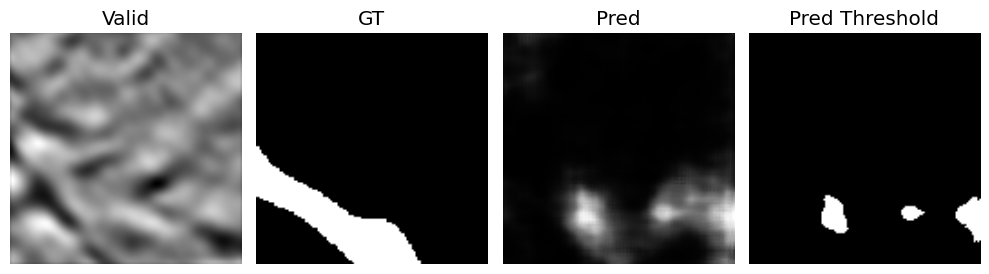

In [82]:
# Sample the validation dataset
ima = random.randint(0, y_valid.shape[0]-1)
print("Image {0}".format(ima))
fig, (ax1, ax2, ax3, ax4) = plt.subplots(1, 4, figsize = (10, 15))
ax1.imshow(valid[ima,0,:,:], cmap = 'gray', interpolation = 'bilinear')
ax1.set_title('Valid'), ax1.axis('off')
ax2.imshow(gt_valid[ima,:,:], cmap = 'gray', interpolation = 'bilinear')
ax2.set_title('GT'), ax2.axis('off')
ax3.imshow(all_pred[ima,:,:], cmap = 'gray', interpolation = 'bilinear')
ax3.set_title('Pred'), ax3.axis('off')
ax4.imshow(pred_th[ima,:,:], cmap = 'gray', interpolation = 'bilinear')
ax4.set_title('Pred Threshold'), ax4.axis('off')
fig.tight_layout()

accuracy = (pred_th[ima,:,:] == gt_valid[ima,:,:]).sum()/gt_valid.shape[1]/gt_valid.shape[2]
print("Accuracy on this image {0:1.3f}".format(accuracy))

TP = ((pred_th[ima,:,:]+gt_valid[ima,:,:])==2).sum()
P  = (pred_th[ima,:,:]).sum()
T  = (gt_valid[ima,:,:]).sum()
precision = TP/(P+1e-6)
recall    = TP/(T+1e-6)
F1        = 2*precision*recall/(precision+recall+1e-6)
if T>0:
  print("Precision: {0:1.3f}, Recall: {1:1.3f}, F1 score: {2:1.3f}".format(precision,recall,F1))

In [83]:
# Run Tensorboard
%load_ext tensorboard
%tensorboard --logdir 'logs'

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


Reusing TensorBoard on port 6006 (pid 9394), started 1:15:55 ago. (Use '!kill 9394' to kill it.)

<IPython.core.display.Javascript object>

<font color='red'>Conclusions: Metrics for the improved model -> Validation Accuracy 0.951, Precision: 0.926, Recall: 0.874, F1 score: 0.899

<font color='red'>We can see how the proposed improvement results in an increase in almost all metrics compared to the two previous models. Accuracy increases to 95.1%, and the F1-score reaches 89.9%. This indicates that the new model performs better than the previous ones. However, in specific cases such as the one we visualized (image 262), it is not perfect and does not achieve good precision or recall. We obtained the following metrics: Accuracy on this image 0.871, Precision: 0.326, Recall: 0.085, F1 score: 0.135.